# Afriat

In [1]:
import warnings
import os
import sys
import gc
import warnings

In [2]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [3]:
torch.cuda.is_available()

False

In [4]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [5]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [6]:
asdp_1 = adata.X.sum()

In [7]:
ratio_true=0.91

from tardis._utils.functions import create_random_mask
mask = create_random_mask(adata.shape[1], ratio_true=ratio_true, seed=2024)
adata.X[:, mask] = 0.0

In [8]:
asdp_2 = adata.X.sum()

In [9]:
mask.sum()/adata.shape[1],  1-asdp_2/asdp_1

(0.9102, 0.9030218869447708)

In [10]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [11]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [12]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_ablation_{ratio_true}"
)

vae.save(
    dir_path,
    overwrite=True,
)

W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: ib04sagj
Name: star-senate-105
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/ib04sagj
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155910-ib04sagj/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2552,3355,9336
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2552,2538,1692,3476,1647,3338
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4499,10744
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 653,754,2403
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 653,664,416,814,402,861
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1085,2725
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:13<2:14:43, 13.49s/it]

Epoch 1/600:   0%|          | 1/600 [00:13<2:14:43, 13.49s/it, v_num=gj_1, total_loss_train=569, kl_local_train=46.7]

Epoch 2/600:   0%|          | 1/600 [00:13<2:14:43, 13.49s/it, v_num=gj_1, total_loss_train=569, kl_local_train=46.7]

Epoch 2/600:   0%|          | 2/600 [00:25<2:07:34, 12.80s/it, v_num=gj_1, total_loss_train=569, kl_local_train=46.7]

Epoch 2/600:   0%|          | 2/600 [00:25<2:07:34, 12.80s/it, v_num=gj_1, total_loss_train=331, kl_local_train=74.6]

Epoch 3/600:   0%|          | 2/600 [00:25<2:07:34, 12.80s/it, v_num=gj_1, total_loss_train=331, kl_local_train=74.6]

Epoch 3/600:   0%|          | 3/600 [00:38<2:04:39, 12.53s/it, v_num=gj_1, total_loss_train=331, kl_local_train=74.6]

Epoch 3/600:   0%|          | 3/600 [00:38<2:04:39, 12.53s/it, v_num=gj_1, total_loss_train=311, kl_local_train=76]  

Epoch 4/600:   0%|          | 3/600 [00:38<2:04:39, 12.53s/it, v_num=gj_1, total_loss_train=311, kl_local_train=76]

Epoch 4/600:   1%|          | 4/600 [00:50<2:02:57, 12.38s/it, v_num=gj_1, total_loss_train=311, kl_local_train=76]

Epoch 4/600:   1%|          | 4/600 [00:50<2:02:57, 12.38s/it, v_num=gj_1, total_loss_train=306, kl_local_train=70.7]

Epoch 5/600:   1%|          | 4/600 [00:50<2:02:57, 12.38s/it, v_num=gj_1, total_loss_train=306, kl_local_train=70.7]

Epoch 5/600:   1%|          | 5/600 [01:02<2:02:42, 12.37s/it, v_num=gj_1, total_loss_train=306, kl_local_train=70.7]

Epoch 5/600:   1%|          | 5/600 [01:02<2:02:42, 12.37s/it, v_num=gj_1, total_loss_train=303, kl_local_train=61.4]

Epoch 6/600:   1%|          | 5/600 [01:03<2:02:42, 12.37s/it, v_num=gj_1, total_loss_train=303, kl_local_train=61.4]

Epoch 6/600:   1%|          | 6/600 [01:15<2:04:32, 12.58s/it, v_num=gj_1, total_loss_train=303, kl_local_train=61.4]

Epoch 6/600:   1%|          | 6/600 [01:15<2:04:32, 12.58s/it, v_num=gj_1, total_loss_train=302, kl_local_train=49.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00709, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 6/600 [01:15<2:04:32, 12.58s/it, v_num=gj_1, total_loss_train=302, kl_local_train=49.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00709, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:27<2:01:43, 12.32s/it, v_num=gj_1, total_loss_train=302, kl_local_train=49.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00709, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:27<2:01:43, 12.32s/it, v_num=gj_1, total_loss_train=301, kl_local_train=36.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00709, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|          | 7/600 [01:27<2:01:43, 12.32s/it, v_num=gj_1, total_loss_train=301, kl_local_train=36.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00709, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [01:39<1:59:45, 12.14s/it, v_num=gj_1, total_loss_train=301, kl_local_train=36.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00709, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [01:39<1:59:45, 12.14s/it, v_num=gj_1, total_loss_train=309, kl_local_train=22.6, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00709, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 9/600:   1%|▏         | 8/600 [01:39<1:59:45, 12.14s/it, v_num=gj_1, total_loss_train=309, kl_local_train=22.6, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00709, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [01:50<1:58:13, 12.00s/it, v_num=gj_1, total_loss_train=309, kl_local_train=22.6, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00709, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [01:50<1:58:13, 12.00s/it, v_num=gj_1, total_loss_train=316, kl_local_train=15.9, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00709, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 9/600 [01:50<1:58:13, 12.00s/it, v_num=gj_1, total_loss_train=316, kl_local_train=15.9, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00709, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [02:02<1:57:22, 11.94s/it, v_num=gj_1, total_loss_train=316, kl_local_train=15.9, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00709, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [02:02<1:57:22, 11.94s/it, v_num=gj_1, total_loss_train=323, kl_local_train=12.4, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00709, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 10/600 [02:03<1:57:22, 11.94s/it, v_num=gj_1, total_loss_train=323, kl_local_train=12.4, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00709, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:15<2:00:23, 12.26s/it, v_num=gj_1, total_loss_train=323, kl_local_train=12.4, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00709, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:15<2:00:23, 12.26s/it, v_num=gj_1, total_loss_train=331, kl_local_train=11.9, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 12/600:   2%|▏         | 11/600 [02:15<2:00:23, 12.26s/it, v_num=gj_1, total_loss_train=331, kl_local_train=11.9, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 12/600:   2%|▏         | 12/600 [02:27<1:58:35, 12.10s/it, v_num=gj_1, total_loss_train=331, kl_local_train=11.9, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 12/600:   2%|▏         | 12/600 [02:27<1:58:35, 12.10s/it, v_num=gj_1, total_loss_train=338, kl_local_train=12.1, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 13/600:   2%|▏         | 12/600 [02:27<1:58:35, 12.10s/it, v_num=gj_1, total_loss_train=338, kl_local_train=12.1, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 13/600:   2%|▏         | 13/600 [02:38<1:57:08, 11.97s/it, v_num=gj_1, total_loss_train=338, kl_local_train=12.1, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 13/600:   2%|▏         | 13/600 [02:38<1:57:08, 11.97s/it, v_num=gj_1, total_loss_train=346, kl_local_train=26.8, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 14/600:   2%|▏         | 13/600 [02:38<1:57:08, 11.97s/it, v_num=gj_1, total_loss_train=346, kl_local_train=26.8, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 14/600:   2%|▏         | 14/600 [02:50<1:56:15, 11.90s/it, v_num=gj_1, total_loss_train=346, kl_local_train=26.8, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 14/600:   2%|▏         | 14/600 [02:50<1:56:15, 11.90s/it, v_num=gj_1, total_loss_train=348, kl_local_train=83.3, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 15/600:   2%|▏         | 14/600 [02:50<1:56:15, 11.90s/it, v_num=gj_1, total_loss_train=348, kl_local_train=83.3, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 15/600:   2%|▎         | 15/600 [03:02<1:55:59, 11.90s/it, v_num=gj_1, total_loss_train=348, kl_local_train=83.3, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 15/600:   2%|▎         | 15/600 [03:02<1:55:59, 11.90s/it, v_num=gj_1, total_loss_train=351, kl_local_train=85.4, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 16/600:   2%|▎         | 15/600 [03:03<1:55:59, 11.90s/it, v_num=gj_1, total_loss_train=351, kl_local_train=85.4, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 16/600:   3%|▎         | 16/600 [03:15<1:59:07, 12.24s/it, v_num=gj_1, total_loss_train=351, kl_local_train=85.4, metric_mi|status_control_train=0.0189, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 16/600:   3%|▎         | 16/600 [03:15<1:59:07, 12.24s/it, v_num=gj_1, total_loss_train=351, kl_local_train=115, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0412]  

Epoch 17/600:   3%|▎         | 16/600 [03:15<1:59:07, 12.24s/it, v_num=gj_1, total_loss_train=351, kl_local_train=115, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0412]

Epoch 17/600:   3%|▎         | 17/600 [03:27<1:57:28, 12.09s/it, v_num=gj_1, total_loss_train=351, kl_local_train=115, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0412]

Epoch 17/600:   3%|▎         | 17/600 [03:27<1:57:28, 12.09s/it, v_num=gj_1, total_loss_train=352, kl_local_train=109, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0412]

Epoch 18/600:   3%|▎         | 17/600 [03:27<1:57:28, 12.09s/it, v_num=gj_1, total_loss_train=352, kl_local_train=109, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0412]

Epoch 18/600:   3%|▎         | 18/600 [03:39<1:56:18, 11.99s/it, v_num=gj_1, total_loss_train=352, kl_local_train=109, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0412]

Epoch 18/600:   3%|▎         | 18/600 [03:39<1:56:18, 11.99s/it, v_num=gj_1, total_loss_train=356, kl_local_train=103, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0412]

Epoch 19/600:   3%|▎         | 18/600 [03:39<1:56:18, 11.99s/it, v_num=gj_1, total_loss_train=356, kl_local_train=103, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0412]

Epoch 19/600:   3%|▎         | 19/600 [03:50<1:55:17, 11.91s/it, v_num=gj_1, total_loss_train=356, kl_local_train=103, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0412]

Epoch 19/600:   3%|▎         | 19/600 [03:50<1:55:17, 11.91s/it, v_num=gj_1, total_loss_train=360, kl_local_train=102, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0412]

Epoch 20/600:   3%|▎         | 19/600 [03:50<1:55:17, 11.91s/it, v_num=gj_1, total_loss_train=360, kl_local_train=102, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0412]

Epoch 20/600:   3%|▎         | 20/600 [04:02<1:55:05, 11.91s/it, v_num=gj_1, total_loss_train=360, kl_local_train=102, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0412]

Epoch 20/600:   3%|▎         | 20/600 [04:02<1:55:05, 11.91s/it, v_num=gj_1, total_loss_train=363, kl_local_train=101, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0412]

Epoch 21/600:   3%|▎         | 20/600 [04:03<1:55:05, 11.91s/it, v_num=gj_1, total_loss_train=363, kl_local_train=101, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0412]

Epoch 21/600:   4%|▎         | 21/600 [04:15<1:58:15, 12.25s/it, v_num=gj_1, total_loss_train=363, kl_local_train=101, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0412]

Epoch 21/600:   4%|▎         | 21/600 [04:15<1:58:15, 12.25s/it, v_num=gj_1, total_loss_train=365, kl_local_train=114, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.0911]  

Epoch 22/600:   4%|▎         | 21/600 [04:15<1:58:15, 12.25s/it, v_num=gj_1, total_loss_train=365, kl_local_train=114, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.0911]

Epoch 22/600:   4%|▎         | 22/600 [04:27<1:56:45, 12.12s/it, v_num=gj_1, total_loss_train=365, kl_local_train=114, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.0911]

Epoch 22/600:   4%|▎         | 22/600 [04:27<1:56:45, 12.12s/it, v_num=gj_1, total_loss_train=367, kl_local_train=128, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.0911]

Epoch 23/600:   4%|▎         | 22/600 [04:27<1:56:45, 12.12s/it, v_num=gj_1, total_loss_train=367, kl_local_train=128, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.0911]

Epoch 23/600:   4%|▍         | 23/600 [04:39<1:55:35, 12.02s/it, v_num=gj_1, total_loss_train=367, kl_local_train=128, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.0911]

Epoch 23/600:   4%|▍         | 23/600 [04:39<1:55:35, 12.02s/it, v_num=gj_1, total_loss_train=370, kl_local_train=136, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.0911]

Epoch 24/600:   4%|▍         | 23/600 [04:39<1:55:35, 12.02s/it, v_num=gj_1, total_loss_train=370, kl_local_train=136, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.0911]

Epoch 24/600:   4%|▍         | 24/600 [04:51<1:54:44, 11.95s/it, v_num=gj_1, total_loss_train=370, kl_local_train=136, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.0911]

Epoch 24/600:   4%|▍         | 24/600 [04:51<1:54:44, 11.95s/it, v_num=gj_1, total_loss_train=373, kl_local_train=144, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.0911]

Epoch 25/600:   4%|▍         | 24/600 [04:51<1:54:44, 11.95s/it, v_num=gj_1, total_loss_train=373, kl_local_train=144, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.0911]

Epoch 25/600:   4%|▍         | 25/600 [05:03<1:54:12, 11.92s/it, v_num=gj_1, total_loss_train=373, kl_local_train=144, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.0911]

Epoch 25/600:   4%|▍         | 25/600 [05:03<1:54:12, 11.92s/it, v_num=gj_1, total_loss_train=377, kl_local_train=147, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.0911]

Epoch 26/600:   4%|▍         | 25/600 [05:04<1:54:12, 11.92s/it, v_num=gj_1, total_loss_train=377, kl_local_train=147, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.0911]

Epoch 26/600:   4%|▍         | 26/600 [05:16<1:57:22, 12.27s/it, v_num=gj_1, total_loss_train=377, kl_local_train=147, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.0911]

Epoch 26/600:   4%|▍         | 26/600 [05:16<1:57:22, 12.27s/it, v_num=gj_1, total_loss_train=380, kl_local_train=148, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138] 

Epoch 27/600:   4%|▍         | 26/600 [05:16<1:57:22, 12.27s/it, v_num=gj_1, total_loss_train=380, kl_local_train=148, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 27/600:   4%|▍         | 27/600 [05:27<1:55:48, 12.13s/it, v_num=gj_1, total_loss_train=380, kl_local_train=148, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 27/600:   4%|▍         | 27/600 [05:27<1:55:48, 12.13s/it, v_num=gj_1, total_loss_train=384, kl_local_train=152, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 28/600:   4%|▍         | 27/600 [05:27<1:55:48, 12.13s/it, v_num=gj_1, total_loss_train=384, kl_local_train=152, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 28/600:   5%|▍         | 28/600 [05:39<1:54:37, 12.02s/it, v_num=gj_1, total_loss_train=384, kl_local_train=152, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 28/600:   5%|▍         | 28/600 [05:39<1:54:37, 12.02s/it, v_num=gj_1, total_loss_train=388, kl_local_train=154, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 29/600:   5%|▍         | 28/600 [05:39<1:54:37, 12.02s/it, v_num=gj_1, total_loss_train=388, kl_local_train=154, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 29/600:   5%|▍         | 29/600 [05:51<1:53:46, 11.96s/it, v_num=gj_1, total_loss_train=388, kl_local_train=154, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 29/600:   5%|▍         | 29/600 [05:51<1:53:46, 11.96s/it, v_num=gj_1, total_loss_train=392, kl_local_train=156, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 30/600:   5%|▍         | 29/600 [05:51<1:53:46, 11.96s/it, v_num=gj_1, total_loss_train=392, kl_local_train=156, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 30/600:   5%|▌         | 30/600 [06:03<1:53:23, 11.94s/it, v_num=gj_1, total_loss_train=392, kl_local_train=156, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 30/600:   5%|▌         | 30/600 [06:03<1:53:23, 11.94s/it, v_num=gj_1, total_loss_train=395, kl_local_train=157, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 31/600:   5%|▌         | 30/600 [06:04<1:53:23, 11.94s/it, v_num=gj_1, total_loss_train=395, kl_local_train=157, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 31/600:   5%|▌         | 31/600 [06:16<1:56:28, 12.28s/it, v_num=gj_1, total_loss_train=395, kl_local_train=157, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 31/600:   5%|▌         | 31/600 [06:16<1:56:28, 12.28s/it, v_num=gj_1, total_loss_train=400, kl_local_train=157, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 32/600:   5%|▌         | 31/600 [06:16<1:56:28, 12.28s/it, v_num=gj_1, total_loss_train=400, kl_local_train=157, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 32/600:   5%|▌         | 32/600 [06:28<1:54:58, 12.14s/it, v_num=gj_1, total_loss_train=400, kl_local_train=157, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 32/600:   5%|▌         | 32/600 [06:28<1:54:58, 12.14s/it, v_num=gj_1, total_loss_train=403, kl_local_train=157, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 33/600:   5%|▌         | 32/600 [06:28<1:54:58, 12.14s/it, v_num=gj_1, total_loss_train=403, kl_local_train=157, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 33/600:   6%|▌         | 33/600 [06:40<1:53:49, 12.05s/it, v_num=gj_1, total_loss_train=403, kl_local_train=157, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 33/600:   6%|▌         | 33/600 [06:40<1:53:49, 12.05s/it, v_num=gj_1, total_loss_train=407, kl_local_train=157, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 34/600:   6%|▌         | 33/600 [06:40<1:53:49, 12.05s/it, v_num=gj_1, total_loss_train=407, kl_local_train=157, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 34/600:   6%|▌         | 34/600 [06:51<1:52:54, 11.97s/it, v_num=gj_1, total_loss_train=407, kl_local_train=157, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 34/600:   6%|▌         | 34/600 [06:51<1:52:54, 11.97s/it, v_num=gj_1, total_loss_train=411, kl_local_train=158, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 35/600:   6%|▌         | 34/600 [06:51<1:52:54, 11.97s/it, v_num=gj_1, total_loss_train=411, kl_local_train=158, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 35/600:   6%|▌         | 35/600 [07:03<1:52:20, 11.93s/it, v_num=gj_1, total_loss_train=411, kl_local_train=158, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 35/600:   6%|▌         | 35/600 [07:03<1:52:20, 11.93s/it, v_num=gj_1, total_loss_train=415, kl_local_train=158, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 36/600:   6%|▌         | 35/600 [07:04<1:52:20, 11.93s/it, v_num=gj_1, total_loss_train=415, kl_local_train=158, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 36/600:   6%|▌         | 36/600 [07:16<1:55:16, 12.26s/it, v_num=gj_1, total_loss_train=415, kl_local_train=158, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 36/600:   6%|▌         | 36/600 [07:16<1:55:16, 12.26s/it, v_num=gj_1, total_loss_train=419, kl_local_train=159, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 37/600:   6%|▌         | 36/600 [07:16<1:55:16, 12.26s/it, v_num=gj_1, total_loss_train=419, kl_local_train=159, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 37/600:   6%|▌         | 37/600 [07:28<1:53:48, 12.13s/it, v_num=gj_1, total_loss_train=419, kl_local_train=159, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 37/600:   6%|▌         | 37/600 [07:28<1:53:48, 12.13s/it, v_num=gj_1, total_loss_train=423, kl_local_train=161, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 38/600:   6%|▌         | 37/600 [07:28<1:53:48, 12.13s/it, v_num=gj_1, total_loss_train=423, kl_local_train=161, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 38/600:   6%|▋         | 38/600 [07:40<1:52:46, 12.04s/it, v_num=gj_1, total_loss_train=423, kl_local_train=161, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 38/600:   6%|▋         | 38/600 [07:40<1:52:46, 12.04s/it, v_num=gj_1, total_loss_train=427, kl_local_train=164, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 39/600:   6%|▋         | 38/600 [07:40<1:52:46, 12.04s/it, v_num=gj_1, total_loss_train=427, kl_local_train=164, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 39/600:   6%|▋         | 39/600 [07:52<1:51:57, 11.97s/it, v_num=gj_1, total_loss_train=427, kl_local_train=164, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 39/600:   6%|▋         | 39/600 [07:52<1:51:57, 11.97s/it, v_num=gj_1, total_loss_train=431, kl_local_train=160, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 40/600:   6%|▋         | 39/600 [07:52<1:51:57, 11.97s/it, v_num=gj_1, total_loss_train=431, kl_local_train=160, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 40/600:   7%|▋         | 40/600 [08:04<1:51:21, 11.93s/it, v_num=gj_1, total_loss_train=431, kl_local_train=160, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 40/600:   7%|▋         | 40/600 [08:04<1:51:21, 11.93s/it, v_num=gj_1, total_loss_train=435, kl_local_train=163, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 41/600:   7%|▋         | 40/600 [08:05<1:51:21, 11.93s/it, v_num=gj_1, total_loss_train=435, kl_local_train=163, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 41/600:   7%|▋         | 41/600 [08:17<1:54:14, 12.26s/it, v_num=gj_1, total_loss_train=435, kl_local_train=163, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 41/600:   7%|▋         | 41/600 [08:17<1:54:14, 12.26s/it, v_num=gj_1, total_loss_train=439, kl_local_train=162, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.147] 

Epoch 42/600:   7%|▋         | 41/600 [08:17<1:54:14, 12.26s/it, v_num=gj_1, total_loss_train=439, kl_local_train=162, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.147]

Epoch 42/600:   7%|▋         | 42/600 [08:28<1:52:50, 12.13s/it, v_num=gj_1, total_loss_train=439, kl_local_train=162, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.147]

Epoch 42/600:   7%|▋         | 42/600 [08:28<1:52:50, 12.13s/it, v_num=gj_1, total_loss_train=443, kl_local_train=163, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.147]

Epoch 43/600:   7%|▋         | 42/600 [08:28<1:52:50, 12.13s/it, v_num=gj_1, total_loss_train=443, kl_local_train=163, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.147]

Epoch 43/600:   7%|▋         | 43/600 [08:40<1:51:48, 12.04s/it, v_num=gj_1, total_loss_train=443, kl_local_train=163, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.147]

Epoch 43/600:   7%|▋         | 43/600 [08:40<1:51:48, 12.04s/it, v_num=gj_1, total_loss_train=447, kl_local_train=160, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.147]

Epoch 44/600:   7%|▋         | 43/600 [08:40<1:51:48, 12.04s/it, v_num=gj_1, total_loss_train=447, kl_local_train=160, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.147]

Epoch 44/600:   7%|▋         | 44/600 [08:52<1:51:03, 11.98s/it, v_num=gj_1, total_loss_train=447, kl_local_train=160, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.147]

Epoch 44/600:   7%|▋         | 44/600 [08:52<1:51:03, 11.98s/it, v_num=gj_1, total_loss_train=451, kl_local_train=163, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.147]

Epoch 45/600:   7%|▋         | 44/600 [08:52<1:51:03, 11.98s/it, v_num=gj_1, total_loss_train=451, kl_local_train=163, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.147]

Epoch 45/600:   8%|▊         | 45/600 [09:04<1:50:30, 11.95s/it, v_num=gj_1, total_loss_train=451, kl_local_train=163, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.147]

Epoch 45/600:   8%|▊         | 45/600 [09:04<1:50:30, 11.95s/it, v_num=gj_1, total_loss_train=455, kl_local_train=165, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.147]

Epoch 46/600:   8%|▊         | 45/600 [09:05<1:50:30, 11.95s/it, v_num=gj_1, total_loss_train=455, kl_local_train=165, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.147]

Epoch 46/600:   8%|▊         | 46/600 [09:17<1:53:32, 12.30s/it, v_num=gj_1, total_loss_train=455, kl_local_train=165, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.147]

Epoch 46/600:   8%|▊         | 46/600 [09:17<1:53:32, 12.30s/it, v_num=gj_1, total_loss_train=459, kl_local_train=167, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 47/600:   8%|▊         | 46/600 [09:17<1:53:32, 12.30s/it, v_num=gj_1, total_loss_train=459, kl_local_train=167, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 47/600:   8%|▊         | 47/600 [09:29<1:52:02, 12.16s/it, v_num=gj_1, total_loss_train=459, kl_local_train=167, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 47/600:   8%|▊         | 47/600 [09:29<1:52:02, 12.16s/it, v_num=gj_1, total_loss_train=463, kl_local_train=168, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 48/600:   8%|▊         | 47/600 [09:29<1:52:02, 12.16s/it, v_num=gj_1, total_loss_train=463, kl_local_train=168, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 48/600:   8%|▊         | 48/600 [09:41<1:51:22, 12.11s/it, v_num=gj_1, total_loss_train=463, kl_local_train=168, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 48/600:   8%|▊         | 48/600 [09:41<1:51:22, 12.11s/it, v_num=gj_1, total_loss_train=467, kl_local_train=167, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 49/600:   8%|▊         | 48/600 [09:41<1:51:22, 12.11s/it, v_num=gj_1, total_loss_train=467, kl_local_train=167, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 49/600:   8%|▊         | 49/600 [09:53<1:50:44, 12.06s/it, v_num=gj_1, total_loss_train=467, kl_local_train=167, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 49/600:   8%|▊         | 49/600 [09:53<1:50:44, 12.06s/it, v_num=gj_1, total_loss_train=471, kl_local_train=165, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 50/600:   8%|▊         | 49/600 [09:53<1:50:44, 12.06s/it, v_num=gj_1, total_loss_train=471, kl_local_train=165, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 50/600:   8%|▊         | 50/600 [10:05<1:49:55, 11.99s/it, v_num=gj_1, total_loss_train=471, kl_local_train=165, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 50/600:   8%|▊         | 50/600 [10:05<1:49:55, 11.99s/it, v_num=gj_1, total_loss_train=475, kl_local_train=167, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 51/600:   8%|▊         | 50/600 [10:06<1:49:55, 11.99s/it, v_num=gj_1, total_loss_train=475, kl_local_train=167, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 51/600:   8%|▊         | 51/600 [10:18<1:52:51, 12.33s/it, v_num=gj_1, total_loss_train=475, kl_local_train=167, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 51/600:   8%|▊         | 51/600 [10:18<1:52:51, 12.33s/it, v_num=gj_1, total_loss_train=475, kl_local_train=165, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.147] 

Epoch 52/600:   8%|▊         | 51/600 [10:18<1:52:51, 12.33s/it, v_num=gj_1, total_loss_train=475, kl_local_train=165, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.147]

Epoch 52/600:   9%|▊         | 52/600 [10:30<1:51:16, 12.18s/it, v_num=gj_1, total_loss_train=475, kl_local_train=165, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.147]

Epoch 52/600:   9%|▊         | 52/600 [10:30<1:51:16, 12.18s/it, v_num=gj_1, total_loss_train=475, kl_local_train=164, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.147]

Epoch 53/600:   9%|▊         | 52/600 [10:30<1:51:16, 12.18s/it, v_num=gj_1, total_loss_train=475, kl_local_train=164, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.147]

Epoch 53/600:   9%|▉         | 53/600 [10:42<1:50:13, 12.09s/it, v_num=gj_1, total_loss_train=475, kl_local_train=164, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.147]

Epoch 53/600:   9%|▉         | 53/600 [10:42<1:50:13, 12.09s/it, v_num=gj_1, total_loss_train=475, kl_local_train=161, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.147]

Epoch 54/600:   9%|▉         | 53/600 [10:42<1:50:13, 12.09s/it, v_num=gj_1, total_loss_train=475, kl_local_train=161, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.147]

Epoch 54/600:   9%|▉         | 54/600 [10:53<1:49:21, 12.02s/it, v_num=gj_1, total_loss_train=475, kl_local_train=161, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.147]

Epoch 54/600:   9%|▉         | 54/600 [10:53<1:49:21, 12.02s/it, v_num=gj_1, total_loss_train=475, kl_local_train=159, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.147]

Epoch 55/600:   9%|▉         | 54/600 [10:53<1:49:21, 12.02s/it, v_num=gj_1, total_loss_train=475, kl_local_train=159, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.147]

Epoch 55/600:   9%|▉         | 55/600 [11:05<1:48:49, 11.98s/it, v_num=gj_1, total_loss_train=475, kl_local_train=159, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.147]

Epoch 55/600:   9%|▉         | 55/600 [11:05<1:48:49, 11.98s/it, v_num=gj_1, total_loss_train=474, kl_local_train=157, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.147]

Epoch 56/600:   9%|▉         | 55/600 [11:07<1:48:49, 11.98s/it, v_num=gj_1, total_loss_train=474, kl_local_train=157, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.147]

Epoch 56/600:   9%|▉         | 56/600 [11:18<1:51:39, 12.32s/it, v_num=gj_1, total_loss_train=474, kl_local_train=157, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.147]

Epoch 56/600:   9%|▉         | 56/600 [11:18<1:51:39, 12.32s/it, v_num=gj_1, total_loss_train=474, kl_local_train=157, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 57/600:   9%|▉         | 56/600 [11:18<1:51:39, 12.32s/it, v_num=gj_1, total_loss_train=474, kl_local_train=157, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 57/600:  10%|▉         | 57/600 [11:30<1:50:07, 12.17s/it, v_num=gj_1, total_loss_train=474, kl_local_train=157, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 57/600:  10%|▉         | 57/600 [11:30<1:50:07, 12.17s/it, v_num=gj_1, total_loss_train=474, kl_local_train=155, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 58/600:  10%|▉         | 57/600 [11:30<1:50:07, 12.17s/it, v_num=gj_1, total_loss_train=474, kl_local_train=155, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 58/600:  10%|▉         | 58/600 [11:42<1:49:01, 12.07s/it, v_num=gj_1, total_loss_train=474, kl_local_train=155, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 58/600:  10%|▉         | 58/600 [11:42<1:49:01, 12.07s/it, v_num=gj_1, total_loss_train=474, kl_local_train=154, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 59/600:  10%|▉         | 58/600 [11:42<1:49:01, 12.07s/it, v_num=gj_1, total_loss_train=474, kl_local_train=154, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 59/600:  10%|▉         | 59/600 [11:54<1:48:12, 12.00s/it, v_num=gj_1, total_loss_train=474, kl_local_train=154, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 59/600:  10%|▉         | 59/600 [11:54<1:48:12, 12.00s/it, v_num=gj_1, total_loss_train=474, kl_local_train=151, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 60/600:  10%|▉         | 59/600 [11:54<1:48:12, 12.00s/it, v_num=gj_1, total_loss_train=474, kl_local_train=151, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 60/600:  10%|█         | 60/600 [12:06<1:47:40, 11.96s/it, v_num=gj_1, total_loss_train=474, kl_local_train=151, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 60/600:  10%|█         | 60/600 [12:06<1:47:40, 11.96s/it, v_num=gj_1, total_loss_train=474, kl_local_train=150, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 61/600:  10%|█         | 60/600 [12:07<1:47:40, 11.96s/it, v_num=gj_1, total_loss_train=474, kl_local_train=150, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 61/600:  10%|█         | 61/600 [12:19<1:50:30, 12.30s/it, v_num=gj_1, total_loss_train=474, kl_local_train=150, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 61/600:  10%|█         | 61/600 [12:19<1:50:30, 12.30s/it, v_num=gj_1, total_loss_train=474, kl_local_train=145, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 62/600:  10%|█         | 61/600 [12:19<1:50:30, 12.30s/it, v_num=gj_1, total_loss_train=474, kl_local_train=145, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 62/600:  10%|█         | 62/600 [12:31<1:49:02, 12.16s/it, v_num=gj_1, total_loss_train=474, kl_local_train=145, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 62/600:  10%|█         | 62/600 [12:31<1:49:02, 12.16s/it, v_num=gj_1, total_loss_train=474, kl_local_train=147, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 63/600:  10%|█         | 62/600 [12:31<1:49:02, 12.16s/it, v_num=gj_1, total_loss_train=474, kl_local_train=147, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 63/600:  10%|█         | 63/600 [12:43<1:48:00, 12.07s/it, v_num=gj_1, total_loss_train=474, kl_local_train=147, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 63/600:  10%|█         | 63/600 [12:43<1:48:00, 12.07s/it, v_num=gj_1, total_loss_train=474, kl_local_train=145, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 64/600:  10%|█         | 63/600 [12:43<1:48:00, 12.07s/it, v_num=gj_1, total_loss_train=474, kl_local_train=145, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 64/600:  11%|█         | 64/600 [12:54<1:47:12, 12.00s/it, v_num=gj_1, total_loss_train=474, kl_local_train=145, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 64/600:  11%|█         | 64/600 [12:54<1:47:12, 12.00s/it, v_num=gj_1, total_loss_train=474, kl_local_train=142, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 65/600:  11%|█         | 64/600 [12:54<1:47:12, 12.00s/it, v_num=gj_1, total_loss_train=474, kl_local_train=142, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 65/600:  11%|█         | 65/600 [13:06<1:46:43, 11.97s/it, v_num=gj_1, total_loss_train=474, kl_local_train=142, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 65/600:  11%|█         | 65/600 [13:06<1:46:43, 11.97s/it, v_num=gj_1, total_loss_train=474, kl_local_train=140, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 66/600:  11%|█         | 65/600 [13:08<1:46:43, 11.97s/it, v_num=gj_1, total_loss_train=474, kl_local_train=140, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 66/600:  11%|█         | 66/600 [13:19<1:49:32, 12.31s/it, v_num=gj_1, total_loss_train=474, kl_local_train=140, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 66/600:  11%|█         | 66/600 [13:19<1:49:32, 12.31s/it, v_num=gj_1, total_loss_train=474, kl_local_train=138, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147] 

Epoch 67/600:  11%|█         | 66/600 [13:19<1:49:32, 12.31s/it, v_num=gj_1, total_loss_train=474, kl_local_train=138, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 67/600:  11%|█         | 67/600 [13:31<1:48:05, 12.17s/it, v_num=gj_1, total_loss_train=474, kl_local_train=138, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 67/600:  11%|█         | 67/600 [13:31<1:48:05, 12.17s/it, v_num=gj_1, total_loss_train=474, kl_local_train=136, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 68/600:  11%|█         | 67/600 [13:31<1:48:05, 12.17s/it, v_num=gj_1, total_loss_train=474, kl_local_train=136, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 68/600:  11%|█▏        | 68/600 [13:43<1:46:55, 12.06s/it, v_num=gj_1, total_loss_train=474, kl_local_train=136, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 68/600:  11%|█▏        | 68/600 [13:43<1:46:55, 12.06s/it, v_num=gj_1, total_loss_train=474, kl_local_train=136, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 69/600:  11%|█▏        | 68/600 [13:43<1:46:55, 12.06s/it, v_num=gj_1, total_loss_train=474, kl_local_train=136, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 69/600:  12%|█▏        | 69/600 [13:55<1:46:12, 12.00s/it, v_num=gj_1, total_loss_train=474, kl_local_train=136, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 69/600:  12%|█▏        | 69/600 [13:55<1:46:12, 12.00s/it, v_num=gj_1, total_loss_train=474, kl_local_train=137, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 70/600:  12%|█▏        | 69/600 [13:55<1:46:12, 12.00s/it, v_num=gj_1, total_loss_train=474, kl_local_train=137, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 70/600:  12%|█▏        | 70/600 [14:07<1:45:40, 11.96s/it, v_num=gj_1, total_loss_train=474, kl_local_train=137, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 70/600:  12%|█▏        | 70/600 [14:07<1:45:40, 11.96s/it, v_num=gj_1, total_loss_train=474, kl_local_train=135, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 71/600:  12%|█▏        | 70/600 [14:08<1:45:40, 11.96s/it, v_num=gj_1, total_loss_train=474, kl_local_train=135, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 71/600:  12%|█▏        | 71/600 [14:20<1:48:34, 12.32s/it, v_num=gj_1, total_loss_train=474, kl_local_train=135, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 71/600:  12%|█▏        | 71/600 [14:20<1:48:34, 12.32s/it, v_num=gj_1, total_loss_train=474, kl_local_train=135, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 72/600:  12%|█▏        | 71/600 [14:20<1:48:34, 12.32s/it, v_num=gj_1, total_loss_train=474, kl_local_train=135, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 72/600:  12%|█▏        | 72/600 [14:32<1:47:09, 12.18s/it, v_num=gj_1, total_loss_train=474, kl_local_train=135, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 72/600:  12%|█▏        | 72/600 [14:32<1:47:09, 12.18s/it, v_num=gj_1, total_loss_train=474, kl_local_train=132, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 73/600:  12%|█▏        | 72/600 [14:32<1:47:09, 12.18s/it, v_num=gj_1, total_loss_train=474, kl_local_train=132, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 73/600:  12%|█▏        | 73/600 [14:44<1:46:05, 12.08s/it, v_num=gj_1, total_loss_train=474, kl_local_train=132, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 73/600:  12%|█▏        | 73/600 [14:44<1:46:05, 12.08s/it, v_num=gj_1, total_loss_train=474, kl_local_train=133, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 74/600:  12%|█▏        | 73/600 [14:44<1:46:05, 12.08s/it, v_num=gj_1, total_loss_train=474, kl_local_train=133, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 74/600:  12%|█▏        | 74/600 [14:56<1:45:39, 12.05s/it, v_num=gj_1, total_loss_train=474, kl_local_train=133, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 74/600:  12%|█▏        | 74/600 [14:56<1:45:39, 12.05s/it, v_num=gj_1, total_loss_train=474, kl_local_train=133, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 75/600:  12%|█▏        | 74/600 [14:56<1:45:39, 12.05s/it, v_num=gj_1, total_loss_train=474, kl_local_train=133, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 75/600:  12%|█▎        | 75/600 [15:08<1:45:11, 12.02s/it, v_num=gj_1, total_loss_train=474, kl_local_train=133, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 75/600:  12%|█▎        | 75/600 [15:08<1:45:11, 12.02s/it, v_num=gj_1, total_loss_train=473, kl_local_train=131, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 76/600:  12%|█▎        | 75/600 [15:09<1:45:11, 12.02s/it, v_num=gj_1, total_loss_train=473, kl_local_train=131, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 76/600:  13%|█▎        | 76/600 [15:21<1:47:57, 12.36s/it, v_num=gj_1, total_loss_train=473, kl_local_train=131, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.146]

Epoch 76/600:  13%|█▎        | 76/600 [15:21<1:47:57, 12.36s/it, v_num=gj_1, total_loss_train=474, kl_local_train=128, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 77/600:  13%|█▎        | 76/600 [15:21<1:47:57, 12.36s/it, v_num=gj_1, total_loss_train=474, kl_local_train=128, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 77/600:  13%|█▎        | 77/600 [15:33<1:46:30, 12.22s/it, v_num=gj_1, total_loss_train=474, kl_local_train=128, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 77/600:  13%|█▎        | 77/600 [15:33<1:46:30, 12.22s/it, v_num=gj_1, total_loss_train=474, kl_local_train=128, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 78/600:  13%|█▎        | 77/600 [15:33<1:46:30, 12.22s/it, v_num=gj_1, total_loss_train=474, kl_local_train=128, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 78/600:  13%|█▎        | 78/600 [15:44<1:45:17, 12.10s/it, v_num=gj_1, total_loss_train=474, kl_local_train=128, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 78/600:  13%|█▎        | 78/600 [15:44<1:45:17, 12.10s/it, v_num=gj_1, total_loss_train=474, kl_local_train=128, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 79/600:  13%|█▎        | 78/600 [15:44<1:45:17, 12.10s/it, v_num=gj_1, total_loss_train=474, kl_local_train=128, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 79/600:  13%|█▎        | 79/600 [15:56<1:44:26, 12.03s/it, v_num=gj_1, total_loss_train=474, kl_local_train=128, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 79/600:  13%|█▎        | 79/600 [15:56<1:44:26, 12.03s/it, v_num=gj_1, total_loss_train=474, kl_local_train=127, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 80/600:  13%|█▎        | 79/600 [15:56<1:44:26, 12.03s/it, v_num=gj_1, total_loss_train=474, kl_local_train=127, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 80/600:  13%|█▎        | 80/600 [16:08<1:43:49, 11.98s/it, v_num=gj_1, total_loss_train=474, kl_local_train=127, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 80/600:  13%|█▎        | 80/600 [16:08<1:43:49, 11.98s/it, v_num=gj_1, total_loss_train=474, kl_local_train=127, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 81/600:  13%|█▎        | 80/600 [16:09<1:43:49, 11.98s/it, v_num=gj_1, total_loss_train=474, kl_local_train=127, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 81/600:  14%|█▎        | 81/600 [16:21<1:46:35, 12.32s/it, v_num=gj_1, total_loss_train=474, kl_local_train=127, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 81/600:  14%|█▎        | 81/600 [16:21<1:46:35, 12.32s/it, v_num=gj_1, total_loss_train=474, kl_local_train=126, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 82/600:  14%|█▎        | 81/600 [16:21<1:46:35, 12.32s/it, v_num=gj_1, total_loss_train=474, kl_local_train=126, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 82/600:  14%|█▎        | 82/600 [16:33<1:45:13, 12.19s/it, v_num=gj_1, total_loss_train=474, kl_local_train=126, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 82/600:  14%|█▎        | 82/600 [16:33<1:45:13, 12.19s/it, v_num=gj_1, total_loss_train=474, kl_local_train=124, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 83/600:  14%|█▎        | 82/600 [16:33<1:45:13, 12.19s/it, v_num=gj_1, total_loss_train=474, kl_local_train=124, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 83/600:  14%|█▍        | 83/600 [16:45<1:44:11, 12.09s/it, v_num=gj_1, total_loss_train=474, kl_local_train=124, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 83/600:  14%|█▍        | 83/600 [16:45<1:44:11, 12.09s/it, v_num=gj_1, total_loss_train=474, kl_local_train=124, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 84/600:  14%|█▍        | 83/600 [16:45<1:44:11, 12.09s/it, v_num=gj_1, total_loss_train=474, kl_local_train=124, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 84/600:  14%|█▍        | 84/600 [16:57<1:43:17, 12.01s/it, v_num=gj_1, total_loss_train=474, kl_local_train=124, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 84/600:  14%|█▍        | 84/600 [16:57<1:43:17, 12.01s/it, v_num=gj_1, total_loss_train=474, kl_local_train=124, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 85/600:  14%|█▍        | 84/600 [16:57<1:43:17, 12.01s/it, v_num=gj_1, total_loss_train=474, kl_local_train=124, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 85/600:  14%|█▍        | 85/600 [17:09<1:42:48, 11.98s/it, v_num=gj_1, total_loss_train=474, kl_local_train=124, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 85/600:  14%|█▍        | 85/600 [17:09<1:42:48, 11.98s/it, v_num=gj_1, total_loss_train=474, kl_local_train=123, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 86/600:  14%|█▍        | 85/600 [17:10<1:42:48, 11.98s/it, v_num=gj_1, total_loss_train=474, kl_local_train=123, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 86/600:  14%|█▍        | 86/600 [17:22<1:45:34, 12.32s/it, v_num=gj_1, total_loss_train=474, kl_local_train=123, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 86/600:  14%|█▍        | 86/600 [17:22<1:45:34, 12.32s/it, v_num=gj_1, total_loss_train=474, kl_local_train=123, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 87/600:  14%|█▍        | 86/600 [17:22<1:45:34, 12.32s/it, v_num=gj_1, total_loss_train=474, kl_local_train=123, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 87/600:  14%|█▍        | 87/600 [17:34<1:44:10, 12.18s/it, v_num=gj_1, total_loss_train=474, kl_local_train=123, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 87/600:  14%|█▍        | 87/600 [17:34<1:44:10, 12.18s/it, v_num=gj_1, total_loss_train=474, kl_local_train=122, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 88/600:  14%|█▍        | 87/600 [17:34<1:44:10, 12.18s/it, v_num=gj_1, total_loss_train=474, kl_local_train=122, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 88/600:  15%|█▍        | 88/600 [17:46<1:43:09, 12.09s/it, v_num=gj_1, total_loss_train=474, kl_local_train=122, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 88/600:  15%|█▍        | 88/600 [17:46<1:43:09, 12.09s/it, v_num=gj_1, total_loss_train=474, kl_local_train=121, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 89/600:  15%|█▍        | 88/600 [17:46<1:43:09, 12.09s/it, v_num=gj_1, total_loss_train=474, kl_local_train=121, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 89/600:  15%|█▍        | 89/600 [17:57<1:42:15, 12.01s/it, v_num=gj_1, total_loss_train=474, kl_local_train=121, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 89/600:  15%|█▍        | 89/600 [17:57<1:42:15, 12.01s/it, v_num=gj_1, total_loss_train=474, kl_local_train=121, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 90/600:  15%|█▍        | 89/600 [17:57<1:42:15, 12.01s/it, v_num=gj_1, total_loss_train=474, kl_local_train=121, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 90/600:  15%|█▌        | 90/600 [18:09<1:41:36, 11.95s/it, v_num=gj_1, total_loss_train=474, kl_local_train=121, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 90/600:  15%|█▌        | 90/600 [18:09<1:41:36, 11.95s/it, v_num=gj_1, total_loss_train=473, kl_local_train=120, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 91/600:  15%|█▌        | 90/600 [18:10<1:41:36, 11.95s/it, v_num=gj_1, total_loss_train=473, kl_local_train=120, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 91/600:  15%|█▌        | 91/600 [18:22<1:44:23, 12.30s/it, v_num=gj_1, total_loss_train=473, kl_local_train=120, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 91/600:  15%|█▌        | 91/600 [18:22<1:44:23, 12.30s/it, v_num=gj_1, total_loss_train=474, kl_local_train=119, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 92/600:  15%|█▌        | 91/600 [18:22<1:44:23, 12.30s/it, v_num=gj_1, total_loss_train=474, kl_local_train=119, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 92/600:  15%|█▌        | 92/600 [18:34<1:43:02, 12.17s/it, v_num=gj_1, total_loss_train=474, kl_local_train=119, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 92/600:  15%|█▌        | 92/600 [18:34<1:43:02, 12.17s/it, v_num=gj_1, total_loss_train=474, kl_local_train=119, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 93/600:  15%|█▌        | 92/600 [18:34<1:43:02, 12.17s/it, v_num=gj_1, total_loss_train=474, kl_local_train=119, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 93/600:  16%|█▌        | 93/600 [18:46<1:42:04, 12.08s/it, v_num=gj_1, total_loss_train=474, kl_local_train=119, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 93/600:  16%|█▌        | 93/600 [18:46<1:42:04, 12.08s/it, v_num=gj_1, total_loss_train=474, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 94/600:  16%|█▌        | 93/600 [18:46<1:42:04, 12.08s/it, v_num=gj_1, total_loss_train=474, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 94/600:  16%|█▌        | 94/600 [18:58<1:41:11, 12.00s/it, v_num=gj_1, total_loss_train=474, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 94/600:  16%|█▌        | 94/600 [18:58<1:41:11, 12.00s/it, v_num=gj_1, total_loss_train=474, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 95/600:  16%|█▌        | 94/600 [18:58<1:41:11, 12.00s/it, v_num=gj_1, total_loss_train=474, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 95/600:  16%|█▌        | 95/600 [19:10<1:40:41, 11.96s/it, v_num=gj_1, total_loss_train=474, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 95/600:  16%|█▌        | 95/600 [19:10<1:40:41, 11.96s/it, v_num=gj_1, total_loss_train=474, kl_local_train=116, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 96/600:  16%|█▌        | 95/600 [19:11<1:40:41, 11.96s/it, v_num=gj_1, total_loss_train=474, kl_local_train=116, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 96/600:  16%|█▌        | 96/600 [19:23<1:43:22, 12.31s/it, v_num=gj_1, total_loss_train=474, kl_local_train=116, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 96/600:  16%|█▌        | 96/600 [19:23<1:43:22, 12.31s/it, v_num=gj_1, total_loss_train=474, kl_local_train=117, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14] 

Epoch 97/600:  16%|█▌        | 96/600 [19:23<1:43:22, 12.31s/it, v_num=gj_1, total_loss_train=474, kl_local_train=117, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 97/600:  16%|█▌        | 97/600 [19:35<1:42:03, 12.17s/it, v_num=gj_1, total_loss_train=474, kl_local_train=117, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 97/600:  16%|█▌        | 97/600 [19:35<1:42:03, 12.17s/it, v_num=gj_1, total_loss_train=474, kl_local_train=117, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 98/600:  16%|█▌        | 97/600 [19:35<1:42:03, 12.17s/it, v_num=gj_1, total_loss_train=474, kl_local_train=117, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 98/600:  16%|█▋        | 98/600 [19:47<1:41:09, 12.09s/it, v_num=gj_1, total_loss_train=474, kl_local_train=117, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 98/600:  16%|█▋        | 98/600 [19:47<1:41:09, 12.09s/it, v_num=gj_1, total_loss_train=474, kl_local_train=116, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 99/600:  16%|█▋        | 98/600 [19:47<1:41:09, 12.09s/it, v_num=gj_1, total_loss_train=474, kl_local_train=116, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 99/600:  16%|█▋        | 99/600 [19:59<1:40:37, 12.05s/it, v_num=gj_1, total_loss_train=474, kl_local_train=116, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 99/600:  16%|█▋        | 99/600 [19:59<1:40:37, 12.05s/it, v_num=gj_1, total_loss_train=474, kl_local_train=114, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 100/600:  16%|█▋        | 99/600 [19:59<1:40:37, 12.05s/it, v_num=gj_1, total_loss_train=474, kl_local_train=114, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 100/600:  17%|█▋        | 100/600 [20:11<1:40:16, 12.03s/it, v_num=gj_1, total_loss_train=474, kl_local_train=114, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 100/600:  17%|█▋        | 100/600 [20:11<1:40:16, 12.03s/it, v_num=gj_1, total_loss_train=474, kl_local_train=114, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 101/600:  17%|█▋        | 100/600 [20:12<1:40:16, 12.03s/it, v_num=gj_1, total_loss_train=474, kl_local_train=114, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 101/600:  17%|█▋        | 101/600 [20:24<1:42:44, 12.35s/it, v_num=gj_1, total_loss_train=474, kl_local_train=114, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 101/600:  17%|█▋        | 101/600 [20:24<1:42:44, 12.35s/it, v_num=gj_1, total_loss_train=474, kl_local_train=113, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 102/600:  17%|█▋        | 101/600 [20:24<1:42:44, 12.35s/it, v_num=gj_1, total_loss_train=474, kl_local_train=113, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 102/600:  17%|█▋        | 102/600 [20:35<1:41:09, 12.19s/it, v_num=gj_1, total_loss_train=474, kl_local_train=113, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 102/600:  17%|█▋        | 102/600 [20:35<1:41:09, 12.19s/it, v_num=gj_1, total_loss_train=474, kl_local_train=114, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 103/600:  17%|█▋        | 102/600 [20:35<1:41:09, 12.19s/it, v_num=gj_1, total_loss_train=474, kl_local_train=114, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 103/600:  17%|█▋        | 103/600 [20:47<1:40:01, 12.07s/it, v_num=gj_1, total_loss_train=474, kl_local_train=114, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 103/600:  17%|█▋        | 103/600 [20:47<1:40:01, 12.07s/it, v_num=gj_1, total_loss_train=474, kl_local_train=113, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 104/600:  17%|█▋        | 103/600 [20:47<1:40:01, 12.07s/it, v_num=gj_1, total_loss_train=474, kl_local_train=113, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 104/600:  17%|█▋        | 104/600 [20:59<1:39:08, 11.99s/it, v_num=gj_1, total_loss_train=474, kl_local_train=113, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 104/600:  17%|█▋        | 104/600 [20:59<1:39:08, 11.99s/it, v_num=gj_1, total_loss_train=474, kl_local_train=112, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 105/600:  17%|█▋        | 104/600 [20:59<1:39:08, 11.99s/it, v_num=gj_1, total_loss_train=474, kl_local_train=112, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 105/600:  18%|█▊        | 105/600 [21:11<1:38:26, 11.93s/it, v_num=gj_1, total_loss_train=474, kl_local_train=112, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 105/600:  18%|█▊        | 105/600 [21:11<1:38:26, 11.93s/it, v_num=gj_1, total_loss_train=474, kl_local_train=112, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 106/600:  18%|█▊        | 105/600 [21:12<1:38:26, 11.93s/it, v_num=gj_1, total_loss_train=474, kl_local_train=112, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 106/600:  18%|█▊        | 106/600 [21:24<1:41:02, 12.27s/it, v_num=gj_1, total_loss_train=474, kl_local_train=112, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 106/600:  18%|█▊        | 106/600 [21:24<1:41:02, 12.27s/it, v_num=gj_1, total_loss_train=474, kl_local_train=110, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 107/600:  18%|█▊        | 106/600 [21:24<1:41:02, 12.27s/it, v_num=gj_1, total_loss_train=474, kl_local_train=110, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 107/600:  18%|█▊        | 107/600 [21:36<1:39:44, 12.14s/it, v_num=gj_1, total_loss_train=474, kl_local_train=110, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 107/600:  18%|█▊        | 107/600 [21:36<1:39:44, 12.14s/it, v_num=gj_1, total_loss_train=474, kl_local_train=111, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 108/600:  18%|█▊        | 107/600 [21:36<1:39:44, 12.14s/it, v_num=gj_1, total_loss_train=474, kl_local_train=111, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 108/600:  18%|█▊        | 108/600 [21:48<1:38:41, 12.04s/it, v_num=gj_1, total_loss_train=474, kl_local_train=111, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 108/600:  18%|█▊        | 108/600 [21:48<1:38:41, 12.04s/it, v_num=gj_1, total_loss_train=474, kl_local_train=110, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 109/600:  18%|█▊        | 108/600 [21:48<1:38:41, 12.04s/it, v_num=gj_1, total_loss_train=474, kl_local_train=110, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 109/600:  18%|█▊        | 109/600 [21:59<1:37:53, 11.96s/it, v_num=gj_1, total_loss_train=474, kl_local_train=110, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 109/600:  18%|█▊        | 109/600 [21:59<1:37:53, 11.96s/it, v_num=gj_1, total_loss_train=475, kl_local_train=111, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 110/600:  18%|█▊        | 109/600 [21:59<1:37:53, 11.96s/it, v_num=gj_1, total_loss_train=475, kl_local_train=111, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 110/600:  18%|█▊        | 110/600 [22:11<1:37:19, 11.92s/it, v_num=gj_1, total_loss_train=475, kl_local_train=111, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 110/600:  18%|█▊        | 110/600 [22:11<1:37:19, 11.92s/it, v_num=gj_1, total_loss_train=474, kl_local_train=110, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 111/600:  18%|█▊        | 110/600 [22:12<1:37:19, 11.92s/it, v_num=gj_1, total_loss_train=474, kl_local_train=110, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 111/600:  18%|█▊        | 111/600 [22:24<1:39:57, 12.26s/it, v_num=gj_1, total_loss_train=474, kl_local_train=110, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 111/600:  18%|█▊        | 111/600 [22:24<1:39:57, 12.26s/it, v_num=gj_1, total_loss_train=474, kl_local_train=109, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144] 

Epoch 112/600:  18%|█▊        | 111/600 [22:24<1:39:57, 12.26s/it, v_num=gj_1, total_loss_train=474, kl_local_train=109, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 112/600:  19%|█▊        | 112/600 [22:36<1:38:39, 12.13s/it, v_num=gj_1, total_loss_train=474, kl_local_train=109, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 112/600:  19%|█▊        | 112/600 [22:36<1:38:39, 12.13s/it, v_num=gj_1, total_loss_train=474, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 113/600:  19%|█▊        | 112/600 [22:36<1:38:39, 12.13s/it, v_num=gj_1, total_loss_train=474, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 113/600:  19%|█▉        | 113/600 [22:48<1:37:42, 12.04s/it, v_num=gj_1, total_loss_train=474, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 113/600:  19%|█▉        | 113/600 [22:48<1:37:42, 12.04s/it, v_num=gj_1, total_loss_train=474, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 114/600:  19%|█▉        | 113/600 [22:48<1:37:42, 12.04s/it, v_num=gj_1, total_loss_train=474, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 114/600:  19%|█▉        | 114/600 [23:00<1:36:55, 11.97s/it, v_num=gj_1, total_loss_train=474, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 114/600:  19%|█▉        | 114/600 [23:00<1:36:55, 11.97s/it, v_num=gj_1, total_loss_train=474, kl_local_train=106, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 115/600:  19%|█▉        | 114/600 [23:00<1:36:55, 11.97s/it, v_num=gj_1, total_loss_train=474, kl_local_train=106, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 115/600:  19%|█▉        | 115/600 [23:11<1:36:20, 11.92s/it, v_num=gj_1, total_loss_train=474, kl_local_train=106, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 115/600:  19%|█▉        | 115/600 [23:11<1:36:20, 11.92s/it, v_num=gj_1, total_loss_train=475, kl_local_train=106, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 116/600:  19%|█▉        | 115/600 [23:13<1:36:20, 11.92s/it, v_num=gj_1, total_loss_train=475, kl_local_train=106, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 116/600:  19%|█▉        | 116/600 [23:25<1:38:57, 12.27s/it, v_num=gj_1, total_loss_train=475, kl_local_train=106, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 116/600:  19%|█▉        | 116/600 [23:25<1:38:57, 12.27s/it, v_num=gj_1, total_loss_train=474, kl_local_train=107, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 117/600:  19%|█▉        | 116/600 [23:25<1:38:57, 12.27s/it, v_num=gj_1, total_loss_train=474, kl_local_train=107, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 117/600:  20%|█▉        | 117/600 [23:36<1:37:39, 12.13s/it, v_num=gj_1, total_loss_train=474, kl_local_train=107, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 117/600:  20%|█▉        | 117/600 [23:36<1:37:39, 12.13s/it, v_num=gj_1, total_loss_train=475, kl_local_train=106, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 118/600:  20%|█▉        | 117/600 [23:36<1:37:39, 12.13s/it, v_num=gj_1, total_loss_train=475, kl_local_train=106, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 118/600:  20%|█▉        | 118/600 [23:48<1:36:42, 12.04s/it, v_num=gj_1, total_loss_train=475, kl_local_train=106, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 118/600:  20%|█▉        | 118/600 [23:48<1:36:42, 12.04s/it, v_num=gj_1, total_loss_train=475, kl_local_train=105, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 119/600:  20%|█▉        | 118/600 [23:48<1:36:42, 12.04s/it, v_num=gj_1, total_loss_train=475, kl_local_train=105, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 119/600:  20%|█▉        | 119/600 [24:00<1:35:56, 11.97s/it, v_num=gj_1, total_loss_train=475, kl_local_train=105, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 119/600:  20%|█▉        | 119/600 [24:00<1:35:56, 11.97s/it, v_num=gj_1, total_loss_train=475, kl_local_train=104, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 120/600:  20%|█▉        | 119/600 [24:00<1:35:56, 11.97s/it, v_num=gj_1, total_loss_train=475, kl_local_train=104, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 120/600:  20%|██        | 120/600 [24:12<1:35:20, 11.92s/it, v_num=gj_1, total_loss_train=475, kl_local_train=104, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 120/600:  20%|██        | 120/600 [24:12<1:35:20, 11.92s/it, v_num=gj_1, total_loss_train=475, kl_local_train=104, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 121/600:  20%|██        | 120/600 [24:13<1:35:20, 11.92s/it, v_num=gj_1, total_loss_train=475, kl_local_train=104, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 121/600:  20%|██        | 121/600 [24:25<1:37:48, 12.25s/it, v_num=gj_1, total_loss_train=475, kl_local_train=104, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 121/600:  20%|██        | 121/600 [24:25<1:37:48, 12.25s/it, v_num=gj_1, total_loss_train=475, kl_local_train=104, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142] 

Epoch 122/600:  20%|██        | 121/600 [24:25<1:37:48, 12.25s/it, v_num=gj_1, total_loss_train=475, kl_local_train=104, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 122/600:  20%|██        | 122/600 [24:37<1:36:33, 12.12s/it, v_num=gj_1, total_loss_train=475, kl_local_train=104, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 122/600:  20%|██        | 122/600 [24:37<1:36:33, 12.12s/it, v_num=gj_1, total_loss_train=475, kl_local_train=104, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 123/600:  20%|██        | 122/600 [24:37<1:36:33, 12.12s/it, v_num=gj_1, total_loss_train=475, kl_local_train=104, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 123/600:  20%|██        | 123/600 [24:49<1:35:46, 12.05s/it, v_num=gj_1, total_loss_train=475, kl_local_train=104, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 123/600:  20%|██        | 123/600 [24:49<1:35:46, 12.05s/it, v_num=gj_1, total_loss_train=475, kl_local_train=103, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 124/600:  20%|██        | 123/600 [24:49<1:35:46, 12.05s/it, v_num=gj_1, total_loss_train=475, kl_local_train=103, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 124/600:  21%|██        | 124/600 [25:00<1:35:10, 12.00s/it, v_num=gj_1, total_loss_train=475, kl_local_train=103, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 124/600:  21%|██        | 124/600 [25:00<1:35:10, 12.00s/it, v_num=gj_1, total_loss_train=475, kl_local_train=103, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 125/600:  21%|██        | 124/600 [25:00<1:35:10, 12.00s/it, v_num=gj_1, total_loss_train=475, kl_local_train=103, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 125/600:  21%|██        | 125/600 [25:12<1:34:52, 11.98s/it, v_num=gj_1, total_loss_train=475, kl_local_train=103, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 125/600:  21%|██        | 125/600 [25:12<1:34:52, 11.98s/it, v_num=gj_1, total_loss_train=475, kl_local_train=102, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 126/600:  21%|██        | 125/600 [25:14<1:34:52, 11.98s/it, v_num=gj_1, total_loss_train=475, kl_local_train=102, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 126/600:  21%|██        | 126/600 [25:26<1:37:25, 12.33s/it, v_num=gj_1, total_loss_train=475, kl_local_train=102, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 126/600:  21%|██        | 126/600 [25:26<1:37:25, 12.33s/it, v_num=gj_1, total_loss_train=475, kl_local_train=103, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 127/600:  21%|██        | 126/600 [25:26<1:37:25, 12.33s/it, v_num=gj_1, total_loss_train=475, kl_local_train=103, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 127/600:  21%|██        | 127/600 [25:37<1:36:06, 12.19s/it, v_num=gj_1, total_loss_train=475, kl_local_train=103, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 127/600:  21%|██        | 127/600 [25:37<1:36:06, 12.19s/it, v_num=gj_1, total_loss_train=475, kl_local_train=102, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 128/600:  21%|██        | 127/600 [25:37<1:36:06, 12.19s/it, v_num=gj_1, total_loss_train=475, kl_local_train=102, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 128/600:  21%|██▏       | 128/600 [25:49<1:35:07, 12.09s/it, v_num=gj_1, total_loss_train=475, kl_local_train=102, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 128/600:  21%|██▏       | 128/600 [25:49<1:35:07, 12.09s/it, v_num=gj_1, total_loss_train=475, kl_local_train=102, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 129/600:  21%|██▏       | 128/600 [25:49<1:35:07, 12.09s/it, v_num=gj_1, total_loss_train=475, kl_local_train=102, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 129/600:  22%|██▏       | 129/600 [26:01<1:34:26, 12.03s/it, v_num=gj_1, total_loss_train=475, kl_local_train=102, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 129/600:  22%|██▏       | 129/600 [26:01<1:34:26, 12.03s/it, v_num=gj_1, total_loss_train=475, kl_local_train=101, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 130/600:  22%|██▏       | 129/600 [26:01<1:34:26, 12.03s/it, v_num=gj_1, total_loss_train=475, kl_local_train=101, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 130/600:  22%|██▏       | 130/600 [26:13<1:33:57, 12.00s/it, v_num=gj_1, total_loss_train=475, kl_local_train=101, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 130/600:  22%|██▏       | 130/600 [26:13<1:33:57, 12.00s/it, v_num=gj_1, total_loss_train=476, kl_local_train=102, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 131/600:  22%|██▏       | 130/600 [26:14<1:33:57, 12.00s/it, v_num=gj_1, total_loss_train=476, kl_local_train=102, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 131/600:  22%|██▏       | 131/600 [26:26<1:36:20, 12.33s/it, v_num=gj_1, total_loss_train=476, kl_local_train=102, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 131/600:  22%|██▏       | 131/600 [26:26<1:36:20, 12.33s/it, v_num=gj_1, total_loss_train=476, kl_local_train=101, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 132/600:  22%|██▏       | 131/600 [26:26<1:36:20, 12.33s/it, v_num=gj_1, total_loss_train=476, kl_local_train=101, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 132/600:  22%|██▏       | 132/600 [26:38<1:35:06, 12.19s/it, v_num=gj_1, total_loss_train=476, kl_local_train=101, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 132/600:  22%|██▏       | 132/600 [26:38<1:35:06, 12.19s/it, v_num=gj_1, total_loss_train=476, kl_local_train=101, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 133/600:  22%|██▏       | 132/600 [26:38<1:35:06, 12.19s/it, v_num=gj_1, total_loss_train=476, kl_local_train=101, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 133/600:  22%|██▏       | 133/600 [26:50<1:34:10, 12.10s/it, v_num=gj_1, total_loss_train=476, kl_local_train=101, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 133/600:  22%|██▏       | 133/600 [26:50<1:34:10, 12.10s/it, v_num=gj_1, total_loss_train=476, kl_local_train=101, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 134/600:  22%|██▏       | 133/600 [26:50<1:34:10, 12.10s/it, v_num=gj_1, total_loss_train=476, kl_local_train=101, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 134/600:  22%|██▏       | 134/600 [27:02<1:33:26, 12.03s/it, v_num=gj_1, total_loss_train=476, kl_local_train=101, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 134/600:  22%|██▏       | 134/600 [27:02<1:33:26, 12.03s/it, v_num=gj_1, total_loss_train=476, kl_local_train=100, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 135/600:  22%|██▏       | 134/600 [27:02<1:33:26, 12.03s/it, v_num=gj_1, total_loss_train=476, kl_local_train=100, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 135/600:  22%|██▎       | 135/600 [27:14<1:32:54, 11.99s/it, v_num=gj_1, total_loss_train=476, kl_local_train=100, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 135/600:  22%|██▎       | 135/600 [27:14<1:32:54, 11.99s/it, v_num=gj_1, total_loss_train=476, kl_local_train=99, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139] 

Epoch 136/600:  22%|██▎       | 135/600 [27:15<1:32:54, 11.99s/it, v_num=gj_1, total_loss_train=476, kl_local_train=99, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 136/600:  23%|██▎       | 136/600 [27:27<1:35:09, 12.30s/it, v_num=gj_1, total_loss_train=476, kl_local_train=99, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 136/600:  23%|██▎       | 136/600 [27:27<1:35:09, 12.30s/it, v_num=gj_1, total_loss_train=476, kl_local_train=98.4, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 137/600:  23%|██▎       | 136/600 [27:27<1:35:09, 12.30s/it, v_num=gj_1, total_loss_train=476, kl_local_train=98.4, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 137/600:  23%|██▎       | 137/600 [27:39<1:33:50, 12.16s/it, v_num=gj_1, total_loss_train=476, kl_local_train=98.4, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 137/600:  23%|██▎       | 137/600 [27:39<1:33:50, 12.16s/it, v_num=gj_1, total_loss_train=476, kl_local_train=98.4, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 138/600:  23%|██▎       | 137/600 [27:39<1:33:50, 12.16s/it, v_num=gj_1, total_loss_train=476, kl_local_train=98.4, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 138/600:  23%|██▎       | 138/600 [27:50<1:32:54, 12.07s/it, v_num=gj_1, total_loss_train=476, kl_local_train=98.4, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 138/600:  23%|██▎       | 138/600 [27:50<1:32:54, 12.07s/it, v_num=gj_1, total_loss_train=476, kl_local_train=97.9, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 139/600:  23%|██▎       | 138/600 [27:50<1:32:54, 12.07s/it, v_num=gj_1, total_loss_train=476, kl_local_train=97.9, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 139/600:  23%|██▎       | 139/600 [28:02<1:32:08, 11.99s/it, v_num=gj_1, total_loss_train=476, kl_local_train=97.9, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 139/600:  23%|██▎       | 139/600 [28:02<1:32:08, 11.99s/it, v_num=gj_1, total_loss_train=476, kl_local_train=98.2, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 140/600:  23%|██▎       | 139/600 [28:02<1:32:08, 11.99s/it, v_num=gj_1, total_loss_train=476, kl_local_train=98.2, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 140/600:  23%|██▎       | 140/600 [28:14<1:31:36, 11.95s/it, v_num=gj_1, total_loss_train=476, kl_local_train=98.2, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 140/600:  23%|██▎       | 140/600 [28:14<1:31:36, 11.95s/it, v_num=gj_1, total_loss_train=476, kl_local_train=97.6, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 141/600:  23%|██▎       | 140/600 [28:15<1:31:36, 11.95s/it, v_num=gj_1, total_loss_train=476, kl_local_train=97.6, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 141/600:  24%|██▎       | 141/600 [28:27<1:33:56, 12.28s/it, v_num=gj_1, total_loss_train=476, kl_local_train=97.6, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 141/600:  24%|██▎       | 141/600 [28:27<1:33:56, 12.28s/it, v_num=gj_1, total_loss_train=476, kl_local_train=97.5, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 142/600:  24%|██▎       | 141/600 [28:27<1:33:56, 12.28s/it, v_num=gj_1, total_loss_train=476, kl_local_train=97.5, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 142/600:  24%|██▎       | 142/600 [28:39<1:32:34, 12.13s/it, v_num=gj_1, total_loss_train=476, kl_local_train=97.5, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 142/600:  24%|██▎       | 142/600 [28:39<1:32:34, 12.13s/it, v_num=gj_1, total_loss_train=476, kl_local_train=97.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 143/600:  24%|██▎       | 142/600 [28:39<1:32:34, 12.13s/it, v_num=gj_1, total_loss_train=476, kl_local_train=97.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 143/600:  24%|██▍       | 143/600 [28:51<1:31:42, 12.04s/it, v_num=gj_1, total_loss_train=476, kl_local_train=97.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 143/600:  24%|██▍       | 143/600 [28:51<1:31:42, 12.04s/it, v_num=gj_1, total_loss_train=476, kl_local_train=96.1, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 144/600:  24%|██▍       | 143/600 [28:51<1:31:42, 12.04s/it, v_num=gj_1, total_loss_train=476, kl_local_train=96.1, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 144/600:  24%|██▍       | 144/600 [29:03<1:31:00, 11.97s/it, v_num=gj_1, total_loss_train=476, kl_local_train=96.1, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 144/600:  24%|██▍       | 144/600 [29:03<1:31:00, 11.97s/it, v_num=gj_1, total_loss_train=477, kl_local_train=96.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 145/600:  24%|██▍       | 144/600 [29:03<1:31:00, 11.97s/it, v_num=gj_1, total_loss_train=477, kl_local_train=96.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 145/600:  24%|██▍       | 145/600 [29:14<1:30:24, 11.92s/it, v_num=gj_1, total_loss_train=477, kl_local_train=96.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 145/600:  24%|██▍       | 145/600 [29:14<1:30:24, 11.92s/it, v_num=gj_1, total_loss_train=476, kl_local_train=96.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 146/600:  24%|██▍       | 145/600 [29:16<1:30:24, 11.92s/it, v_num=gj_1, total_loss_train=476, kl_local_train=96.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 146/600:  24%|██▍       | 146/600 [29:27<1:32:50, 12.27s/it, v_num=gj_1, total_loss_train=476, kl_local_train=96.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 146/600:  24%|██▍       | 146/600 [29:27<1:32:50, 12.27s/it, v_num=gj_1, total_loss_train=477, kl_local_train=95.7, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 147/600:  24%|██▍       | 146/600 [29:27<1:32:50, 12.27s/it, v_num=gj_1, total_loss_train=477, kl_local_train=95.7, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 147/600:  24%|██▍       | 147/600 [29:39<1:31:34, 12.13s/it, v_num=gj_1, total_loss_train=477, kl_local_train=95.7, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 147/600:  24%|██▍       | 147/600 [29:39<1:31:34, 12.13s/it, v_num=gj_1, total_loss_train=477, kl_local_train=94.8, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 148/600:  24%|██▍       | 147/600 [29:39<1:31:34, 12.13s/it, v_num=gj_1, total_loss_train=477, kl_local_train=94.8, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 148/600:  25%|██▍       | 148/600 [29:51<1:30:40, 12.04s/it, v_num=gj_1, total_loss_train=477, kl_local_train=94.8, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 148/600:  25%|██▍       | 148/600 [29:51<1:30:40, 12.04s/it, v_num=gj_1, total_loss_train=477, kl_local_train=94.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 149/600:  25%|██▍       | 148/600 [29:51<1:30:40, 12.04s/it, v_num=gj_1, total_loss_train=477, kl_local_train=94.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 149/600:  25%|██▍       | 149/600 [30:03<1:30:04, 11.98s/it, v_num=gj_1, total_loss_train=477, kl_local_train=94.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 149/600:  25%|██▍       | 149/600 [30:03<1:30:04, 11.98s/it, v_num=gj_1, total_loss_train=477, kl_local_train=95.1, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 150/600:  25%|██▍       | 149/600 [30:03<1:30:04, 11.98s/it, v_num=gj_1, total_loss_train=477, kl_local_train=95.1, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 150/600:  25%|██▌       | 150/600 [30:15<1:29:47, 11.97s/it, v_num=gj_1, total_loss_train=477, kl_local_train=95.1, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 150/600:  25%|██▌       | 150/600 [30:15<1:29:47, 11.97s/it, v_num=gj_1, total_loss_train=477, kl_local_train=93.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 151/600:  25%|██▌       | 150/600 [30:16<1:29:47, 11.97s/it, v_num=gj_1, total_loss_train=477, kl_local_train=93.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 151/600:  25%|██▌       | 151/600 [30:28<1:32:07, 12.31s/it, v_num=gj_1, total_loss_train=477, kl_local_train=93.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 151/600:  25%|██▌       | 151/600 [30:28<1:32:07, 12.31s/it, v_num=gj_1, total_loss_train=477, kl_local_train=93.6, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 152/600:  25%|██▌       | 151/600 [30:28<1:32:07, 12.31s/it, v_num=gj_1, total_loss_train=477, kl_local_train=93.6, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 152/600:  25%|██▌       | 152/600 [30:40<1:30:43, 12.15s/it, v_num=gj_1, total_loss_train=477, kl_local_train=93.6, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 152/600:  25%|██▌       | 152/600 [30:40<1:30:43, 12.15s/it, v_num=gj_1, total_loss_train=477, kl_local_train=94, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]  

Epoch 153/600:  25%|██▌       | 152/600 [30:40<1:30:43, 12.15s/it, v_num=gj_1, total_loss_train=477, kl_local_train=94, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 153/600:  26%|██▌       | 153/600 [30:52<1:29:45, 12.05s/it, v_num=gj_1, total_loss_train=477, kl_local_train=94, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 153/600:  26%|██▌       | 153/600 [30:52<1:29:45, 12.05s/it, v_num=gj_1, total_loss_train=477, kl_local_train=93.6, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 154/600:  26%|██▌       | 153/600 [30:52<1:29:45, 12.05s/it, v_num=gj_1, total_loss_train=477, kl_local_train=93.6, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 154/600:  26%|██▌       | 154/600 [31:03<1:29:04, 11.98s/it, v_num=gj_1, total_loss_train=477, kl_local_train=93.6, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 154/600:  26%|██▌       | 154/600 [31:03<1:29:04, 11.98s/it, v_num=gj_1, total_loss_train=477, kl_local_train=92.7, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 155/600:  26%|██▌       | 154/600 [31:03<1:29:04, 11.98s/it, v_num=gj_1, total_loss_train=477, kl_local_train=92.7, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 155/600:  26%|██▌       | 155/600 [31:15<1:28:42, 11.96s/it, v_num=gj_1, total_loss_train=477, kl_local_train=92.7, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 155/600:  26%|██▌       | 155/600 [31:15<1:28:42, 11.96s/it, v_num=gj_1, total_loss_train=477, kl_local_train=92.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 156/600:  26%|██▌       | 155/600 [31:17<1:28:42, 11.96s/it, v_num=gj_1, total_loss_train=477, kl_local_train=92.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 156/600:  26%|██▌       | 156/600 [31:28<1:30:57, 12.29s/it, v_num=gj_1, total_loss_train=477, kl_local_train=92.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 156/600:  26%|██▌       | 156/600 [31:28<1:30:57, 12.29s/it, v_num=gj_1, total_loss_train=477, kl_local_train=92.6, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 157/600:  26%|██▌       | 156/600 [31:28<1:30:57, 12.29s/it, v_num=gj_1, total_loss_train=477, kl_local_train=92.6, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 157/600:  26%|██▌       | 157/600 [31:40<1:29:44, 12.16s/it, v_num=gj_1, total_loss_train=477, kl_local_train=92.6, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 157/600:  26%|██▌       | 157/600 [31:40<1:29:44, 12.16s/it, v_num=gj_1, total_loss_train=477, kl_local_train=92.5, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 158/600:  26%|██▌       | 157/600 [31:40<1:29:44, 12.16s/it, v_num=gj_1, total_loss_train=477, kl_local_train=92.5, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 158/600:  26%|██▋       | 158/600 [31:52<1:28:43, 12.04s/it, v_num=gj_1, total_loss_train=477, kl_local_train=92.5, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 158/600:  26%|██▋       | 158/600 [31:52<1:28:43, 12.04s/it, v_num=gj_1, total_loss_train=478, kl_local_train=91.8, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 159/600:  26%|██▋       | 158/600 [31:52<1:28:43, 12.04s/it, v_num=gj_1, total_loss_train=478, kl_local_train=91.8, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 159/600:  26%|██▋       | 159/600 [32:04<1:28:01, 11.98s/it, v_num=gj_1, total_loss_train=478, kl_local_train=91.8, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 159/600:  26%|██▋       | 159/600 [32:04<1:28:01, 11.98s/it, v_num=gj_1, total_loss_train=478, kl_local_train=92, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]  

Epoch 160/600:  26%|██▋       | 159/600 [32:04<1:28:01, 11.98s/it, v_num=gj_1, total_loss_train=478, kl_local_train=92, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 160/600:  27%|██▋       | 160/600 [32:16<1:27:35, 11.95s/it, v_num=gj_1, total_loss_train=478, kl_local_train=92, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 160/600:  27%|██▋       | 160/600 [32:16<1:27:35, 11.95s/it, v_num=gj_1, total_loss_train=478, kl_local_train=91.5, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 161/600:  27%|██▋       | 160/600 [32:17<1:27:35, 11.95s/it, v_num=gj_1, total_loss_train=478, kl_local_train=91.5, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 161/600:  27%|██▋       | 161/600 [32:29<1:29:49, 12.28s/it, v_num=gj_1, total_loss_train=478, kl_local_train=91.5, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.142]

Epoch 161/600:  27%|██▋       | 161/600 [32:29<1:29:49, 12.28s/it, v_num=gj_1, total_loss_train=478, kl_local_train=90.6, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 162/600:  27%|██▋       | 161/600 [32:29<1:29:49, 12.28s/it, v_num=gj_1, total_loss_train=478, kl_local_train=90.6, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 162/600:  27%|██▋       | 162/600 [32:41<1:28:39, 12.14s/it, v_num=gj_1, total_loss_train=478, kl_local_train=90.6, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 162/600:  27%|██▋       | 162/600 [32:41<1:28:39, 12.14s/it, v_num=gj_1, total_loss_train=477, kl_local_train=90.3, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 163/600:  27%|██▋       | 162/600 [32:41<1:28:39, 12.14s/it, v_num=gj_1, total_loss_train=477, kl_local_train=90.3, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 163/600:  27%|██▋       | 163/600 [32:52<1:27:42, 12.04s/it, v_num=gj_1, total_loss_train=477, kl_local_train=90.3, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 163/600:  27%|██▋       | 163/600 [32:52<1:27:42, 12.04s/it, v_num=gj_1, total_loss_train=478, kl_local_train=90.1, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 164/600:  27%|██▋       | 163/600 [32:52<1:27:42, 12.04s/it, v_num=gj_1, total_loss_train=478, kl_local_train=90.1, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 164/600:  27%|██▋       | 164/600 [33:04<1:27:00, 11.97s/it, v_num=gj_1, total_loss_train=478, kl_local_train=90.1, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 164/600:  27%|██▋       | 164/600 [33:04<1:27:00, 11.97s/it, v_num=gj_1, total_loss_train=478, kl_local_train=90.2, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 165/600:  27%|██▋       | 164/600 [33:04<1:27:00, 11.97s/it, v_num=gj_1, total_loss_train=478, kl_local_train=90.2, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 165/600:  28%|██▊       | 165/600 [33:16<1:26:30, 11.93s/it, v_num=gj_1, total_loss_train=478, kl_local_train=90.2, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 165/600:  28%|██▊       | 165/600 [33:16<1:26:30, 11.93s/it, v_num=gj_1, total_loss_train=478, kl_local_train=90.1, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 166/600:  28%|██▊       | 165/600 [33:17<1:26:30, 11.93s/it, v_num=gj_1, total_loss_train=478, kl_local_train=90.1, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 166/600:  28%|██▊       | 166/600 [33:29<1:28:43, 12.27s/it, v_num=gj_1, total_loss_train=478, kl_local_train=90.1, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 166/600:  28%|██▊       | 166/600 [33:29<1:28:43, 12.27s/it, v_num=gj_1, total_loss_train=478, kl_local_train=89.6, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14] 

Epoch 167/600:  28%|██▊       | 166/600 [33:29<1:28:43, 12.27s/it, v_num=gj_1, total_loss_train=478, kl_local_train=89.6, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 167/600:  28%|██▊       | 167/600 [33:41<1:27:37, 12.14s/it, v_num=gj_1, total_loss_train=478, kl_local_train=89.6, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 167/600:  28%|██▊       | 167/600 [33:41<1:27:37, 12.14s/it, v_num=gj_1, total_loss_train=478, kl_local_train=89.4, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 168/600:  28%|██▊       | 167/600 [33:41<1:27:37, 12.14s/it, v_num=gj_1, total_loss_train=478, kl_local_train=89.4, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 168/600:  28%|██▊       | 168/600 [33:53<1:26:39, 12.04s/it, v_num=gj_1, total_loss_train=478, kl_local_train=89.4, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 168/600:  28%|██▊       | 168/600 [33:53<1:26:39, 12.04s/it, v_num=gj_1, total_loss_train=478, kl_local_train=88.7, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 169/600:  28%|██▊       | 168/600 [33:53<1:26:39, 12.04s/it, v_num=gj_1, total_loss_train=478, kl_local_train=88.7, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 169/600:  28%|██▊       | 169/600 [34:04<1:26:01, 11.98s/it, v_num=gj_1, total_loss_train=478, kl_local_train=88.7, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 169/600:  28%|██▊       | 169/600 [34:04<1:26:01, 11.98s/it, v_num=gj_1, total_loss_train=478, kl_local_train=88.3, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 170/600:  28%|██▊       | 169/600 [34:04<1:26:01, 11.98s/it, v_num=gj_1, total_loss_train=478, kl_local_train=88.3, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 170/600:  28%|██▊       | 170/600 [34:16<1:25:34, 11.94s/it, v_num=gj_1, total_loss_train=478, kl_local_train=88.3, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 170/600:  28%|██▊       | 170/600 [34:16<1:25:34, 11.94s/it, v_num=gj_1, total_loss_train=478, kl_local_train=88.4, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 171/600:  28%|██▊       | 170/600 [34:18<1:25:34, 11.94s/it, v_num=gj_1, total_loss_train=478, kl_local_train=88.4, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 171/600:  28%|██▊       | 171/600 [34:29<1:27:45, 12.27s/it, v_num=gj_1, total_loss_train=478, kl_local_train=88.4, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 171/600:  28%|██▊       | 171/600 [34:29<1:27:45, 12.27s/it, v_num=gj_1, total_loss_train=479, kl_local_train=88.2, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 172/600:  28%|██▊       | 171/600 [34:29<1:27:45, 12.27s/it, v_num=gj_1, total_loss_train=479, kl_local_train=88.2, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 172/600:  29%|██▊       | 172/600 [34:41<1:26:35, 12.14s/it, v_num=gj_1, total_loss_train=479, kl_local_train=88.2, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 172/600:  29%|██▊       | 172/600 [34:41<1:26:35, 12.14s/it, v_num=gj_1, total_loss_train=478, kl_local_train=88.1, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 173/600:  29%|██▊       | 172/600 [34:41<1:26:35, 12.14s/it, v_num=gj_1, total_loss_train=478, kl_local_train=88.1, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 173/600:  29%|██▉       | 173/600 [34:53<1:25:41, 12.04s/it, v_num=gj_1, total_loss_train=478, kl_local_train=88.1, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 173/600:  29%|██▉       | 173/600 [34:53<1:25:41, 12.04s/it, v_num=gj_1, total_loss_train=478, kl_local_train=88.1, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 174/600:  29%|██▉       | 173/600 [34:53<1:25:41, 12.04s/it, v_num=gj_1, total_loss_train=478, kl_local_train=88.1, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 174/600:  29%|██▉       | 174/600 [35:05<1:25:00, 11.97s/it, v_num=gj_1, total_loss_train=478, kl_local_train=88.1, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 174/600:  29%|██▉       | 174/600 [35:05<1:25:00, 11.97s/it, v_num=gj_1, total_loss_train=479, kl_local_train=87.5, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 175/600:  29%|██▉       | 174/600 [35:05<1:25:00, 11.97s/it, v_num=gj_1, total_loss_train=479, kl_local_train=87.5, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 175/600:  29%|██▉       | 175/600 [35:17<1:24:35, 11.94s/it, v_num=gj_1, total_loss_train=479, kl_local_train=87.5, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 175/600:  29%|██▉       | 175/600 [35:17<1:24:35, 11.94s/it, v_num=gj_1, total_loss_train=479, kl_local_train=87.7, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 176/600:  29%|██▉       | 175/600 [35:18<1:24:35, 11.94s/it, v_num=gj_1, total_loss_train=479, kl_local_train=87.7, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 176/600:  29%|██▉       | 176/600 [35:30<1:26:59, 12.31s/it, v_num=gj_1, total_loss_train=479, kl_local_train=87.7, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 176/600:  29%|██▉       | 176/600 [35:30<1:26:59, 12.31s/it, v_num=gj_1, total_loss_train=479, kl_local_train=87.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 177/600:  29%|██▉       | 176/600 [35:30<1:26:59, 12.31s/it, v_num=gj_1, total_loss_train=479, kl_local_train=87.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 177/600:  30%|██▉       | 177/600 [35:42<1:25:52, 12.18s/it, v_num=gj_1, total_loss_train=479, kl_local_train=87.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 177/600:  30%|██▉       | 177/600 [35:42<1:25:52, 12.18s/it, v_num=gj_1, total_loss_train=479, kl_local_train=86.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 178/600:  30%|██▉       | 177/600 [35:42<1:25:52, 12.18s/it, v_num=gj_1, total_loss_train=479, kl_local_train=86.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 178/600:  30%|██▉       | 178/600 [35:54<1:24:56, 12.08s/it, v_num=gj_1, total_loss_train=479, kl_local_train=86.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 178/600:  30%|██▉       | 178/600 [35:54<1:24:56, 12.08s/it, v_num=gj_1, total_loss_train=479, kl_local_train=86.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 179/600:  30%|██▉       | 178/600 [35:54<1:24:56, 12.08s/it, v_num=gj_1, total_loss_train=479, kl_local_train=86.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 179/600:  30%|██▉       | 179/600 [36:05<1:24:08, 11.99s/it, v_num=gj_1, total_loss_train=479, kl_local_train=86.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 179/600:  30%|██▉       | 179/600 [36:05<1:24:08, 11.99s/it, v_num=gj_1, total_loss_train=479, kl_local_train=86.2, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 180/600:  30%|██▉       | 179/600 [36:05<1:24:08, 11.99s/it, v_num=gj_1, total_loss_train=479, kl_local_train=86.2, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 180/600:  30%|███       | 180/600 [36:17<1:23:39, 11.95s/it, v_num=gj_1, total_loss_train=479, kl_local_train=86.2, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 180/600:  30%|███       | 180/600 [36:17<1:23:39, 11.95s/it, v_num=gj_1, total_loss_train=479, kl_local_train=86.2, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 181/600:  30%|███       | 180/600 [36:19<1:23:39, 11.95s/it, v_num=gj_1, total_loss_train=479, kl_local_train=86.2, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 181/600:  30%|███       | 181/600 [36:30<1:25:51, 12.30s/it, v_num=gj_1, total_loss_train=479, kl_local_train=86.2, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 181/600:  30%|███       | 181/600 [36:30<1:25:51, 12.30s/it, v_num=gj_1, total_loss_train=479, kl_local_train=85.9, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 182/600:  30%|███       | 181/600 [36:30<1:25:51, 12.30s/it, v_num=gj_1, total_loss_train=479, kl_local_train=85.9, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 182/600:  30%|███       | 182/600 [36:42<1:24:45, 12.17s/it, v_num=gj_1, total_loss_train=479, kl_local_train=85.9, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 182/600:  30%|███       | 182/600 [36:42<1:24:45, 12.17s/it, v_num=gj_1, total_loss_train=479, kl_local_train=85.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 183/600:  30%|███       | 182/600 [36:42<1:24:45, 12.17s/it, v_num=gj_1, total_loss_train=479, kl_local_train=85.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 183/600:  30%|███       | 183/600 [36:54<1:23:54, 12.07s/it, v_num=gj_1, total_loss_train=479, kl_local_train=85.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 183/600:  30%|███       | 183/600 [36:54<1:23:54, 12.07s/it, v_num=gj_1, total_loss_train=479, kl_local_train=85.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 184/600:  30%|███       | 183/600 [36:54<1:23:54, 12.07s/it, v_num=gj_1, total_loss_train=479, kl_local_train=85.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 184/600:  31%|███       | 184/600 [37:06<1:23:10, 12.00s/it, v_num=gj_1, total_loss_train=479, kl_local_train=85.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 184/600:  31%|███       | 184/600 [37:06<1:23:10, 12.00s/it, v_num=gj_1, total_loss_train=479, kl_local_train=85.1, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 185/600:  31%|███       | 184/600 [37:06<1:23:10, 12.00s/it, v_num=gj_1, total_loss_train=479, kl_local_train=85.1, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 185/600:  31%|███       | 185/600 [37:18<1:22:50, 11.98s/it, v_num=gj_1, total_loss_train=479, kl_local_train=85.1, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 185/600:  31%|███       | 185/600 [37:18<1:22:50, 11.98s/it, v_num=gj_1, total_loss_train=480, kl_local_train=85.1, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 186/600:  31%|███       | 185/600 [37:19<1:22:50, 11.98s/it, v_num=gj_1, total_loss_train=480, kl_local_train=85.1, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 186/600:  31%|███       | 186/600 [37:31<1:24:50, 12.30s/it, v_num=gj_1, total_loss_train=480, kl_local_train=85.1, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 186/600:  31%|███       | 186/600 [37:31<1:24:50, 12.30s/it, v_num=gj_1, total_loss_train=480, kl_local_train=84.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.133]

Epoch 187/600:  31%|███       | 186/600 [37:31<1:24:50, 12.30s/it, v_num=gj_1, total_loss_train=480, kl_local_train=84.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.133]

Epoch 187/600:  31%|███       | 187/600 [37:43<1:23:38, 12.15s/it, v_num=gj_1, total_loss_train=480, kl_local_train=84.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.133]

Epoch 187/600:  31%|███       | 187/600 [37:43<1:23:38, 12.15s/it, v_num=gj_1, total_loss_train=480, kl_local_train=84.1, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.133]

Epoch 188/600:  31%|███       | 187/600 [37:43<1:23:38, 12.15s/it, v_num=gj_1, total_loss_train=480, kl_local_train=84.1, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.133]

Epoch 188/600:  31%|███▏      | 188/600 [37:54<1:22:46, 12.05s/it, v_num=gj_1, total_loss_train=480, kl_local_train=84.1, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.133]

Epoch 188/600:  31%|███▏      | 188/600 [37:54<1:22:46, 12.05s/it, v_num=gj_1, total_loss_train=480, kl_local_train=84.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.133]

Epoch 189/600:  31%|███▏      | 188/600 [37:55<1:22:46, 12.05s/it, v_num=gj_1, total_loss_train=480, kl_local_train=84.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.133]

Epoch 189/600:  32%|███▏      | 189/600 [38:06<1:21:59, 11.97s/it, v_num=gj_1, total_loss_train=480, kl_local_train=84.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.133]

Epoch 189/600:  32%|███▏      | 189/600 [38:06<1:21:59, 11.97s/it, v_num=gj_1, total_loss_train=479, kl_local_train=84.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.133]

Epoch 190/600:  32%|███▏      | 189/600 [38:06<1:21:59, 11.97s/it, v_num=gj_1, total_loss_train=479, kl_local_train=84.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.133]

Epoch 190/600:  32%|███▏      | 190/600 [38:18<1:21:29, 11.92s/it, v_num=gj_1, total_loss_train=479, kl_local_train=84.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.133]

Epoch 190/600:  32%|███▏      | 190/600 [38:18<1:21:29, 11.92s/it, v_num=gj_1, total_loss_train=480, kl_local_train=84.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.133]

Epoch 191/600:  32%|███▏      | 190/600 [38:19<1:21:29, 11.92s/it, v_num=gj_1, total_loss_train=480, kl_local_train=84.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.133]

Epoch 191/600:  32%|███▏      | 191/600 [38:31<1:23:34, 12.26s/it, v_num=gj_1, total_loss_train=480, kl_local_train=84.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.133]

Epoch 191/600:  32%|███▏      | 191/600 [38:31<1:23:34, 12.26s/it, v_num=gj_1, total_loss_train=480, kl_local_train=83.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 192/600:  32%|███▏      | 191/600 [38:31<1:23:34, 12.26s/it, v_num=gj_1, total_loss_train=480, kl_local_train=83.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 192/600:  32%|███▏      | 192/600 [38:43<1:22:28, 12.13s/it, v_num=gj_1, total_loss_train=480, kl_local_train=83.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 192/600:  32%|███▏      | 192/600 [38:43<1:22:28, 12.13s/it, v_num=gj_1, total_loss_train=480, kl_local_train=83.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 193/600:  32%|███▏      | 192/600 [38:43<1:22:28, 12.13s/it, v_num=gj_1, total_loss_train=480, kl_local_train=83.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 193/600:  32%|███▏      | 193/600 [38:55<1:21:38, 12.04s/it, v_num=gj_1, total_loss_train=480, kl_local_train=83.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 193/600:  32%|███▏      | 193/600 [38:55<1:21:38, 12.04s/it, v_num=gj_1, total_loss_train=480, kl_local_train=82.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 194/600:  32%|███▏      | 193/600 [38:55<1:21:38, 12.04s/it, v_num=gj_1, total_loss_train=480, kl_local_train=82.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 194/600:  32%|███▏      | 194/600 [39:07<1:21:01, 11.97s/it, v_num=gj_1, total_loss_train=480, kl_local_train=82.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 194/600:  32%|███▏      | 194/600 [39:07<1:21:01, 11.97s/it, v_num=gj_1, total_loss_train=480, kl_local_train=82.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 195/600:  32%|███▏      | 194/600 [39:07<1:21:01, 11.97s/it, v_num=gj_1, total_loss_train=480, kl_local_train=82.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 195/600:  32%|███▎      | 195/600 [39:18<1:20:27, 11.92s/it, v_num=gj_1, total_loss_train=480, kl_local_train=82.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 195/600:  32%|███▎      | 195/600 [39:18<1:20:27, 11.92s/it, v_num=gj_1, total_loss_train=480, kl_local_train=83.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 196/600:  32%|███▎      | 195/600 [39:20<1:20:27, 11.92s/it, v_num=gj_1, total_loss_train=480, kl_local_train=83.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 196/600:  33%|███▎      | 196/600 [39:31<1:22:32, 12.26s/it, v_num=gj_1, total_loss_train=480, kl_local_train=83.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 196/600:  33%|███▎      | 196/600 [39:31<1:22:32, 12.26s/it, v_num=gj_1, total_loss_train=480, kl_local_train=83.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 197/600:  33%|███▎      | 196/600 [39:31<1:22:32, 12.26s/it, v_num=gj_1, total_loss_train=480, kl_local_train=83.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 197/600:  33%|███▎      | 197/600 [39:43<1:21:27, 12.13s/it, v_num=gj_1, total_loss_train=480, kl_local_train=83.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 197/600:  33%|███▎      | 197/600 [39:43<1:21:27, 12.13s/it, v_num=gj_1, total_loss_train=480, kl_local_train=82.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 198/600:  33%|███▎      | 197/600 [39:43<1:21:27, 12.13s/it, v_num=gj_1, total_loss_train=480, kl_local_train=82.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 198/600:  33%|███▎      | 198/600 [39:55<1:20:39, 12.04s/it, v_num=gj_1, total_loss_train=480, kl_local_train=82.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 198/600:  33%|███▎      | 198/600 [39:55<1:20:39, 12.04s/it, v_num=gj_1, total_loss_train=480, kl_local_train=81.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 199/600:  33%|███▎      | 198/600 [39:55<1:20:39, 12.04s/it, v_num=gj_1, total_loss_train=480, kl_local_train=81.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 199/600:  33%|███▎      | 199/600 [40:07<1:20:03, 11.98s/it, v_num=gj_1, total_loss_train=480, kl_local_train=81.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 199/600:  33%|███▎      | 199/600 [40:07<1:20:03, 11.98s/it, v_num=gj_1, total_loss_train=480, kl_local_train=81.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 200/600:  33%|███▎      | 199/600 [40:07<1:20:03, 11.98s/it, v_num=gj_1, total_loss_train=480, kl_local_train=81.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 200/600:  33%|███▎      | 200/600 [40:19<1:19:28, 11.92s/it, v_num=gj_1, total_loss_train=480, kl_local_train=81.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 200/600:  33%|███▎      | 200/600 [40:19<1:19:28, 11.92s/it, v_num=gj_1, total_loss_train=480, kl_local_train=81.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 201/600:  33%|███▎      | 200/600 [40:20<1:19:28, 11.92s/it, v_num=gj_1, total_loss_train=480, kl_local_train=81.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 201/600:  34%|███▎      | 201/600 [40:32<1:21:48, 12.30s/it, v_num=gj_1, total_loss_train=480, kl_local_train=81.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 201/600:  34%|███▎      | 201/600 [40:32<1:21:48, 12.30s/it, v_num=gj_1, total_loss_train=481, kl_local_train=82.4, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 202/600:  34%|███▎      | 201/600 [40:32<1:21:48, 12.30s/it, v_num=gj_1, total_loss_train=481, kl_local_train=82.4, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 202/600:  34%|███▎      | 202/600 [40:44<1:20:42, 12.17s/it, v_num=gj_1, total_loss_train=481, kl_local_train=82.4, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 202/600:  34%|███▎      | 202/600 [40:44<1:20:42, 12.17s/it, v_num=gj_1, total_loss_train=481, kl_local_train=82, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]  

Epoch 203/600:  34%|███▎      | 202/600 [40:44<1:20:42, 12.17s/it, v_num=gj_1, total_loss_train=481, kl_local_train=82, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 203/600:  34%|███▍      | 203/600 [40:56<1:19:53, 12.08s/it, v_num=gj_1, total_loss_train=481, kl_local_train=82, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 203/600:  34%|███▍      | 203/600 [40:56<1:19:53, 12.08s/it, v_num=gj_1, total_loss_train=480, kl_local_train=81.2, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 204/600:  34%|███▍      | 203/600 [40:56<1:19:53, 12.08s/it, v_num=gj_1, total_loss_train=480, kl_local_train=81.2, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 204/600:  34%|███▍      | 204/600 [41:07<1:19:11, 12.00s/it, v_num=gj_1, total_loss_train=480, kl_local_train=81.2, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 204/600:  34%|███▍      | 204/600 [41:07<1:19:11, 12.00s/it, v_num=gj_1, total_loss_train=481, kl_local_train=80.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 205/600:  34%|███▍      | 204/600 [41:07<1:19:11, 12.00s/it, v_num=gj_1, total_loss_train=481, kl_local_train=80.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 205/600:  34%|███▍      | 205/600 [41:19<1:18:35, 11.94s/it, v_num=gj_1, total_loss_train=481, kl_local_train=80.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 205/600:  34%|███▍      | 205/600 [41:19<1:18:35, 11.94s/it, v_num=gj_1, total_loss_train=481, kl_local_train=80.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 206/600:  34%|███▍      | 205/600 [41:20<1:18:35, 11.94s/it, v_num=gj_1, total_loss_train=481, kl_local_train=80.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 206/600:  34%|███▍      | 206/600 [41:32<1:20:35, 12.27s/it, v_num=gj_1, total_loss_train=481, kl_local_train=80.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 206/600:  34%|███▍      | 206/600 [41:32<1:20:35, 12.27s/it, v_num=gj_1, total_loss_train=481, kl_local_train=80.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 207/600:  34%|███▍      | 206/600 [41:32<1:20:35, 12.27s/it, v_num=gj_1, total_loss_train=481, kl_local_train=80.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 207/600:  34%|███▍      | 207/600 [41:44<1:19:28, 12.13s/it, v_num=gj_1, total_loss_train=481, kl_local_train=80.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 207/600:  34%|███▍      | 207/600 [41:44<1:19:28, 12.13s/it, v_num=gj_1, total_loss_train=481, kl_local_train=80.7, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 208/600:  34%|███▍      | 207/600 [41:44<1:19:28, 12.13s/it, v_num=gj_1, total_loss_train=481, kl_local_train=80.7, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 208/600:  35%|███▍      | 208/600 [41:56<1:18:39, 12.04s/it, v_num=gj_1, total_loss_train=481, kl_local_train=80.7, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 208/600:  35%|███▍      | 208/600 [41:56<1:18:39, 12.04s/it, v_num=gj_1, total_loss_train=481, kl_local_train=80.2, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 209/600:  35%|███▍      | 208/600 [41:56<1:18:39, 12.04s/it, v_num=gj_1, total_loss_train=481, kl_local_train=80.2, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 209/600:  35%|███▍      | 209/600 [42:08<1:18:02, 11.98s/it, v_num=gj_1, total_loss_train=481, kl_local_train=80.2, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 209/600:  35%|███▍      | 209/600 [42:08<1:18:02, 11.98s/it, v_num=gj_1, total_loss_train=481, kl_local_train=80, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]  

Epoch 210/600:  35%|███▍      | 209/600 [42:08<1:18:02, 11.98s/it, v_num=gj_1, total_loss_train=481, kl_local_train=80, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 210/600:  35%|███▌      | 210/600 [42:20<1:17:30, 11.92s/it, v_num=gj_1, total_loss_train=481, kl_local_train=80, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 210/600:  35%|███▌      | 210/600 [42:20<1:17:30, 11.92s/it, v_num=gj_1, total_loss_train=481, kl_local_train=79.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 211/600:  35%|███▌      | 210/600 [42:21<1:17:30, 11.92s/it, v_num=gj_1, total_loss_train=481, kl_local_train=79.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 211/600:  35%|███▌      | 211/600 [42:33<1:19:29, 12.26s/it, v_num=gj_1, total_loss_train=481, kl_local_train=79.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 211/600:  35%|███▌      | 211/600 [42:33<1:19:29, 12.26s/it, v_num=gj_1, total_loss_train=481, kl_local_train=79.1, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 212/600:  35%|███▌      | 211/600 [42:33<1:19:29, 12.26s/it, v_num=gj_1, total_loss_train=481, kl_local_train=79.1, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 212/600:  35%|███▌      | 212/600 [42:44<1:18:26, 12.13s/it, v_num=gj_1, total_loss_train=481, kl_local_train=79.1, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 212/600:  35%|███▌      | 212/600 [42:44<1:18:26, 12.13s/it, v_num=gj_1, total_loss_train=481, kl_local_train=79.1, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 213/600:  35%|███▌      | 212/600 [42:44<1:18:26, 12.13s/it, v_num=gj_1, total_loss_train=481, kl_local_train=79.1, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 213/600:  36%|███▌      | 213/600 [42:56<1:17:37, 12.03s/it, v_num=gj_1, total_loss_train=481, kl_local_train=79.1, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 213/600:  36%|███▌      | 213/600 [42:56<1:17:37, 12.03s/it, v_num=gj_1, total_loss_train=481, kl_local_train=79.1, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 214/600:  36%|███▌      | 213/600 [42:56<1:17:37, 12.03s/it, v_num=gj_1, total_loss_train=481, kl_local_train=79.1, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 214/600:  36%|███▌      | 214/600 [43:08<1:16:57, 11.96s/it, v_num=gj_1, total_loss_train=481, kl_local_train=79.1, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 214/600:  36%|███▌      | 214/600 [43:08<1:16:57, 11.96s/it, v_num=gj_1, total_loss_train=481, kl_local_train=79, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]  

Epoch 215/600:  36%|███▌      | 214/600 [43:08<1:16:57, 11.96s/it, v_num=gj_1, total_loss_train=481, kl_local_train=79, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 215/600:  36%|███▌      | 215/600 [43:20<1:16:23, 11.91s/it, v_num=gj_1, total_loss_train=481, kl_local_train=79, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 215/600:  36%|███▌      | 215/600 [43:20<1:16:23, 11.91s/it, v_num=gj_1, total_loss_train=481, kl_local_train=78.7, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 216/600:  36%|███▌      | 215/600 [43:21<1:16:23, 11.91s/it, v_num=gj_1, total_loss_train=481, kl_local_train=78.7, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 216/600:  36%|███▌      | 216/600 [43:33<1:18:20, 12.24s/it, v_num=gj_1, total_loss_train=481, kl_local_train=78.7, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 216/600:  36%|███▌      | 216/600 [43:33<1:18:20, 12.24s/it, v_num=gj_1, total_loss_train=481, kl_local_train=78.9, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132] 

Epoch 217/600:  36%|███▌      | 216/600 [43:33<1:18:20, 12.24s/it, v_num=gj_1, total_loss_train=481, kl_local_train=78.9, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 217/600:  36%|███▌      | 217/600 [43:45<1:17:19, 12.11s/it, v_num=gj_1, total_loss_train=481, kl_local_train=78.9, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 217/600:  36%|███▌      | 217/600 [43:45<1:17:19, 12.11s/it, v_num=gj_1, total_loss_train=482, kl_local_train=78.6, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 218/600:  36%|███▌      | 217/600 [43:45<1:17:19, 12.11s/it, v_num=gj_1, total_loss_train=482, kl_local_train=78.6, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 218/600:  36%|███▋      | 218/600 [43:56<1:16:33, 12.02s/it, v_num=gj_1, total_loss_train=482, kl_local_train=78.6, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 218/600:  36%|███▋      | 218/600 [43:56<1:16:33, 12.02s/it, v_num=gj_1, total_loss_train=482, kl_local_train=78.5, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 219/600:  36%|███▋      | 218/600 [43:56<1:16:33, 12.02s/it, v_num=gj_1, total_loss_train=482, kl_local_train=78.5, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 219/600:  36%|███▋      | 219/600 [44:08<1:15:57, 11.96s/it, v_num=gj_1, total_loss_train=482, kl_local_train=78.5, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 219/600:  36%|███▋      | 219/600 [44:08<1:15:57, 11.96s/it, v_num=gj_1, total_loss_train=482, kl_local_train=78.4, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 220/600:  36%|███▋      | 219/600 [44:08<1:15:57, 11.96s/it, v_num=gj_1, total_loss_train=482, kl_local_train=78.4, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 220/600:  37%|███▋      | 220/600 [44:20<1:15:34, 11.93s/it, v_num=gj_1, total_loss_train=482, kl_local_train=78.4, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 220/600:  37%|███▋      | 220/600 [44:20<1:15:34, 11.93s/it, v_num=gj_1, total_loss_train=482, kl_local_train=78.2, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 221/600:  37%|███▋      | 220/600 [44:21<1:15:34, 11.93s/it, v_num=gj_1, total_loss_train=482, kl_local_train=78.2, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 221/600:  37%|███▋      | 221/600 [44:33<1:17:24, 12.26s/it, v_num=gj_1, total_loss_train=482, kl_local_train=78.2, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 221/600:  37%|███▋      | 221/600 [44:33<1:17:24, 12.26s/it, v_num=gj_1, total_loss_train=482, kl_local_train=77.8, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 222/600:  37%|███▋      | 221/600 [44:33<1:17:24, 12.26s/it, v_num=gj_1, total_loss_train=482, kl_local_train=77.8, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 222/600:  37%|███▋      | 222/600 [44:45<1:16:20, 12.12s/it, v_num=gj_1, total_loss_train=482, kl_local_train=77.8, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 222/600:  37%|███▋      | 222/600 [44:45<1:16:20, 12.12s/it, v_num=gj_1, total_loss_train=482, kl_local_train=77, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]  

Epoch 223/600:  37%|███▋      | 222/600 [44:45<1:16:20, 12.12s/it, v_num=gj_1, total_loss_train=482, kl_local_train=77, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 223/600:  37%|███▋      | 223/600 [44:57<1:15:35, 12.03s/it, v_num=gj_1, total_loss_train=482, kl_local_train=77, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 223/600:  37%|███▋      | 223/600 [44:57<1:15:35, 12.03s/it, v_num=gj_1, total_loss_train=482, kl_local_train=77.3, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 224/600:  37%|███▋      | 223/600 [44:57<1:15:35, 12.03s/it, v_num=gj_1, total_loss_train=482, kl_local_train=77.3, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 224/600:  37%|███▋      | 224/600 [45:09<1:14:59, 11.97s/it, v_num=gj_1, total_loss_train=482, kl_local_train=77.3, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 224/600:  37%|███▋      | 224/600 [45:09<1:14:59, 11.97s/it, v_num=gj_1, total_loss_train=482, kl_local_train=77.2, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 225/600:  37%|███▋      | 224/600 [45:09<1:14:59, 11.97s/it, v_num=gj_1, total_loss_train=482, kl_local_train=77.2, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 225/600:  38%|███▊      | 225/600 [45:20<1:14:35, 11.93s/it, v_num=gj_1, total_loss_train=482, kl_local_train=77.2, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 225/600:  38%|███▊      | 225/600 [45:20<1:14:35, 11.93s/it, v_num=gj_1, total_loss_train=482, kl_local_train=76.8, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 226/600:  38%|███▊      | 225/600 [45:22<1:14:35, 11.93s/it, v_num=gj_1, total_loss_train=482, kl_local_train=76.8, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 226/600:  38%|███▊      | 226/600 [45:33<1:16:25, 12.26s/it, v_num=gj_1, total_loss_train=482, kl_local_train=76.8, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 226/600:  38%|███▊      | 226/600 [45:33<1:16:25, 12.26s/it, v_num=gj_1, total_loss_train=482, kl_local_train=76.2, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 227/600:  38%|███▊      | 226/600 [45:33<1:16:25, 12.26s/it, v_num=gj_1, total_loss_train=482, kl_local_train=76.2, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 227/600:  38%|███▊      | 227/600 [45:46<1:15:53, 12.21s/it, v_num=gj_1, total_loss_train=482, kl_local_train=76.2, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 227/600:  38%|███▊      | 227/600 [45:46<1:15:53, 12.21s/it, v_num=gj_1, total_loss_train=482, kl_local_train=76.4, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 228/600:  38%|███▊      | 227/600 [45:46<1:15:53, 12.21s/it, v_num=gj_1, total_loss_train=482, kl_local_train=76.4, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 228/600:  38%|███▊      | 228/600 [45:57<1:15:00, 12.10s/it, v_num=gj_1, total_loss_train=482, kl_local_train=76.4, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 228/600:  38%|███▊      | 228/600 [45:57<1:15:00, 12.10s/it, v_num=gj_1, total_loss_train=482, kl_local_train=76.5, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 229/600:  38%|███▊      | 228/600 [45:57<1:15:00, 12.10s/it, v_num=gj_1, total_loss_train=482, kl_local_train=76.5, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 229/600:  38%|███▊      | 229/600 [46:09<1:14:22, 12.03s/it, v_num=gj_1, total_loss_train=482, kl_local_train=76.5, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 229/600:  38%|███▊      | 229/600 [46:09<1:14:22, 12.03s/it, v_num=gj_1, total_loss_train=482, kl_local_train=76.2, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 230/600:  38%|███▊      | 229/600 [46:09<1:14:22, 12.03s/it, v_num=gj_1, total_loss_train=482, kl_local_train=76.2, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 230/600:  38%|███▊      | 230/600 [46:21<1:13:51, 11.98s/it, v_num=gj_1, total_loss_train=482, kl_local_train=76.2, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 230/600:  38%|███▊      | 230/600 [46:21<1:13:51, 11.98s/it, v_num=gj_1, total_loss_train=483, kl_local_train=76.3, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 231/600:  38%|███▊      | 230/600 [46:22<1:13:51, 11.98s/it, v_num=gj_1, total_loss_train=483, kl_local_train=76.3, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 231/600:  38%|███▊      | 231/600 [46:34<1:15:46, 12.32s/it, v_num=gj_1, total_loss_train=483, kl_local_train=76.3, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 231/600:  38%|███▊      | 231/600 [46:34<1:15:46, 12.32s/it, v_num=gj_1, total_loss_train=483, kl_local_train=76.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 232/600:  38%|███▊      | 231/600 [46:34<1:15:46, 12.32s/it, v_num=gj_1, total_loss_train=483, kl_local_train=76.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 232/600:  39%|███▊      | 232/600 [46:46<1:14:44, 12.19s/it, v_num=gj_1, total_loss_train=483, kl_local_train=76.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 232/600:  39%|███▊      | 232/600 [46:46<1:14:44, 12.19s/it, v_num=gj_1, total_loss_train=483, kl_local_train=75.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 233/600:  39%|███▊      | 232/600 [46:46<1:14:44, 12.19s/it, v_num=gj_1, total_loss_train=483, kl_local_train=75.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 233/600:  39%|███▉      | 233/600 [46:58<1:13:54, 12.08s/it, v_num=gj_1, total_loss_train=483, kl_local_train=75.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 233/600:  39%|███▉      | 233/600 [46:58<1:13:54, 12.08s/it, v_num=gj_1, total_loss_train=483, kl_local_train=75.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 234/600:  39%|███▉      | 233/600 [46:58<1:13:54, 12.08s/it, v_num=gj_1, total_loss_train=483, kl_local_train=75.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 234/600:  39%|███▉      | 234/600 [47:10<1:13:15, 12.01s/it, v_num=gj_1, total_loss_train=483, kl_local_train=75.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 234/600:  39%|███▉      | 234/600 [47:10<1:13:15, 12.01s/it, v_num=gj_1, total_loss_train=483, kl_local_train=75.6, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 235/600:  39%|███▉      | 234/600 [47:10<1:13:15, 12.01s/it, v_num=gj_1, total_loss_train=483, kl_local_train=75.6, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 235/600:  39%|███▉      | 235/600 [47:22<1:12:48, 11.97s/it, v_num=gj_1, total_loss_train=483, kl_local_train=75.6, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 235/600:  39%|███▉      | 235/600 [47:22<1:12:48, 11.97s/it, v_num=gj_1, total_loss_train=483, kl_local_train=75.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 236/600:  39%|███▉      | 235/600 [47:23<1:12:48, 11.97s/it, v_num=gj_1, total_loss_train=483, kl_local_train=75.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 236/600:  39%|███▉      | 236/600 [47:35<1:14:33, 12.29s/it, v_num=gj_1, total_loss_train=483, kl_local_train=75.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 236/600:  39%|███▉      | 236/600 [47:35<1:14:33, 12.29s/it, v_num=gj_1, total_loss_train=483, kl_local_train=75, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]  

Epoch 237/600:  39%|███▉      | 236/600 [47:35<1:14:33, 12.29s/it, v_num=gj_1, total_loss_train=483, kl_local_train=75, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 237/600:  40%|███▉      | 237/600 [47:47<1:13:36, 12.17s/it, v_num=gj_1, total_loss_train=483, kl_local_train=75, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 237/600:  40%|███▉      | 237/600 [47:47<1:13:36, 12.17s/it, v_num=gj_1, total_loss_train=483, kl_local_train=74.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 238/600:  40%|███▉      | 237/600 [47:47<1:13:36, 12.17s/it, v_num=gj_1, total_loss_train=483, kl_local_train=74.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 238/600:  40%|███▉      | 238/600 [47:58<1:12:49, 12.07s/it, v_num=gj_1, total_loss_train=483, kl_local_train=74.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 238/600:  40%|███▉      | 238/600 [47:58<1:12:49, 12.07s/it, v_num=gj_1, total_loss_train=483, kl_local_train=74.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 239/600:  40%|███▉      | 238/600 [47:58<1:12:49, 12.07s/it, v_num=gj_1, total_loss_train=483, kl_local_train=74.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 239/600:  40%|███▉      | 239/600 [48:10<1:12:16, 12.01s/it, v_num=gj_1, total_loss_train=483, kl_local_train=74.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 239/600:  40%|███▉      | 239/600 [48:10<1:12:16, 12.01s/it, v_num=gj_1, total_loss_train=483, kl_local_train=74.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 240/600:  40%|███▉      | 239/600 [48:10<1:12:16, 12.01s/it, v_num=gj_1, total_loss_train=483, kl_local_train=74.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 240/600:  40%|████      | 240/600 [48:22<1:11:58, 12.00s/it, v_num=gj_1, total_loss_train=483, kl_local_train=74.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 240/600:  40%|████      | 240/600 [48:22<1:11:58, 12.00s/it, v_num=gj_1, total_loss_train=483, kl_local_train=74.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 241/600:  40%|████      | 240/600 [48:24<1:11:58, 12.00s/it, v_num=gj_1, total_loss_train=483, kl_local_train=74.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 241/600:  40%|████      | 241/600 [48:35<1:13:39, 12.31s/it, v_num=gj_1, total_loss_train=483, kl_local_train=74.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 241/600:  40%|████      | 241/600 [48:35<1:13:39, 12.31s/it, v_num=gj_1, total_loss_train=483, kl_local_train=73.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 242/600:  40%|████      | 241/600 [48:35<1:13:39, 12.31s/it, v_num=gj_1, total_loss_train=483, kl_local_train=73.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 242/600:  40%|████      | 242/600 [48:47<1:12:37, 12.17s/it, v_num=gj_1, total_loss_train=483, kl_local_train=73.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 242/600:  40%|████      | 242/600 [48:47<1:12:37, 12.17s/it, v_num=gj_1, total_loss_train=483, kl_local_train=73.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 243/600:  40%|████      | 242/600 [48:47<1:12:37, 12.17s/it, v_num=gj_1, total_loss_train=483, kl_local_train=73.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 243/600:  40%|████      | 243/600 [48:59<1:11:48, 12.07s/it, v_num=gj_1, total_loss_train=483, kl_local_train=73.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 243/600:  40%|████      | 243/600 [48:59<1:11:48, 12.07s/it, v_num=gj_1, total_loss_train=483, kl_local_train=73.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 244/600:  40%|████      | 243/600 [48:59<1:11:48, 12.07s/it, v_num=gj_1, total_loss_train=483, kl_local_train=73.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 244/600:  41%|████      | 244/600 [49:11<1:11:12, 12.00s/it, v_num=gj_1, total_loss_train=483, kl_local_train=73.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 244/600:  41%|████      | 244/600 [49:11<1:11:12, 12.00s/it, v_num=gj_1, total_loss_train=484, kl_local_train=74, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]  

Epoch 245/600:  41%|████      | 244/600 [49:11<1:11:12, 12.00s/it, v_num=gj_1, total_loss_train=484, kl_local_train=74, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 245/600:  41%|████      | 245/600 [49:23<1:10:47, 11.96s/it, v_num=gj_1, total_loss_train=484, kl_local_train=74, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 245/600:  41%|████      | 245/600 [49:23<1:10:47, 11.96s/it, v_num=gj_1, total_loss_train=483, kl_local_train=73.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 246/600:  41%|████      | 245/600 [49:24<1:10:47, 11.96s/it, v_num=gj_1, total_loss_train=483, kl_local_train=73.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 246/600:  41%|████      | 246/600 [49:36<1:12:33, 12.30s/it, v_num=gj_1, total_loss_train=483, kl_local_train=73.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 246/600:  41%|████      | 246/600 [49:36<1:12:33, 12.30s/it, v_num=gj_1, total_loss_train=484, kl_local_train=73.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 247/600:  41%|████      | 246/600 [49:36<1:12:33, 12.30s/it, v_num=gj_1, total_loss_train=484, kl_local_train=73.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 247/600:  41%|████      | 247/600 [49:48<1:11:34, 12.17s/it, v_num=gj_1, total_loss_train=484, kl_local_train=73.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 247/600:  41%|████      | 247/600 [49:48<1:11:34, 12.17s/it, v_num=gj_1, total_loss_train=484, kl_local_train=73.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 248/600:  41%|████      | 247/600 [49:48<1:11:34, 12.17s/it, v_num=gj_1, total_loss_train=484, kl_local_train=73.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 248/600:  41%|████▏     | 248/600 [49:59<1:10:49, 12.07s/it, v_num=gj_1, total_loss_train=484, kl_local_train=73.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 248/600:  41%|████▏     | 248/600 [49:59<1:10:49, 12.07s/it, v_num=gj_1, total_loss_train=484, kl_local_train=73.4, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 249/600:  41%|████▏     | 248/600 [50:00<1:10:49, 12.07s/it, v_num=gj_1, total_loss_train=484, kl_local_train=73.4, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 249/600:  42%|████▏     | 249/600 [50:11<1:10:14, 12.01s/it, v_num=gj_1, total_loss_train=484, kl_local_train=73.4, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 249/600:  42%|████▏     | 249/600 [50:11<1:10:14, 12.01s/it, v_num=gj_1, total_loss_train=484, kl_local_train=73.1, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 250/600:  42%|████▏     | 249/600 [50:11<1:10:14, 12.01s/it, v_num=gj_1, total_loss_train=484, kl_local_train=73.1, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 250/600:  42%|████▏     | 250/600 [50:23<1:09:50, 11.97s/it, v_num=gj_1, total_loss_train=484, kl_local_train=73.1, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 250/600:  42%|████▏     | 250/600 [50:23<1:09:50, 11.97s/it, v_num=gj_1, total_loss_train=484, kl_local_train=72.9, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 251/600:  42%|████▏     | 250/600 [50:25<1:09:50, 11.97s/it, v_num=gj_1, total_loss_train=484, kl_local_train=72.9, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 251/600:  42%|████▏     | 251/600 [50:36<1:11:35, 12.31s/it, v_num=gj_1, total_loss_train=484, kl_local_train=72.9, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 251/600:  42%|████▏     | 251/600 [50:36<1:11:35, 12.31s/it, v_num=gj_1, total_loss_train=484, kl_local_train=72.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 252/600:  42%|████▏     | 251/600 [50:36<1:11:35, 12.31s/it, v_num=gj_1, total_loss_train=484, kl_local_train=72.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 252/600:  42%|████▏     | 252/600 [50:48<1:10:45, 12.20s/it, v_num=gj_1, total_loss_train=484, kl_local_train=72.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 252/600:  42%|████▏     | 252/600 [50:48<1:10:45, 12.20s/it, v_num=gj_1, total_loss_train=484, kl_local_train=72.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 253/600:  42%|████▏     | 252/600 [50:48<1:10:45, 12.20s/it, v_num=gj_1, total_loss_train=484, kl_local_train=72.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 253/600:  42%|████▏     | 253/600 [51:00<1:09:55, 12.09s/it, v_num=gj_1, total_loss_train=484, kl_local_train=72.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 253/600:  42%|████▏     | 253/600 [51:00<1:09:55, 12.09s/it, v_num=gj_1, total_loss_train=484, kl_local_train=72.1, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 254/600:  42%|████▏     | 253/600 [51:00<1:09:55, 12.09s/it, v_num=gj_1, total_loss_train=484, kl_local_train=72.1, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 254/600:  42%|████▏     | 254/600 [51:12<1:09:16, 12.01s/it, v_num=gj_1, total_loss_train=484, kl_local_train=72.1, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 254/600:  42%|████▏     | 254/600 [51:12<1:09:16, 12.01s/it, v_num=gj_1, total_loss_train=484, kl_local_train=71.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 255/600:  42%|████▏     | 254/600 [51:12<1:09:16, 12.01s/it, v_num=gj_1, total_loss_train=484, kl_local_train=71.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 255/600:  42%|████▎     | 255/600 [51:24<1:08:51, 11.98s/it, v_num=gj_1, total_loss_train=484, kl_local_train=71.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 255/600:  42%|████▎     | 255/600 [51:24<1:08:51, 11.98s/it, v_num=gj_1, total_loss_train=484, kl_local_train=71.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 256/600:  42%|████▎     | 255/600 [51:25<1:08:51, 11.98s/it, v_num=gj_1, total_loss_train=484, kl_local_train=71.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 256/600:  43%|████▎     | 256/600 [51:37<1:10:36, 12.32s/it, v_num=gj_1, total_loss_train=484, kl_local_train=71.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 256/600:  43%|████▎     | 256/600 [51:37<1:10:36, 12.32s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 257/600:  43%|████▎     | 256/600 [51:37<1:10:36, 12.32s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 257/600:  43%|████▎     | 257/600 [51:49<1:09:31, 12.16s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 257/600:  43%|████▎     | 257/600 [51:49<1:09:31, 12.16s/it, v_num=gj_1, total_loss_train=484, kl_local_train=71.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 258/600:  43%|████▎     | 257/600 [51:49<1:09:31, 12.16s/it, v_num=gj_1, total_loss_train=484, kl_local_train=71.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 258/600:  43%|████▎     | 258/600 [52:01<1:08:42, 12.05s/it, v_num=gj_1, total_loss_train=484, kl_local_train=71.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 258/600:  43%|████▎     | 258/600 [52:01<1:08:42, 12.05s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 259/600:  43%|████▎     | 258/600 [52:01<1:08:42, 12.05s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 259/600:  43%|████▎     | 259/600 [52:12<1:08:03, 11.98s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 259/600:  43%|████▎     | 259/600 [52:12<1:08:03, 11.98s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 260/600:  43%|████▎     | 259/600 [52:12<1:08:03, 11.98s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 260/600:  43%|████▎     | 260/600 [52:24<1:07:39, 11.94s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 260/600:  43%|████▎     | 260/600 [52:24<1:07:39, 11.94s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 261/600:  43%|████▎     | 260/600 [52:25<1:07:39, 11.94s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 261/600:  44%|████▎     | 261/600 [52:37<1:09:25, 12.29s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 261/600:  44%|████▎     | 261/600 [52:37<1:09:25, 12.29s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 262/600:  44%|████▎     | 261/600 [52:37<1:09:25, 12.29s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 262/600:  44%|████▎     | 262/600 [52:49<1:08:24, 12.14s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 262/600:  44%|████▎     | 262/600 [52:49<1:08:24, 12.14s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]  

Epoch 263/600:  44%|████▎     | 262/600 [52:49<1:08:24, 12.14s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 263/600:  44%|████▍     | 263/600 [53:01<1:07:40, 12.05s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 263/600:  44%|████▍     | 263/600 [53:01<1:07:40, 12.05s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 264/600:  44%|████▍     | 263/600 [53:01<1:07:40, 12.05s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 264/600:  44%|████▍     | 264/600 [53:13<1:07:06, 11.98s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 264/600:  44%|████▍     | 264/600 [53:13<1:07:06, 11.98s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 265/600:  44%|████▍     | 264/600 [53:13<1:07:06, 11.98s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 265/600:  44%|████▍     | 265/600 [53:25<1:06:37, 11.93s/it, v_num=gj_1, total_loss_train=485, kl_local_train=71.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 265/600:  44%|████▍     | 265/600 [53:25<1:06:37, 11.93s/it, v_num=gj_1, total_loss_train=485, kl_local_train=70.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 266/600:  44%|████▍     | 265/600 [53:26<1:06:37, 11.93s/it, v_num=gj_1, total_loss_train=485, kl_local_train=70.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 266/600:  44%|████▍     | 266/600 [53:38<1:08:20, 12.28s/it, v_num=gj_1, total_loss_train=485, kl_local_train=70.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 266/600:  44%|████▍     | 266/600 [53:38<1:08:20, 12.28s/it, v_num=gj_1, total_loss_train=485, kl_local_train=70.6, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133] 

Epoch 267/600:  44%|████▍     | 266/600 [53:38<1:08:20, 12.28s/it, v_num=gj_1, total_loss_train=485, kl_local_train=70.6, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 267/600:  44%|████▍     | 267/600 [53:49<1:07:20, 12.13s/it, v_num=gj_1, total_loss_train=485, kl_local_train=70.6, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 267/600:  44%|████▍     | 267/600 [53:49<1:07:20, 12.13s/it, v_num=gj_1, total_loss_train=485, kl_local_train=70.1, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 268/600:  44%|████▍     | 267/600 [53:49<1:07:20, 12.13s/it, v_num=gj_1, total_loss_train=485, kl_local_train=70.1, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 268/600:  45%|████▍     | 268/600 [54:01<1:06:38, 12.04s/it, v_num=gj_1, total_loss_train=485, kl_local_train=70.1, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 268/600:  45%|████▍     | 268/600 [54:01<1:06:38, 12.04s/it, v_num=gj_1, total_loss_train=486, kl_local_train=70.4, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 269/600:  45%|████▍     | 268/600 [54:01<1:06:38, 12.04s/it, v_num=gj_1, total_loss_train=486, kl_local_train=70.4, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 269/600:  45%|████▍     | 269/600 [54:13<1:06:05, 11.98s/it, v_num=gj_1, total_loss_train=486, kl_local_train=70.4, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 269/600:  45%|████▍     | 269/600 [54:13<1:06:05, 11.98s/it, v_num=gj_1, total_loss_train=485, kl_local_train=70.5, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 270/600:  45%|████▍     | 269/600 [54:13<1:06:05, 11.98s/it, v_num=gj_1, total_loss_train=485, kl_local_train=70.5, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 270/600:  45%|████▌     | 270/600 [54:25<1:05:42, 11.95s/it, v_num=gj_1, total_loss_train=485, kl_local_train=70.5, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 270/600:  45%|████▌     | 270/600 [54:25<1:05:42, 11.95s/it, v_num=gj_1, total_loss_train=485, kl_local_train=70.4, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 271/600:  45%|████▌     | 270/600 [54:26<1:05:42, 11.95s/it, v_num=gj_1, total_loss_train=485, kl_local_train=70.4, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 271/600:  45%|████▌     | 271/600 [54:38<1:07:24, 12.29s/it, v_num=gj_1, total_loss_train=485, kl_local_train=70.4, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 271/600:  45%|████▌     | 271/600 [54:38<1:07:24, 12.29s/it, v_num=gj_1, total_loss_train=486, kl_local_train=70.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 272/600:  45%|████▌     | 271/600 [54:38<1:07:24, 12.29s/it, v_num=gj_1, total_loss_train=486, kl_local_train=70.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 272/600:  45%|████▌     | 272/600 [54:50<1:06:28, 12.16s/it, v_num=gj_1, total_loss_train=486, kl_local_train=70.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 272/600:  45%|████▌     | 272/600 [54:50<1:06:28, 12.16s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 273/600:  45%|████▌     | 272/600 [54:50<1:06:28, 12.16s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 273/600:  46%|████▌     | 273/600 [55:02<1:05:46, 12.07s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 273/600:  46%|████▌     | 273/600 [55:02<1:05:46, 12.07s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 274/600:  46%|████▌     | 273/600 [55:02<1:05:46, 12.07s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 274/600:  46%|████▌     | 274/600 [55:14<1:05:14, 12.01s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 274/600:  46%|████▌     | 274/600 [55:14<1:05:14, 12.01s/it, v_num=gj_1, total_loss_train=485, kl_local_train=69.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 275/600:  46%|████▌     | 274/600 [55:14<1:05:14, 12.01s/it, v_num=gj_1, total_loss_train=485, kl_local_train=69.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 275/600:  46%|████▌     | 275/600 [55:26<1:04:46, 11.96s/it, v_num=gj_1, total_loss_train=485, kl_local_train=69.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 275/600:  46%|████▌     | 275/600 [55:26<1:04:46, 11.96s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 276/600:  46%|████▌     | 275/600 [55:27<1:04:46, 11.96s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 276/600:  46%|████▌     | 276/600 [55:39<1:06:26, 12.30s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 276/600:  46%|████▌     | 276/600 [55:39<1:06:26, 12.30s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69.1, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 277/600:  46%|████▌     | 276/600 [55:39<1:06:26, 12.30s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69.1, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 277/600:  46%|████▌     | 277/600 [55:51<1:05:43, 12.21s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69.1, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 277/600:  46%|████▌     | 277/600 [55:51<1:05:43, 12.21s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 278/600:  46%|████▌     | 277/600 [55:51<1:05:43, 12.21s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 278/600:  46%|████▋     | 278/600 [56:03<1:05:03, 12.12s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 278/600:  46%|████▋     | 278/600 [56:03<1:05:03, 12.12s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 279/600:  46%|████▋     | 278/600 [56:03<1:05:03, 12.12s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 279/600:  46%|████▋     | 279/600 [56:14<1:04:27, 12.05s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 279/600:  46%|████▋     | 279/600 [56:14<1:04:27, 12.05s/it, v_num=gj_1, total_loss_train=486, kl_local_train=68.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 280/600:  46%|████▋     | 279/600 [56:14<1:04:27, 12.05s/it, v_num=gj_1, total_loss_train=486, kl_local_train=68.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 280/600:  47%|████▋     | 280/600 [56:26<1:04:02, 12.01s/it, v_num=gj_1, total_loss_train=486, kl_local_train=68.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 280/600:  47%|████▋     | 280/600 [56:26<1:04:02, 12.01s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]  

Epoch 281/600:  47%|████▋     | 280/600 [56:28<1:04:02, 12.01s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 281/600:  47%|████▋     | 281/600 [56:39<1:05:34, 12.33s/it, v_num=gj_1, total_loss_train=486, kl_local_train=69, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 281/600:  47%|████▋     | 281/600 [56:39<1:05:34, 12.33s/it, v_num=gj_1, total_loss_train=486, kl_local_train=68.9, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 282/600:  47%|████▋     | 281/600 [56:39<1:05:34, 12.33s/it, v_num=gj_1, total_loss_train=486, kl_local_train=68.9, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 282/600:  47%|████▋     | 282/600 [56:51<1:04:36, 12.19s/it, v_num=gj_1, total_loss_train=486, kl_local_train=68.9, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 282/600:  47%|████▋     | 282/600 [56:51<1:04:36, 12.19s/it, v_num=gj_1, total_loss_train=486, kl_local_train=68.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 283/600:  47%|████▋     | 282/600 [56:51<1:04:36, 12.19s/it, v_num=gj_1, total_loss_train=486, kl_local_train=68.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 283/600:  47%|████▋     | 283/600 [57:03<1:03:45, 12.07s/it, v_num=gj_1, total_loss_train=486, kl_local_train=68.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 283/600:  47%|████▋     | 283/600 [57:03<1:03:45, 12.07s/it, v_num=gj_1, total_loss_train=486, kl_local_train=68.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 284/600:  47%|████▋     | 283/600 [57:03<1:03:45, 12.07s/it, v_num=gj_1, total_loss_train=486, kl_local_train=68.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 284/600:  47%|████▋     | 284/600 [57:15<1:03:09, 11.99s/it, v_num=gj_1, total_loss_train=486, kl_local_train=68.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 284/600:  47%|████▋     | 284/600 [57:15<1:03:09, 11.99s/it, v_num=gj_1, total_loss_train=486, kl_local_train=68.1, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 285/600:  47%|████▋     | 284/600 [57:15<1:03:09, 11.99s/it, v_num=gj_1, total_loss_train=486, kl_local_train=68.1, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 285/600:  48%|████▊     | 285/600 [57:27<1:02:44, 11.95s/it, v_num=gj_1, total_loss_train=486, kl_local_train=68.1, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 285/600:  48%|████▊     | 285/600 [57:27<1:02:44, 11.95s/it, v_num=gj_1, total_loss_train=486, kl_local_train=67.9, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 286/600:  48%|████▊     | 285/600 [57:28<1:02:44, 11.95s/it, v_num=gj_1, total_loss_train=486, kl_local_train=67.9, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 286/600:  48%|████▊     | 286/600 [57:40<1:04:21, 12.30s/it, v_num=gj_1, total_loss_train=486, kl_local_train=67.9, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 286/600:  48%|████▊     | 286/600 [57:40<1:04:21, 12.30s/it, v_num=gj_1, total_loss_train=486, kl_local_train=67.8, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 287/600:  48%|████▊     | 286/600 [57:40<1:04:21, 12.30s/it, v_num=gj_1, total_loss_train=486, kl_local_train=67.8, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 287/600:  48%|████▊     | 287/600 [57:52<1:03:27, 12.16s/it, v_num=gj_1, total_loss_train=486, kl_local_train=67.8, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 287/600:  48%|████▊     | 287/600 [57:52<1:03:27, 12.16s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67.9, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 288/600:  48%|████▊     | 287/600 [57:52<1:03:27, 12.16s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67.9, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 288/600:  48%|████▊     | 288/600 [58:03<1:02:42, 12.06s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67.9, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 288/600:  48%|████▊     | 288/600 [58:03<1:02:42, 12.06s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67.4, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 289/600:  48%|████▊     | 288/600 [58:04<1:02:42, 12.06s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67.4, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 289/600:  48%|████▊     | 289/600 [58:15<1:02:08, 11.99s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67.4, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 289/600:  48%|████▊     | 289/600 [58:15<1:02:08, 11.99s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 290/600:  48%|████▊     | 289/600 [58:15<1:02:08, 11.99s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 290/600:  48%|████▊     | 290/600 [58:27<1:01:49, 11.97s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 290/600:  48%|████▊     | 290/600 [58:27<1:01:49, 11.97s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67.4, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 291/600:  48%|████▊     | 290/600 [58:28<1:01:49, 11.97s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67.4, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 291/600:  48%|████▊     | 291/600 [58:40<1:03:21, 12.30s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67.4, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 291/600:  48%|████▊     | 291/600 [58:40<1:03:21, 12.30s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 292/600:  48%|████▊     | 291/600 [58:40<1:03:21, 12.30s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 292/600:  49%|████▊     | 292/600 [58:52<1:02:29, 12.17s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 292/600:  49%|████▊     | 292/600 [58:52<1:02:29, 12.17s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67.1, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 293/600:  49%|████▊     | 292/600 [58:52<1:02:29, 12.17s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67.1, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 293/600:  49%|████▉     | 293/600 [59:04<1:01:44, 12.07s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67.1, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 293/600:  49%|████▉     | 293/600 [59:04<1:01:44, 12.07s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 294/600:  49%|████▉     | 293/600 [59:04<1:01:44, 12.07s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 294/600:  49%|████▉     | 294/600 [59:16<1:01:10, 12.00s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 294/600:  49%|████▉     | 294/600 [59:16<1:01:10, 12.00s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]  

Epoch 295/600:  49%|████▉     | 294/600 [59:16<1:01:10, 12.00s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 295/600:  49%|████▉     | 295/600 [59:28<1:00:55, 11.98s/it, v_num=gj_1, total_loss_train=487, kl_local_train=67, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 295/600:  49%|████▉     | 295/600 [59:28<1:00:55, 11.98s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 296/600:  49%|████▉     | 295/600 [59:29<1:00:55, 11.98s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 296/600:  49%|████▉     | 296/600 [59:41<1:02:17, 12.29s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 296/600:  49%|████▉     | 296/600 [59:41<1:02:17, 12.29s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]  

Epoch 297/600:  49%|████▉     | 296/600 [59:41<1:02:17, 12.29s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 297/600:  50%|████▉     | 297/600 [59:53<1:01:17, 12.14s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 297/600:  50%|████▉     | 297/600 [59:53<1:01:17, 12.14s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 298/600:  50%|████▉     | 297/600 [59:53<1:01:17, 12.14s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 298/600:  50%|████▉     | 298/600 [1:00:04<1:00:31, 12.02s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 298/600:  50%|████▉     | 298/600 [1:00:04<1:00:31, 12.02s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 299/600:  50%|████▉     | 298/600 [1:00:04<1:00:31, 12.02s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 299/600:  50%|████▉     | 299/600 [1:00:16<59:57, 11.95s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]  

Epoch 299/600:  50%|████▉     | 299/600 [1:00:16<59:57, 11.95s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.3, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 300/600:  50%|████▉     | 299/600 [1:00:16<59:57, 11.95s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.3, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 300/600:  50%|█████     | 300/600 [1:00:28<59:35, 11.92s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.3, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 300/600:  50%|█████     | 300/600 [1:00:28<59:35, 11.92s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 301/600:  50%|█████     | 300/600 [1:00:29<59:35, 11.92s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 301/600:  50%|█████     | 301/600 [1:00:41<1:01:09, 12.27s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 301/600:  50%|█████     | 301/600 [1:00:41<1:01:09, 12.27s/it, v_num=gj_1, total_loss_train=488, kl_local_train=66.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 302/600:  50%|█████     | 301/600 [1:00:41<1:01:09, 12.27s/it, v_num=gj_1, total_loss_train=488, kl_local_train=66.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 302/600:  50%|█████     | 302/600 [1:00:53<1:00:35, 12.20s/it, v_num=gj_1, total_loss_train=488, kl_local_train=66.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 302/600:  50%|█████     | 302/600 [1:00:53<1:00:35, 12.20s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 303/600:  50%|█████     | 302/600 [1:00:53<1:00:35, 12.20s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 303/600:  50%|█████     | 303/600 [1:01:05<59:52, 12.10s/it, v_num=gj_1, total_loss_train=487, kl_local_train=66.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]  

Epoch 303/600:  50%|█████     | 303/600 [1:01:05<59:52, 12.10s/it, v_num=gj_1, total_loss_train=488, kl_local_train=66.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 304/600:  50%|█████     | 303/600 [1:01:05<59:52, 12.10s/it, v_num=gj_1, total_loss_train=488, kl_local_train=66.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 304/600:  51%|█████     | 304/600 [1:01:17<59:18, 12.02s/it, v_num=gj_1, total_loss_train=488, kl_local_train=66.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 304/600:  51%|█████     | 304/600 [1:01:17<59:18, 12.02s/it, v_num=gj_1, total_loss_train=488, kl_local_train=65.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 305/600:  51%|█████     | 304/600 [1:01:17<59:18, 12.02s/it, v_num=gj_1, total_loss_train=488, kl_local_train=65.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 305/600:  51%|█████     | 305/600 [1:01:29<58:55, 11.98s/it, v_num=gj_1, total_loss_train=488, kl_local_train=65.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 305/600:  51%|█████     | 305/600 [1:01:29<58:55, 11.98s/it, v_num=gj_1, total_loss_train=487, kl_local_train=65.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 306/600:  51%|█████     | 305/600 [1:01:30<58:55, 11.98s/it, v_num=gj_1, total_loss_train=487, kl_local_train=65.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 306/600:  51%|█████     | 306/600 [1:01:42<1:00:19, 12.31s/it, v_num=gj_1, total_loss_train=487, kl_local_train=65.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.125]

Epoch 306/600:  51%|█████     | 306/600 [1:01:42<1:00:19, 12.31s/it, v_num=gj_1, total_loss_train=488, kl_local_train=65.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]  

Epoch 307/600:  51%|█████     | 306/600 [1:01:42<1:00:19, 12.31s/it, v_num=gj_1, total_loss_train=488, kl_local_train=65.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 307/600:  51%|█████     | 307/600 [1:01:54<59:26, 12.17s/it, v_num=gj_1, total_loss_train=488, kl_local_train=65.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]  

Epoch 307/600:  51%|█████     | 307/600 [1:01:54<59:26, 12.17s/it, v_num=gj_1, total_loss_train=488, kl_local_train=65.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 308/600:  51%|█████     | 307/600 [1:01:54<59:26, 12.17s/it, v_num=gj_1, total_loss_train=488, kl_local_train=65.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 308/600:  51%|█████▏    | 308/600 [1:02:05<58:46, 12.08s/it, v_num=gj_1, total_loss_train=488, kl_local_train=65.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 308/600:  51%|█████▏    | 308/600 [1:02:05<58:46, 12.08s/it, v_num=gj_1, total_loss_train=488, kl_local_train=65.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 309/600:  51%|█████▏    | 308/600 [1:02:05<58:46, 12.08s/it, v_num=gj_1, total_loss_train=488, kl_local_train=65.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 309/600:  52%|█████▏    | 309/600 [1:02:17<58:12, 12.00s/it, v_num=gj_1, total_loss_train=488, kl_local_train=65.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 309/600:  52%|█████▏    | 309/600 [1:02:17<58:12, 12.00s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 310/600:  52%|█████▏    | 309/600 [1:02:17<58:12, 12.00s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 310/600:  52%|█████▏    | 310/600 [1:02:29<57:41, 11.94s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 310/600:  52%|█████▏    | 310/600 [1:02:29<57:41, 11.94s/it, v_num=gj_1, total_loss_train=488, kl_local_train=65.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 311/600:  52%|█████▏    | 310/600 [1:02:30<57:41, 11.94s/it, v_num=gj_1, total_loss_train=488, kl_local_train=65.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 311/600:  52%|█████▏    | 311/600 [1:02:42<59:06, 12.27s/it, v_num=gj_1, total_loss_train=488, kl_local_train=65.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 311/600:  52%|█████▏    | 311/600 [1:02:42<59:06, 12.27s/it, v_num=gj_1, total_loss_train=488, kl_local_train=65, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13] 

Epoch 312/600:  52%|█████▏    | 311/600 [1:02:42<59:06, 12.27s/it, v_num=gj_1, total_loss_train=488, kl_local_train=65, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 312/600:  52%|█████▏    | 312/600 [1:02:54<58:16, 12.14s/it, v_num=gj_1, total_loss_train=488, kl_local_train=65, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 312/600:  52%|█████▏    | 312/600 [1:02:54<58:16, 12.14s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 313/600:  52%|█████▏    | 312/600 [1:02:54<58:16, 12.14s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 313/600:  52%|█████▏    | 313/600 [1:03:06<57:37, 12.05s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 313/600:  52%|█████▏    | 313/600 [1:03:06<57:37, 12.05s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 314/600:  52%|█████▏    | 313/600 [1:03:06<57:37, 12.05s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 314/600:  52%|█████▏    | 314/600 [1:03:18<57:10, 11.99s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 314/600:  52%|█████▏    | 314/600 [1:03:18<57:10, 11.99s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 315/600:  52%|█████▏    | 314/600 [1:03:18<57:10, 11.99s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 315/600:  52%|█████▎    | 315/600 [1:03:30<56:56, 11.99s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 315/600:  52%|█████▎    | 315/600 [1:03:30<56:56, 11.99s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 316/600:  52%|█████▎    | 315/600 [1:03:31<56:56, 11.99s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 316/600:  53%|█████▎    | 316/600 [1:03:43<58:22, 12.33s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 316/600:  53%|█████▎    | 316/600 [1:03:43<58:22, 12.33s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 317/600:  53%|█████▎    | 316/600 [1:03:43<58:22, 12.33s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 317/600:  53%|█████▎    | 317/600 [1:03:55<57:31, 12.19s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 317/600:  53%|█████▎    | 317/600 [1:03:55<57:31, 12.19s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 318/600:  53%|█████▎    | 317/600 [1:03:55<57:31, 12.19s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 318/600:  53%|█████▎    | 318/600 [1:04:07<56:52, 12.10s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 318/600:  53%|█████▎    | 318/600 [1:04:07<56:52, 12.10s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 319/600:  53%|█████▎    | 318/600 [1:04:07<56:52, 12.10s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 319/600:  53%|█████▎    | 319/600 [1:04:18<56:18, 12.02s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 319/600:  53%|█████▎    | 319/600 [1:04:18<56:18, 12.02s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 320/600:  53%|█████▎    | 319/600 [1:04:18<56:18, 12.02s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 320/600:  53%|█████▎    | 320/600 [1:04:30<55:54, 11.98s/it, v_num=gj_1, total_loss_train=488, kl_local_train=64.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 320/600:  53%|█████▎    | 320/600 [1:04:30<55:54, 11.98s/it, v_num=gj_1, total_loss_train=488, kl_local_train=63.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 321/600:  53%|█████▎    | 320/600 [1:04:32<55:54, 11.98s/it, v_num=gj_1, total_loss_train=488, kl_local_train=63.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 321/600:  54%|█████▎    | 321/600 [1:04:43<57:20, 12.33s/it, v_num=gj_1, total_loss_train=488, kl_local_train=63.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 321/600:  54%|█████▎    | 321/600 [1:04:43<57:20, 12.33s/it, v_num=gj_1, total_loss_train=489, kl_local_train=63.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 322/600:  54%|█████▎    | 321/600 [1:04:43<57:20, 12.33s/it, v_num=gj_1, total_loss_train=489, kl_local_train=63.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 322/600:  54%|█████▎    | 322/600 [1:04:55<56:30, 12.20s/it, v_num=gj_1, total_loss_train=489, kl_local_train=63.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 322/600:  54%|█████▎    | 322/600 [1:04:55<56:30, 12.20s/it, v_num=gj_1, total_loss_train=489, kl_local_train=63.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 323/600:  54%|█████▎    | 322/600 [1:04:55<56:30, 12.20s/it, v_num=gj_1, total_loss_train=489, kl_local_train=63.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 323/600:  54%|█████▍    | 323/600 [1:05:07<55:55, 12.11s/it, v_num=gj_1, total_loss_train=489, kl_local_train=63.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 323/600:  54%|█████▍    | 323/600 [1:05:07<55:55, 12.11s/it, v_num=gj_1, total_loss_train=489, kl_local_train=63.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 324/600:  54%|█████▍    | 323/600 [1:05:07<55:55, 12.11s/it, v_num=gj_1, total_loss_train=489, kl_local_train=63.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 324/600:  54%|█████▍    | 324/600 [1:05:19<55:25, 12.05s/it, v_num=gj_1, total_loss_train=489, kl_local_train=63.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 324/600:  54%|█████▍    | 324/600 [1:05:19<55:25, 12.05s/it, v_num=gj_1, total_loss_train=489, kl_local_train=63.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 325/600:  54%|█████▍    | 324/600 [1:05:19<55:25, 12.05s/it, v_num=gj_1, total_loss_train=489, kl_local_train=63.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 325/600:  54%|█████▍    | 325/600 [1:05:31<55:04, 12.02s/it, v_num=gj_1, total_loss_train=489, kl_local_train=63.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 325/600:  54%|█████▍    | 325/600 [1:05:31<55:04, 12.02s/it, v_num=gj_1, total_loss_train=489, kl_local_train=63.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 326/600:  54%|█████▍    | 325/600 [1:05:32<55:04, 12.02s/it, v_num=gj_1, total_loss_train=489, kl_local_train=63.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 326/600:  54%|█████▍    | 326/600 [1:05:44<56:23, 12.35s/it, v_num=gj_1, total_loss_train=489, kl_local_train=63.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 326/600:  54%|█████▍    | 326/600 [1:05:44<56:23, 12.35s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]  

Epoch 327/600:  54%|█████▍    | 326/600 [1:05:44<56:23, 12.35s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 327/600:  55%|█████▍    | 327/600 [1:05:56<55:43, 12.25s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 327/600:  55%|█████▍    | 327/600 [1:05:56<55:43, 12.25s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 328/600:  55%|█████▍    | 327/600 [1:05:56<55:43, 12.25s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 328/600:  55%|█████▍    | 328/600 [1:06:08<55:05, 12.15s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 328/600:  55%|█████▍    | 328/600 [1:06:08<55:05, 12.15s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 329/600:  55%|█████▍    | 328/600 [1:06:08<55:05, 12.15s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 329/600:  55%|█████▍    | 329/600 [1:06:20<54:32, 12.08s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 329/600:  55%|█████▍    | 329/600 [1:06:20<54:32, 12.08s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 330/600:  55%|█████▍    | 329/600 [1:06:20<54:32, 12.08s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 330/600:  55%|█████▌    | 330/600 [1:06:32<54:08, 12.03s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 330/600:  55%|█████▌    | 330/600 [1:06:32<54:08, 12.03s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 331/600:  55%|█████▌    | 330/600 [1:06:33<54:08, 12.03s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 331/600:  55%|█████▌    | 331/600 [1:06:45<55:24, 12.36s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 331/600:  55%|█████▌    | 331/600 [1:06:45<55:24, 12.36s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 332/600:  55%|█████▌    | 331/600 [1:06:45<55:24, 12.36s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 332/600:  55%|█████▌    | 332/600 [1:06:57<54:35, 12.22s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 332/600:  55%|█████▌    | 332/600 [1:06:57<54:35, 12.22s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 333/600:  55%|█████▌    | 332/600 [1:06:57<54:35, 12.22s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 333/600:  56%|█████▌    | 333/600 [1:07:09<53:56, 12.12s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 333/600:  56%|█████▌    | 333/600 [1:07:09<53:56, 12.12s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.4, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 334/600:  56%|█████▌    | 333/600 [1:07:09<53:56, 12.12s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.4, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 334/600:  56%|█████▌    | 334/600 [1:07:21<53:26, 12.05s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.4, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 334/600:  56%|█████▌    | 334/600 [1:07:21<53:26, 12.05s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 335/600:  56%|█████▌    | 334/600 [1:07:21<53:26, 12.05s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 335/600:  56%|█████▌    | 335/600 [1:07:33<53:00, 12.00s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 335/600:  56%|█████▌    | 335/600 [1:07:33<53:00, 12.00s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 336/600:  56%|█████▌    | 335/600 [1:07:34<53:00, 12.00s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 336/600:  56%|█████▌    | 336/600 [1:07:46<54:20, 12.35s/it, v_num=gj_1, total_loss_train=489, kl_local_train=62.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 336/600:  56%|█████▌    | 336/600 [1:07:46<54:20, 12.35s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.9, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124] 

Epoch 337/600:  56%|█████▌    | 336/600 [1:07:46<54:20, 12.35s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.9, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 337/600:  56%|█████▌    | 337/600 [1:07:58<53:28, 12.20s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.9, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 337/600:  56%|█████▌    | 337/600 [1:07:58<53:28, 12.20s/it, v_num=gj_1, total_loss_train=489, kl_local_train=61.8, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 338/600:  56%|█████▌    | 337/600 [1:07:58<53:28, 12.20s/it, v_num=gj_1, total_loss_train=489, kl_local_train=61.8, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 338/600:  56%|█████▋    | 338/600 [1:08:10<52:55, 12.12s/it, v_num=gj_1, total_loss_train=489, kl_local_train=61.8, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 338/600:  56%|█████▋    | 338/600 [1:08:10<52:55, 12.12s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.5, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 339/600:  56%|█████▋    | 338/600 [1:08:10<52:55, 12.12s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.5, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 339/600:  56%|█████▋    | 339/600 [1:08:21<52:27, 12.06s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.5, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 339/600:  56%|█████▋    | 339/600 [1:08:21<52:27, 12.06s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.5, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 340/600:  56%|█████▋    | 339/600 [1:08:22<52:27, 12.06s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.5, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 340/600:  57%|█████▋    | 340/600 [1:08:33<52:02, 12.01s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.5, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 340/600:  57%|█████▋    | 340/600 [1:08:33<52:02, 12.01s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.5, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 341/600:  57%|█████▋    | 340/600 [1:08:35<52:02, 12.01s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.5, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 341/600:  57%|█████▋    | 341/600 [1:08:47<53:20, 12.36s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.5, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 341/600:  57%|█████▋    | 341/600 [1:08:47<53:20, 12.36s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 342/600:  57%|█████▋    | 341/600 [1:08:47<53:20, 12.36s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 342/600:  57%|█████▋    | 342/600 [1:08:58<52:32, 12.22s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 342/600:  57%|█████▋    | 342/600 [1:08:58<52:32, 12.22s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 343/600:  57%|█████▋    | 342/600 [1:08:58<52:32, 12.22s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 343/600:  57%|█████▋    | 343/600 [1:09:10<51:52, 12.11s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 343/600:  57%|█████▋    | 343/600 [1:09:10<51:52, 12.11s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 344/600:  57%|█████▋    | 343/600 [1:09:10<51:52, 12.11s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 344/600:  57%|█████▋    | 344/600 [1:09:22<51:23, 12.04s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 344/600:  57%|█████▋    | 344/600 [1:09:22<51:23, 12.04s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 345/600:  57%|█████▋    | 344/600 [1:09:22<51:23, 12.04s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 345/600:  57%|█████▊    | 345/600 [1:09:34<51:00, 12.00s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 345/600:  57%|█████▊    | 345/600 [1:09:34<51:00, 12.00s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]  

Epoch 346/600:  57%|█████▊    | 345/600 [1:09:35<51:00, 12.00s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 346/600:  58%|█████▊    | 346/600 [1:09:47<52:12, 12.33s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 346/600:  58%|█████▊    | 346/600 [1:09:47<52:12, 12.33s/it, v_num=gj_1, total_loss_train=490, kl_local_train=60.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 347/600:  58%|█████▊    | 346/600 [1:09:47<52:12, 12.33s/it, v_num=gj_1, total_loss_train=490, kl_local_train=60.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 347/600:  58%|█████▊    | 347/600 [1:09:59<51:23, 12.19s/it, v_num=gj_1, total_loss_train=490, kl_local_train=60.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 347/600:  58%|█████▊    | 347/600 [1:09:59<51:23, 12.19s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]  

Epoch 348/600:  58%|█████▊    | 347/600 [1:09:59<51:23, 12.19s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 348/600:  58%|█████▊    | 348/600 [1:10:11<50:47, 12.09s/it, v_num=gj_1, total_loss_train=490, kl_local_train=61, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 348/600:  58%|█████▊    | 348/600 [1:10:11<50:47, 12.09s/it, v_num=gj_1, total_loss_train=490, kl_local_train=60.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 349/600:  58%|█████▊    | 348/600 [1:10:11<50:47, 12.09s/it, v_num=gj_1, total_loss_train=490, kl_local_train=60.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 349/600:  58%|█████▊    | 349/600 [1:10:23<50:16, 12.02s/it, v_num=gj_1, total_loss_train=490, kl_local_train=60.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 349/600:  58%|█████▊    | 349/600 [1:10:23<50:16, 12.02s/it, v_num=gj_1, total_loss_train=490, kl_local_train=60.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 350/600:  58%|█████▊    | 349/600 [1:10:23<50:16, 12.02s/it, v_num=gj_1, total_loss_train=490, kl_local_train=60.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 350/600:  58%|█████▊    | 350/600 [1:10:35<49:56, 11.99s/it, v_num=gj_1, total_loss_train=490, kl_local_train=60.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 350/600:  58%|█████▊    | 350/600 [1:10:35<49:56, 11.99s/it, v_num=gj_1, total_loss_train=491, kl_local_train=60.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 351/600:  58%|█████▊    | 350/600 [1:10:36<49:56, 11.99s/it, v_num=gj_1, total_loss_train=491, kl_local_train=60.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 351/600:  58%|█████▊    | 351/600 [1:10:48<51:09, 12.33s/it, v_num=gj_1, total_loss_train=491, kl_local_train=60.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 351/600:  58%|█████▊    | 351/600 [1:10:48<51:09, 12.33s/it, v_num=gj_1, total_loss_train=490, kl_local_train=60.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 352/600:  58%|█████▊    | 351/600 [1:10:48<51:09, 12.33s/it, v_num=gj_1, total_loss_train=490, kl_local_train=60.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 352/600:  59%|█████▊    | 352/600 [1:11:00<50:31, 12.22s/it, v_num=gj_1, total_loss_train=490, kl_local_train=60.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 352/600:  59%|█████▊    | 352/600 [1:11:00<50:31, 12.22s/it, v_num=gj_1, total_loss_train=491, kl_local_train=60.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 353/600:  59%|█████▊    | 352/600 [1:11:00<50:31, 12.22s/it, v_num=gj_1, total_loss_train=491, kl_local_train=60.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 353/600:  59%|█████▉    | 353/600 [1:11:12<49:54, 12.13s/it, v_num=gj_1, total_loss_train=491, kl_local_train=60.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 353/600:  59%|█████▉    | 353/600 [1:11:12<49:54, 12.13s/it, v_num=gj_1, total_loss_train=491, kl_local_train=60.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 354/600:  59%|█████▉    | 353/600 [1:11:12<49:54, 12.13s/it, v_num=gj_1, total_loss_train=491, kl_local_train=60.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 354/600:  59%|█████▉    | 354/600 [1:11:24<49:25, 12.06s/it, v_num=gj_1, total_loss_train=491, kl_local_train=60.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 354/600:  59%|█████▉    | 354/600 [1:11:24<49:25, 12.06s/it, v_num=gj_1, total_loss_train=490, kl_local_train=60.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 355/600:  59%|█████▉    | 354/600 [1:11:24<49:25, 12.06s/it, v_num=gj_1, total_loss_train=490, kl_local_train=60.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 355/600:  59%|█████▉    | 355/600 [1:11:35<48:58, 12.00s/it, v_num=gj_1, total_loss_train=490, kl_local_train=60.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 355/600:  59%|█████▉    | 355/600 [1:11:35<48:58, 12.00s/it, v_num=gj_1, total_loss_train=491, kl_local_train=60.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 356/600:  59%|█████▉    | 355/600 [1:11:37<48:58, 12.00s/it, v_num=gj_1, total_loss_train=491, kl_local_train=60.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 356/600:  59%|█████▉    | 356/600 [1:11:49<50:12, 12.35s/it, v_num=gj_1, total_loss_train=491, kl_local_train=60.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 356/600:  59%|█████▉    | 356/600 [1:11:49<50:12, 12.35s/it, v_num=gj_1, total_loss_train=491, kl_local_train=60.1, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 357/600:  59%|█████▉    | 356/600 [1:11:49<50:12, 12.35s/it, v_num=gj_1, total_loss_train=491, kl_local_train=60.1, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 357/600:  60%|█████▉    | 357/600 [1:12:00<49:27, 12.21s/it, v_num=gj_1, total_loss_train=491, kl_local_train=60.1, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 357/600:  60%|█████▉    | 357/600 [1:12:01<49:27, 12.21s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 358/600:  60%|█████▉    | 357/600 [1:12:01<49:27, 12.21s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 358/600:  60%|█████▉    | 358/600 [1:12:12<48:53, 12.12s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 358/600:  60%|█████▉    | 358/600 [1:12:12<48:53, 12.12s/it, v_num=gj_1, total_loss_train=490, kl_local_train=59.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 359/600:  60%|█████▉    | 358/600 [1:12:12<48:53, 12.12s/it, v_num=gj_1, total_loss_train=490, kl_local_train=59.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 359/600:  60%|█████▉    | 359/600 [1:12:24<48:24, 12.05s/it, v_num=gj_1, total_loss_train=490, kl_local_train=59.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 359/600:  60%|█████▉    | 359/600 [1:12:24<48:24, 12.05s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 360/600:  60%|█████▉    | 359/600 [1:12:24<48:24, 12.05s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 360/600:  60%|██████    | 360/600 [1:12:36<47:58, 11.99s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 360/600:  60%|██████    | 360/600 [1:12:36<47:58, 11.99s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 361/600:  60%|██████    | 360/600 [1:12:37<47:58, 11.99s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 361/600:  60%|██████    | 361/600 [1:12:49<49:09, 12.34s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 361/600:  60%|██████    | 361/600 [1:12:49<49:09, 12.34s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 362/600:  60%|██████    | 361/600 [1:12:49<49:09, 12.34s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 362/600:  60%|██████    | 362/600 [1:13:01<48:28, 12.22s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 362/600:  60%|██████    | 362/600 [1:13:01<48:28, 12.22s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 363/600:  60%|██████    | 362/600 [1:13:01<48:28, 12.22s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 363/600:  60%|██████    | 363/600 [1:13:13<47:54, 12.13s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 363/600:  60%|██████    | 363/600 [1:13:13<47:54, 12.13s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 364/600:  60%|██████    | 363/600 [1:13:13<47:54, 12.13s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 364/600:  61%|██████    | 364/600 [1:13:25<47:27, 12.07s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 364/600:  61%|██████    | 364/600 [1:13:25<47:27, 12.07s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 365/600:  61%|██████    | 364/600 [1:13:25<47:27, 12.07s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 365/600:  61%|██████    | 365/600 [1:13:37<47:03, 12.01s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 365/600:  61%|██████    | 365/600 [1:13:37<47:03, 12.01s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 366/600:  61%|██████    | 365/600 [1:13:38<47:03, 12.01s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 366/600:  61%|██████    | 366/600 [1:13:50<48:06, 12.34s/it, v_num=gj_1, total_loss_train=491, kl_local_train=59.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 366/600:  61%|██████    | 366/600 [1:13:50<48:06, 12.34s/it, v_num=gj_1, total_loss_train=491, kl_local_train=58.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128] 

Epoch 367/600:  61%|██████    | 366/600 [1:13:50<48:06, 12.34s/it, v_num=gj_1, total_loss_train=491, kl_local_train=58.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 367/600:  61%|██████    | 367/600 [1:14:02<47:22, 12.20s/it, v_num=gj_1, total_loss_train=491, kl_local_train=58.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 367/600:  61%|██████    | 367/600 [1:14:02<47:22, 12.20s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 368/600:  61%|██████    | 367/600 [1:14:02<47:22, 12.20s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 368/600:  61%|██████▏   | 368/600 [1:14:14<46:48, 12.10s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 368/600:  61%|██████▏   | 368/600 [1:14:14<46:48, 12.10s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 369/600:  61%|██████▏   | 368/600 [1:14:14<46:48, 12.10s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 369/600:  62%|██████▏   | 369/600 [1:14:26<46:21, 12.04s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 369/600:  62%|██████▏   | 369/600 [1:14:26<46:21, 12.04s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 370/600:  62%|██████▏   | 369/600 [1:14:26<46:21, 12.04s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 370/600:  62%|██████▏   | 370/600 [1:14:38<46:05, 12.02s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 370/600:  62%|██████▏   | 370/600 [1:14:38<46:05, 12.02s/it, v_num=gj_1, total_loss_train=491, kl_local_train=58.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 371/600:  62%|██████▏   | 370/600 [1:14:39<46:05, 12.02s/it, v_num=gj_1, total_loss_train=491, kl_local_train=58.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 371/600:  62%|██████▏   | 371/600 [1:14:51<47:07, 12.35s/it, v_num=gj_1, total_loss_train=491, kl_local_train=58.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 371/600:  62%|██████▏   | 371/600 [1:14:51<47:07, 12.35s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.9, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 372/600:  62%|██████▏   | 371/600 [1:14:51<47:07, 12.35s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.9, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 372/600:  62%|██████▏   | 372/600 [1:15:03<46:24, 12.21s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.9, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 372/600:  62%|██████▏   | 372/600 [1:15:03<46:24, 12.21s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 373/600:  62%|██████▏   | 372/600 [1:15:03<46:24, 12.21s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 373/600:  62%|██████▏   | 373/600 [1:15:15<45:51, 12.12s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 373/600:  62%|██████▏   | 373/600 [1:15:15<45:51, 12.12s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 374/600:  62%|██████▏   | 373/600 [1:15:15<45:51, 12.12s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 374/600:  62%|██████▏   | 374/600 [1:15:27<45:23, 12.05s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 374/600:  62%|██████▏   | 374/600 [1:15:27<45:23, 12.05s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 375/600:  62%|██████▏   | 374/600 [1:15:27<45:23, 12.05s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 375/600:  62%|██████▎   | 375/600 [1:15:38<45:02, 12.01s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 375/600:  62%|██████▎   | 375/600 [1:15:38<45:02, 12.01s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 376/600:  62%|██████▎   | 375/600 [1:15:40<45:02, 12.01s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 376/600:  63%|██████▎   | 376/600 [1:15:52<46:04, 12.34s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 376/600:  63%|██████▎   | 376/600 [1:15:52<46:04, 12.34s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 377/600:  63%|██████▎   | 376/600 [1:15:52<46:04, 12.34s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 377/600:  63%|██████▎   | 377/600 [1:16:04<45:34, 12.26s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 377/600:  63%|██████▎   | 377/600 [1:16:04<45:34, 12.26s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]  

Epoch 378/600:  63%|██████▎   | 377/600 [1:16:04<45:34, 12.26s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 378/600:  63%|██████▎   | 378/600 [1:16:16<44:57, 12.15s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 378/600:  63%|██████▎   | 378/600 [1:16:16<44:57, 12.15s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 379/600:  63%|██████▎   | 378/600 [1:16:16<44:57, 12.15s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 379/600:  63%|██████▎   | 379/600 [1:16:27<44:27, 12.07s/it, v_num=gj_1, total_loss_train=492, kl_local_train=58, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 379/600:  63%|██████▎   | 379/600 [1:16:27<44:27, 12.07s/it, v_num=gj_1, total_loss_train=492, kl_local_train=57.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 380/600:  63%|██████▎   | 379/600 [1:16:27<44:27, 12.07s/it, v_num=gj_1, total_loss_train=492, kl_local_train=57.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 380/600:  63%|██████▎   | 380/600 [1:16:39<44:05, 12.03s/it, v_num=gj_1, total_loss_train=492, kl_local_train=57.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 380/600:  63%|██████▎   | 380/600 [1:16:39<44:05, 12.03s/it, v_num=gj_1, total_loss_train=492, kl_local_train=57.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 381/600:  63%|██████▎   | 380/600 [1:16:41<44:05, 12.03s/it, v_num=gj_1, total_loss_train=492, kl_local_train=57.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 381/600:  64%|██████▎   | 381/600 [1:16:52<45:05, 12.36s/it, v_num=gj_1, total_loss_train=492, kl_local_train=57.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 381/600:  64%|██████▎   | 381/600 [1:16:52<45:05, 12.36s/it, v_num=gj_1, total_loss_train=492, kl_local_train=57.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 382/600:  64%|██████▎   | 381/600 [1:16:52<45:05, 12.36s/it, v_num=gj_1, total_loss_train=492, kl_local_train=57.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 382/600:  64%|██████▎   | 382/600 [1:17:04<44:23, 12.22s/it, v_num=gj_1, total_loss_train=492, kl_local_train=57.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 382/600:  64%|██████▎   | 382/600 [1:17:04<44:23, 12.22s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 383/600:  64%|██████▎   | 382/600 [1:17:04<44:23, 12.22s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 383/600:  64%|██████▍   | 383/600 [1:17:16<43:52, 12.13s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 383/600:  64%|██████▍   | 383/600 [1:17:16<43:52, 12.13s/it, v_num=gj_1, total_loss_train=492, kl_local_train=57.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 384/600:  64%|██████▍   | 383/600 [1:17:16<43:52, 12.13s/it, v_num=gj_1, total_loss_train=492, kl_local_train=57.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 384/600:  64%|██████▍   | 384/600 [1:17:28<43:24, 12.06s/it, v_num=gj_1, total_loss_train=492, kl_local_train=57.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 384/600:  64%|██████▍   | 384/600 [1:17:28<43:24, 12.06s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 385/600:  64%|██████▍   | 384/600 [1:17:28<43:24, 12.06s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 385/600:  64%|██████▍   | 385/600 [1:17:40<43:01, 12.01s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 385/600:  64%|██████▍   | 385/600 [1:17:40<43:01, 12.01s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 386/600:  64%|██████▍   | 385/600 [1:17:41<43:01, 12.01s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 386/600:  64%|██████▍   | 386/600 [1:17:53<44:02, 12.35s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 386/600:  64%|██████▍   | 386/600 [1:17:53<44:02, 12.35s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126] 

Epoch 387/600:  64%|██████▍   | 386/600 [1:17:53<44:02, 12.35s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 387/600:  64%|██████▍   | 387/600 [1:18:05<43:18, 12.20s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 387/600:  64%|██████▍   | 387/600 [1:18:05<43:18, 12.20s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 388/600:  64%|██████▍   | 387/600 [1:18:05<43:18, 12.20s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 388/600:  65%|██████▍   | 388/600 [1:18:17<42:47, 12.11s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 388/600:  65%|██████▍   | 388/600 [1:18:17<42:47, 12.11s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 389/600:  65%|██████▍   | 388/600 [1:18:17<42:47, 12.11s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 389/600:  65%|██████▍   | 389/600 [1:18:29<42:20, 12.04s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 389/600:  65%|██████▍   | 389/600 [1:18:29<42:20, 12.04s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]  

Epoch 390/600:  65%|██████▍   | 389/600 [1:18:29<42:20, 12.04s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 390/600:  65%|██████▌   | 390/600 [1:18:41<41:59, 12.00s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 390/600:  65%|██████▌   | 390/600 [1:18:41<41:59, 12.00s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 391/600:  65%|██████▌   | 390/600 [1:18:42<41:59, 12.00s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 391/600:  65%|██████▌   | 391/600 [1:18:54<42:59, 12.34s/it, v_num=gj_1, total_loss_train=493, kl_local_train=57.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 391/600:  65%|██████▌   | 391/600 [1:18:54<42:59, 12.34s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 392/600:  65%|██████▌   | 391/600 [1:18:54<42:59, 12.34s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 392/600:  65%|██████▌   | 392/600 [1:19:06<42:16, 12.20s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 392/600:  65%|██████▌   | 392/600 [1:19:06<42:16, 12.20s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 393/600:  65%|██████▌   | 392/600 [1:19:06<42:16, 12.20s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 393/600:  66%|██████▌   | 393/600 [1:19:18<41:45, 12.10s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 393/600:  66%|██████▌   | 393/600 [1:19:18<41:45, 12.10s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 394/600:  66%|██████▌   | 393/600 [1:19:18<41:45, 12.10s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 394/600:  66%|██████▌   | 394/600 [1:19:29<41:19, 12.04s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 394/600:  66%|██████▌   | 394/600 [1:19:29<41:19, 12.04s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 395/600:  66%|██████▌   | 394/600 [1:19:29<41:19, 12.04s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 395/600:  66%|██████▌   | 395/600 [1:19:41<40:58, 11.99s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 395/600:  66%|██████▌   | 395/600 [1:19:41<40:58, 11.99s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 396/600:  66%|██████▌   | 395/600 [1:19:43<40:58, 11.99s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 396/600:  66%|██████▌   | 396/600 [1:19:55<41:56, 12.34s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 396/600:  66%|██████▌   | 396/600 [1:19:55<41:56, 12.34s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 397/600:  66%|██████▌   | 396/600 [1:19:55<41:56, 12.34s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 397/600:  66%|██████▌   | 397/600 [1:20:06<41:14, 12.19s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 397/600:  66%|██████▌   | 397/600 [1:20:06<41:14, 12.19s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 398/600:  66%|██████▌   | 397/600 [1:20:06<41:14, 12.19s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 398/600:  66%|██████▋   | 398/600 [1:20:18<40:45, 12.10s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 398/600:  66%|██████▋   | 398/600 [1:20:18<40:45, 12.10s/it, v_num=gj_1, total_loss_train=494, kl_local_train=56.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 399/600:  66%|██████▋   | 398/600 [1:20:18<40:45, 12.10s/it, v_num=gj_1, total_loss_train=494, kl_local_train=56.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 399/600:  66%|██████▋   | 399/600 [1:20:30<40:19, 12.03s/it, v_num=gj_1, total_loss_train=494, kl_local_train=56.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 399/600:  66%|██████▋   | 399/600 [1:20:30<40:19, 12.03s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 400/600:  66%|██████▋   | 399/600 [1:20:30<40:19, 12.03s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 400/600:  67%|██████▋   | 400/600 [1:20:42<40:00, 12.00s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 400/600:  67%|██████▋   | 400/600 [1:20:42<40:00, 12.00s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 401/600:  67%|██████▋   | 400/600 [1:20:43<40:00, 12.00s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 401/600:  67%|██████▋   | 401/600 [1:20:55<40:57, 12.35s/it, v_num=gj_1, total_loss_train=493, kl_local_train=56.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 401/600:  67%|██████▋   | 401/600 [1:20:55<40:57, 12.35s/it, v_num=gj_1, total_loss_train=494, kl_local_train=56, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]  

Epoch 402/600:  67%|██████▋   | 401/600 [1:20:55<40:57, 12.35s/it, v_num=gj_1, total_loss_train=494, kl_local_train=56, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 402/600:  67%|██████▋   | 402/600 [1:21:07<40:22, 12.23s/it, v_num=gj_1, total_loss_train=494, kl_local_train=56, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 402/600:  67%|██████▋   | 402/600 [1:21:07<40:22, 12.23s/it, v_num=gj_1, total_loss_train=494, kl_local_train=56, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 403/600:  67%|██████▋   | 402/600 [1:21:07<40:22, 12.23s/it, v_num=gj_1, total_loss_train=494, kl_local_train=56, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 403/600:  67%|██████▋   | 403/600 [1:21:19<39:48, 12.12s/it, v_num=gj_1, total_loss_train=494, kl_local_train=56, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 403/600:  67%|██████▋   | 403/600 [1:21:19<39:48, 12.12s/it, v_num=gj_1, total_loss_train=494, kl_local_train=55.8, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 404/600:  67%|██████▋   | 403/600 [1:21:19<39:48, 12.12s/it, v_num=gj_1, total_loss_train=494, kl_local_train=55.8, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 404/600:  67%|██████▋   | 404/600 [1:21:31<39:21, 12.05s/it, v_num=gj_1, total_loss_train=494, kl_local_train=55.8, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 404/600:  67%|██████▋   | 404/600 [1:21:31<39:21, 12.05s/it, v_num=gj_1, total_loss_train=494, kl_local_train=56.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 405/600:  67%|██████▋   | 404/600 [1:21:31<39:21, 12.05s/it, v_num=gj_1, total_loss_train=494, kl_local_train=56.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 405/600:  68%|██████▊   | 405/600 [1:21:43<39:01, 12.01s/it, v_num=gj_1, total_loss_train=494, kl_local_train=56.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 405/600:  68%|██████▊   | 405/600 [1:21:43<39:01, 12.01s/it, v_num=gj_1, total_loss_train=494, kl_local_train=56.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 406/600:  68%|██████▊   | 405/600 [1:21:44<39:01, 12.01s/it, v_num=gj_1, total_loss_train=494, kl_local_train=56.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 406/600:  68%|██████▊   | 406/600 [1:21:56<39:55, 12.35s/it, v_num=gj_1, total_loss_train=494, kl_local_train=56.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 406/600:  68%|██████▊   | 406/600 [1:21:56<39:55, 12.35s/it, v_num=gj_1, total_loss_train=494, kl_local_train=55.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 407/600:  68%|██████▊   | 406/600 [1:21:56<39:55, 12.35s/it, v_num=gj_1, total_loss_train=494, kl_local_train=55.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 407/600:  68%|██████▊   | 407/600 [1:22:08<39:15, 12.21s/it, v_num=gj_1, total_loss_train=494, kl_local_train=55.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 407/600:  68%|██████▊   | 407/600 [1:22:08<39:15, 12.21s/it, v_num=gj_1, total_loss_train=494, kl_local_train=55.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 408/600:  68%|██████▊   | 407/600 [1:22:08<39:15, 12.21s/it, v_num=gj_1, total_loss_train=494, kl_local_train=55.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 408/600:  68%|██████▊   | 408/600 [1:22:20<38:43, 12.10s/it, v_num=gj_1, total_loss_train=494, kl_local_train=55.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 408/600:  68%|██████▊   | 408/600 [1:22:20<38:43, 12.10s/it, v_num=gj_1, total_loss_train=494, kl_local_train=55.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 409/600:  68%|██████▊   | 408/600 [1:22:20<38:43, 12.10s/it, v_num=gj_1, total_loss_train=494, kl_local_train=55.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 409/600:  68%|██████▊   | 409/600 [1:22:32<38:18, 12.03s/it, v_num=gj_1, total_loss_train=494, kl_local_train=55.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 409/600:  68%|██████▊   | 409/600 [1:22:32<38:18, 12.03s/it, v_num=gj_1, total_loss_train=494, kl_local_train=55.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 410/600:  68%|██████▊   | 409/600 [1:22:32<38:18, 12.03s/it, v_num=gj_1, total_loss_train=494, kl_local_train=55.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 410/600:  68%|██████▊   | 410/600 [1:22:43<37:56, 11.98s/it, v_num=gj_1, total_loss_train=494, kl_local_train=55.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 410/600:  68%|██████▊   | 410/600 [1:22:43<37:56, 11.98s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 411/600:  68%|██████▊   | 410/600 [1:22:45<37:56, 11.98s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 411/600:  68%|██████▊   | 411/600 [1:22:57<38:47, 12.32s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 411/600:  68%|██████▊   | 411/600 [1:22:57<38:47, 12.32s/it, v_num=gj_1, total_loss_train=494, kl_local_train=55.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 412/600:  68%|██████▊   | 411/600 [1:22:57<38:47, 12.32s/it, v_num=gj_1, total_loss_train=494, kl_local_train=55.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 412/600:  69%|██████▊   | 412/600 [1:23:08<38:09, 12.18s/it, v_num=gj_1, total_loss_train=494, kl_local_train=55.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 412/600:  69%|██████▊   | 412/600 [1:23:08<38:09, 12.18s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 413/600:  69%|██████▊   | 412/600 [1:23:08<38:09, 12.18s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 413/600:  69%|██████▉   | 413/600 [1:23:20<37:39, 12.08s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 413/600:  69%|██████▉   | 413/600 [1:23:20<37:39, 12.08s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 414/600:  69%|██████▉   | 413/600 [1:23:20<37:39, 12.08s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 414/600:  69%|██████▉   | 414/600 [1:23:32<37:16, 12.02s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 414/600:  69%|██████▉   | 414/600 [1:23:32<37:16, 12.02s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 415/600:  69%|██████▉   | 414/600 [1:23:32<37:16, 12.02s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 415/600:  69%|██████▉   | 415/600 [1:23:44<37:03, 12.02s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 415/600:  69%|██████▉   | 415/600 [1:23:44<37:03, 12.02s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 416/600:  69%|██████▉   | 415/600 [1:23:45<37:03, 12.02s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 416/600:  69%|██████▉   | 416/600 [1:23:57<37:53, 12.35s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 416/600:  69%|██████▉   | 416/600 [1:23:57<37:53, 12.35s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55.2, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 417/600:  69%|██████▉   | 416/600 [1:23:57<37:53, 12.35s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55.2, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 417/600:  70%|██████▉   | 417/600 [1:24:09<37:14, 12.21s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55.2, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 417/600:  70%|██████▉   | 417/600 [1:24:09<37:14, 12.21s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]  

Epoch 418/600:  70%|██████▉   | 417/600 [1:24:09<37:14, 12.21s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 418/600:  70%|██████▉   | 418/600 [1:24:21<36:42, 12.10s/it, v_num=gj_1, total_loss_train=495, kl_local_train=55, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 418/600:  70%|██████▉   | 418/600 [1:24:21<36:42, 12.10s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 419/600:  70%|██████▉   | 418/600 [1:24:21<36:42, 12.10s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 419/600:  70%|██████▉   | 419/600 [1:24:33<36:20, 12.04s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 419/600:  70%|██████▉   | 419/600 [1:24:33<36:20, 12.04s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.6, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 420/600:  70%|██████▉   | 419/600 [1:24:33<36:20, 12.04s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.6, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 420/600:  70%|███████   | 420/600 [1:24:45<36:03, 12.02s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.6, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 420/600:  70%|███████   | 420/600 [1:24:45<36:03, 12.02s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 421/600:  70%|███████   | 420/600 [1:24:46<36:03, 12.02s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 421/600:  70%|███████   | 421/600 [1:24:58<36:50, 12.35s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 421/600:  70%|███████   | 421/600 [1:24:58<36:50, 12.35s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 422/600:  70%|███████   | 421/600 [1:24:58<36:50, 12.35s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 422/600:  70%|███████   | 422/600 [1:25:10<36:13, 12.21s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 422/600:  70%|███████   | 422/600 [1:25:10<36:13, 12.21s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 423/600:  70%|███████   | 422/600 [1:25:10<36:13, 12.21s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 423/600:  70%|███████   | 423/600 [1:25:22<35:42, 12.11s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 423/600:  70%|███████   | 423/600 [1:25:22<35:42, 12.11s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 424/600:  70%|███████   | 423/600 [1:25:22<35:42, 12.11s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 424/600:  71%|███████   | 424/600 [1:25:34<35:19, 12.04s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 424/600:  71%|███████   | 424/600 [1:25:34<35:19, 12.04s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 425/600:  71%|███████   | 424/600 [1:25:34<35:19, 12.04s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 425/600:  71%|███████   | 425/600 [1:25:46<35:00, 12.00s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 425/600:  71%|███████   | 425/600 [1:25:46<35:00, 12.00s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 426/600:  71%|███████   | 425/600 [1:25:47<35:00, 12.00s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 426/600:  71%|███████   | 426/600 [1:25:59<35:48, 12.35s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 426/600:  71%|███████   | 426/600 [1:25:59<35:48, 12.35s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 427/600:  71%|███████   | 426/600 [1:25:59<35:48, 12.35s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 427/600:  71%|███████   | 427/600 [1:26:11<35:13, 12.21s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 427/600:  71%|███████   | 427/600 [1:26:11<35:13, 12.21s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 428/600:  71%|███████   | 427/600 [1:26:11<35:13, 12.21s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 428/600:  71%|███████▏  | 428/600 [1:26:23<34:50, 12.16s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 428/600:  71%|███████▏  | 428/600 [1:26:23<34:50, 12.16s/it, v_num=gj_1, total_loss_train=496, kl_local_train=54, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]  

Epoch 429/600:  71%|███████▏  | 428/600 [1:26:23<34:50, 12.16s/it, v_num=gj_1, total_loss_train=496, kl_local_train=54, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 429/600:  72%|███████▏  | 429/600 [1:26:34<34:23, 12.07s/it, v_num=gj_1, total_loss_train=496, kl_local_train=54, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 429/600:  72%|███████▏  | 429/600 [1:26:34<34:23, 12.07s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 430/600:  72%|███████▏  | 429/600 [1:26:35<34:23, 12.07s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 430/600:  72%|███████▏  | 430/600 [1:26:46<34:01, 12.01s/it, v_num=gj_1, total_loss_train=495, kl_local_train=54, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 430/600:  72%|███████▏  | 430/600 [1:26:46<34:01, 12.01s/it, v_num=gj_1, total_loss_train=496, kl_local_train=54, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 431/600:  72%|███████▏  | 430/600 [1:26:48<34:01, 12.01s/it, v_num=gj_1, total_loss_train=496, kl_local_train=54, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 431/600:  72%|███████▏  | 431/600 [1:27:00<34:46, 12.35s/it, v_num=gj_1, total_loss_train=496, kl_local_train=54, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 431/600:  72%|███████▏  | 431/600 [1:27:00<34:46, 12.35s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.8, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 432/600:  72%|███████▏  | 431/600 [1:27:00<34:46, 12.35s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.8, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 432/600:  72%|███████▏  | 432/600 [1:27:11<34:10, 12.21s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.8, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 432/600:  72%|███████▏  | 432/600 [1:27:11<34:10, 12.21s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.8, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 433/600:  72%|███████▏  | 432/600 [1:27:11<34:10, 12.21s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.8, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 433/600:  72%|███████▏  | 433/600 [1:27:23<33:42, 12.11s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.8, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 433/600:  72%|███████▏  | 433/600 [1:27:23<33:42, 12.11s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 434/600:  72%|███████▏  | 433/600 [1:27:23<33:42, 12.11s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 434/600:  72%|███████▏  | 434/600 [1:27:35<33:15, 12.02s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 434/600:  72%|███████▏  | 434/600 [1:27:35<33:15, 12.02s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 435/600:  72%|███████▏  | 434/600 [1:27:35<33:15, 12.02s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 435/600:  72%|███████▎  | 435/600 [1:27:47<32:56, 11.98s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 435/600:  72%|███████▎  | 435/600 [1:27:47<32:56, 11.98s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 436/600:  72%|███████▎  | 435/600 [1:27:48<32:56, 11.98s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 436/600:  73%|███████▎  | 436/600 [1:28:00<33:39, 12.31s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 436/600:  73%|███████▎  | 436/600 [1:28:00<33:39, 12.31s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]   

Epoch 437/600:  73%|███████▎  | 436/600 [1:28:00<33:39, 12.31s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 437/600:  73%|███████▎  | 437/600 [1:28:12<33:05, 12.18s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 437/600:  73%|███████▎  | 437/600 [1:28:12<33:05, 12.18s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 438/600:  73%|███████▎  | 437/600 [1:28:12<33:05, 12.18s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 438/600:  73%|███████▎  | 438/600 [1:28:24<32:38, 12.09s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 438/600:  73%|███████▎  | 438/600 [1:28:24<32:38, 12.09s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 439/600:  73%|███████▎  | 438/600 [1:28:24<32:38, 12.09s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 439/600:  73%|███████▎  | 439/600 [1:28:36<32:15, 12.02s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 439/600:  73%|███████▎  | 439/600 [1:28:36<32:15, 12.02s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 440/600:  73%|███████▎  | 439/600 [1:28:36<32:15, 12.02s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 440/600:  73%|███████▎  | 440/600 [1:28:48<31:57, 11.99s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 440/600:  73%|███████▎  | 440/600 [1:28:48<31:57, 11.99s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 441/600:  73%|███████▎  | 440/600 [1:28:49<31:57, 11.99s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 441/600:  74%|███████▎  | 441/600 [1:29:01<32:38, 12.32s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 441/600:  74%|███████▎  | 441/600 [1:29:01<32:38, 12.32s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12] 

Epoch 442/600:  74%|███████▎  | 441/600 [1:29:01<32:38, 12.32s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 442/600:  74%|███████▎  | 442/600 [1:29:13<32:05, 12.19s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 442/600:  74%|███████▎  | 442/600 [1:29:13<32:05, 12.19s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 443/600:  74%|███████▎  | 442/600 [1:29:13<32:05, 12.19s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 443/600:  74%|███████▍  | 443/600 [1:29:24<31:40, 12.11s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 443/600:  74%|███████▍  | 443/600 [1:29:24<31:40, 12.11s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]  

Epoch 444/600:  74%|███████▍  | 443/600 [1:29:24<31:40, 12.11s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 444/600:  74%|███████▍  | 444/600 [1:29:36<31:17, 12.04s/it, v_num=gj_1, total_loss_train=496, kl_local_train=53, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 444/600:  74%|███████▍  | 444/600 [1:29:36<31:17, 12.04s/it, v_num=gj_1, total_loss_train=496, kl_local_train=52.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 445/600:  74%|███████▍  | 444/600 [1:29:36<31:17, 12.04s/it, v_num=gj_1, total_loss_train=496, kl_local_train=52.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 445/600:  74%|███████▍  | 445/600 [1:29:48<30:59, 12.00s/it, v_num=gj_1, total_loss_train=496, kl_local_train=52.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 445/600:  74%|███████▍  | 445/600 [1:29:48<30:59, 12.00s/it, v_num=gj_1, total_loss_train=496, kl_local_train=52.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 446/600:  74%|███████▍  | 445/600 [1:29:50<30:59, 12.00s/it, v_num=gj_1, total_loss_train=496, kl_local_train=52.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 446/600:  74%|███████▍  | 446/600 [1:30:01<31:39, 12.34s/it, v_num=gj_1, total_loss_train=496, kl_local_train=52.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 446/600:  74%|███████▍  | 446/600 [1:30:01<31:39, 12.34s/it, v_num=gj_1, total_loss_train=496, kl_local_train=52.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 447/600:  74%|███████▍  | 446/600 [1:30:01<31:39, 12.34s/it, v_num=gj_1, total_loss_train=496, kl_local_train=52.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 447/600:  74%|███████▍  | 447/600 [1:30:13<31:07, 12.21s/it, v_num=gj_1, total_loss_train=496, kl_local_train=52.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 447/600:  74%|███████▍  | 447/600 [1:30:13<31:07, 12.21s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 448/600:  74%|███████▍  | 447/600 [1:30:13<31:07, 12.21s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 448/600:  75%|███████▍  | 448/600 [1:30:25<30:42, 12.12s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 448/600:  75%|███████▍  | 448/600 [1:30:25<30:42, 12.12s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 449/600:  75%|███████▍  | 448/600 [1:30:25<30:42, 12.12s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 449/600:  75%|███████▍  | 449/600 [1:30:37<30:20, 12.06s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 449/600:  75%|███████▍  | 449/600 [1:30:37<30:20, 12.06s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 450/600:  75%|███████▍  | 449/600 [1:30:37<30:20, 12.06s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 450/600:  75%|███████▌  | 450/600 [1:30:49<30:02, 12.01s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 450/600:  75%|███████▌  | 450/600 [1:30:49<30:02, 12.01s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 451/600:  75%|███████▌  | 450/600 [1:30:50<30:02, 12.01s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 451/600:  75%|███████▌  | 451/600 [1:31:02<30:41, 12.36s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 451/600:  75%|███████▌  | 451/600 [1:31:02<30:41, 12.36s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.121] 

Epoch 452/600:  75%|███████▌  | 451/600 [1:31:02<30:41, 12.36s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.121]

Epoch 452/600:  75%|███████▌  | 452/600 [1:31:14<30:09, 12.23s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.121]

Epoch 452/600:  75%|███████▌  | 452/600 [1:31:14<30:09, 12.23s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.121]

Epoch 453/600:  75%|███████▌  | 452/600 [1:31:14<30:09, 12.23s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.121]

Epoch 453/600:  76%|███████▌  | 453/600 [1:31:26<29:48, 12.17s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.121]

Epoch 453/600:  76%|███████▌  | 453/600 [1:31:26<29:48, 12.17s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.121]

Epoch 454/600:  76%|███████▌  | 453/600 [1:31:26<29:48, 12.17s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.121]

Epoch 454/600:  76%|███████▌  | 454/600 [1:31:38<29:25, 12.09s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.121]

Epoch 454/600:  76%|███████▌  | 454/600 [1:31:38<29:25, 12.09s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.121]  

Epoch 455/600:  76%|███████▌  | 454/600 [1:31:38<29:25, 12.09s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.121]

Epoch 455/600:  76%|███████▌  | 455/600 [1:31:50<29:05, 12.04s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.121]

Epoch 455/600:  76%|███████▌  | 455/600 [1:31:50<29:05, 12.04s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.121]

Epoch 456/600:  76%|███████▌  | 455/600 [1:31:51<29:05, 12.04s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.121]

Epoch 456/600:  76%|███████▌  | 456/600 [1:32:03<29:40, 12.36s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.121]

Epoch 456/600:  76%|███████▌  | 456/600 [1:32:03<29:40, 12.36s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119] 

Epoch 457/600:  76%|███████▌  | 456/600 [1:32:03<29:40, 12.36s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 457/600:  76%|███████▌  | 457/600 [1:32:15<29:07, 12.22s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 457/600:  76%|███████▌  | 457/600 [1:32:15<29:07, 12.22s/it, v_num=gj_1, total_loss_train=497, kl_local_train=51.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 458/600:  76%|███████▌  | 457/600 [1:32:15<29:07, 12.22s/it, v_num=gj_1, total_loss_train=497, kl_local_train=51.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 458/600:  76%|███████▋  | 458/600 [1:32:27<28:41, 12.12s/it, v_num=gj_1, total_loss_train=497, kl_local_train=51.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 458/600:  76%|███████▋  | 458/600 [1:32:27<28:41, 12.12s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 459/600:  76%|███████▋  | 458/600 [1:32:27<28:41, 12.12s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 459/600:  76%|███████▋  | 459/600 [1:32:39<28:18, 12.05s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 459/600:  76%|███████▋  | 459/600 [1:32:39<28:18, 12.05s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]  

Epoch 460/600:  76%|███████▋  | 459/600 [1:32:39<28:18, 12.05s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 460/600:  77%|███████▋  | 460/600 [1:32:51<27:59, 12.00s/it, v_num=gj_1, total_loss_train=497, kl_local_train=52, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 460/600:  77%|███████▋  | 460/600 [1:32:51<27:59, 12.00s/it, v_num=gj_1, total_loss_train=497, kl_local_train=51.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 461/600:  77%|███████▋  | 460/600 [1:32:52<27:59, 12.00s/it, v_num=gj_1, total_loss_train=497, kl_local_train=51.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 461/600:  77%|███████▋  | 461/600 [1:33:04<28:34, 12.33s/it, v_num=gj_1, total_loss_train=497, kl_local_train=51.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 461/600:  77%|███████▋  | 461/600 [1:33:04<28:34, 12.33s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 462/600:  77%|███████▋  | 461/600 [1:33:04<28:34, 12.33s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 462/600:  77%|███████▋  | 462/600 [1:33:16<28:02, 12.19s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 462/600:  77%|███████▋  | 462/600 [1:33:16<28:02, 12.19s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 463/600:  77%|███████▋  | 462/600 [1:33:16<28:02, 12.19s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 463/600:  77%|███████▋  | 463/600 [1:33:27<27:37, 12.10s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 463/600:  77%|███████▋  | 463/600 [1:33:27<27:37, 12.10s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 464/600:  77%|███████▋  | 463/600 [1:33:27<27:37, 12.10s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 464/600:  77%|███████▋  | 464/600 [1:33:39<27:17, 12.04s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 464/600:  77%|███████▋  | 464/600 [1:33:39<27:17, 12.04s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 465/600:  77%|███████▋  | 464/600 [1:33:39<27:17, 12.04s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 465/600:  78%|███████▊  | 465/600 [1:33:52<27:29, 12.22s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 465/600:  78%|███████▊  | 465/600 [1:33:52<27:29, 12.22s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 466/600:  78%|███████▊  | 465/600 [1:33:53<27:29, 12.22s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 466/600:  78%|███████▊  | 466/600 [1:34:06<28:34, 12.80s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 466/600:  78%|███████▊  | 466/600 [1:34:06<28:34, 12.80s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 467/600:  78%|███████▊  | 466/600 [1:34:06<28:34, 12.80s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 467/600:  78%|███████▊  | 467/600 [1:34:18<27:58, 12.62s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 467/600:  78%|███████▊  | 467/600 [1:34:18<27:58, 12.62s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 468/600:  78%|███████▊  | 467/600 [1:34:18<27:58, 12.62s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 468/600:  78%|███████▊  | 468/600 [1:34:30<27:17, 12.41s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 468/600:  78%|███████▊  | 468/600 [1:34:30<27:17, 12.41s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 469/600:  78%|███████▊  | 468/600 [1:34:30<27:17, 12.41s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 469/600:  78%|███████▊  | 469/600 [1:34:42<26:56, 12.34s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 469/600:  78%|███████▊  | 469/600 [1:34:42<26:56, 12.34s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 470/600:  78%|███████▊  | 469/600 [1:34:42<26:56, 12.34s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 470/600:  78%|███████▊  | 470/600 [1:34:55<27:08, 12.53s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 470/600:  78%|███████▊  | 470/600 [1:34:55<27:08, 12.53s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 471/600:  78%|███████▊  | 470/600 [1:34:57<27:08, 12.53s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 471/600:  78%|███████▊  | 471/600 [1:35:09<27:54, 12.98s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 471/600:  78%|███████▊  | 471/600 [1:35:09<27:54, 12.98s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]  

Epoch 472/600:  78%|███████▊  | 471/600 [1:35:09<27:54, 12.98s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 472/600:  79%|███████▊  | 472/600 [1:35:21<26:59, 12.66s/it, v_num=gj_1, total_loss_train=498, kl_local_train=51, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 472/600:  79%|███████▊  | 472/600 [1:35:21<26:59, 12.66s/it, v_num=gj_1, total_loss_train=498, kl_local_train=50.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 473/600:  79%|███████▊  | 472/600 [1:35:21<26:59, 12.66s/it, v_num=gj_1, total_loss_train=498, kl_local_train=50.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 473/600:  79%|███████▉  | 473/600 [1:35:33<26:18, 12.43s/it, v_num=gj_1, total_loss_train=498, kl_local_train=50.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 473/600:  79%|███████▉  | 473/600 [1:35:33<26:18, 12.43s/it, v_num=gj_1, total_loss_train=498, kl_local_train=50.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 474/600:  79%|███████▉  | 473/600 [1:35:33<26:18, 12.43s/it, v_num=gj_1, total_loss_train=498, kl_local_train=50.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 474/600:  79%|███████▉  | 474/600 [1:35:45<25:45, 12.27s/it, v_num=gj_1, total_loss_train=498, kl_local_train=50.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 474/600:  79%|███████▉  | 474/600 [1:35:45<25:45, 12.27s/it, v_num=gj_1, total_loss_train=498, kl_local_train=50.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 475/600:  79%|███████▉  | 474/600 [1:35:45<25:45, 12.27s/it, v_num=gj_1, total_loss_train=498, kl_local_train=50.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 475/600:  79%|███████▉  | 475/600 [1:35:57<25:19, 12.15s/it, v_num=gj_1, total_loss_train=498, kl_local_train=50.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 475/600:  79%|███████▉  | 475/600 [1:35:57<25:19, 12.15s/it, v_num=gj_1, total_loss_train=499, kl_local_train=51, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]  

Epoch 476/600:  79%|███████▉  | 475/600 [1:35:58<25:19, 12.15s/it, v_num=gj_1, total_loss_train=499, kl_local_train=51, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 476/600:  79%|███████▉  | 476/600 [1:36:10<25:42, 12.44s/it, v_num=gj_1, total_loss_train=499, kl_local_train=51, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 476/600:  79%|███████▉  | 476/600 [1:36:10<25:42, 12.44s/it, v_num=gj_1, total_loss_train=498, kl_local_train=50.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 477/600:  79%|███████▉  | 476/600 [1:36:10<25:42, 12.44s/it, v_num=gj_1, total_loss_train=498, kl_local_train=50.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 477/600:  80%|███████▉  | 477/600 [1:36:22<25:10, 12.28s/it, v_num=gj_1, total_loss_train=498, kl_local_train=50.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 477/600:  80%|███████▉  | 477/600 [1:36:22<25:10, 12.28s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 478/600:  80%|███████▉  | 477/600 [1:36:22<25:10, 12.28s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 478/600:  80%|███████▉  | 478/600 [1:36:34<24:44, 12.17s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 478/600:  80%|███████▉  | 478/600 [1:36:34<24:44, 12.17s/it, v_num=gj_1, total_loss_train=498, kl_local_train=50.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 479/600:  80%|███████▉  | 478/600 [1:36:34<24:44, 12.17s/it, v_num=gj_1, total_loss_train=498, kl_local_train=50.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 479/600:  80%|███████▉  | 479/600 [1:36:46<24:21, 12.08s/it, v_num=gj_1, total_loss_train=498, kl_local_train=50.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 479/600:  80%|███████▉  | 479/600 [1:36:46<24:21, 12.08s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 480/600:  80%|███████▉  | 479/600 [1:36:46<24:21, 12.08s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 480/600:  80%|████████  | 480/600 [1:36:58<24:04, 12.04s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 480/600:  80%|████████  | 480/600 [1:36:58<24:04, 12.04s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 481/600:  80%|████████  | 480/600 [1:36:59<24:04, 12.04s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 481/600:  80%|████████  | 481/600 [1:37:11<24:30, 12.36s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 481/600:  80%|████████  | 481/600 [1:37:11<24:30, 12.36s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 482/600:  80%|████████  | 481/600 [1:37:11<24:30, 12.36s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 482/600:  80%|████████  | 482/600 [1:37:23<24:01, 12.22s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 482/600:  80%|████████  | 482/600 [1:37:23<24:01, 12.22s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 483/600:  80%|████████  | 482/600 [1:37:23<24:01, 12.22s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 483/600:  80%|████████  | 483/600 [1:37:35<23:37, 12.12s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 483/600:  80%|████████  | 483/600 [1:37:35<23:37, 12.12s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 484/600:  80%|████████  | 483/600 [1:37:35<23:37, 12.12s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 484/600:  81%|████████  | 484/600 [1:37:47<23:17, 12.05s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 484/600:  81%|████████  | 484/600 [1:37:47<23:17, 12.05s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 485/600:  81%|████████  | 484/600 [1:37:47<23:17, 12.05s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 485/600:  81%|████████  | 485/600 [1:37:58<23:00, 12.00s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 485/600:  81%|████████  | 485/600 [1:37:58<23:00, 12.00s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 486/600:  81%|████████  | 485/600 [1:38:00<23:00, 12.00s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 486/600:  81%|████████  | 486/600 [1:38:12<23:25, 12.33s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 486/600:  81%|████████  | 486/600 [1:38:12<23:25, 12.33s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114] 

Epoch 487/600:  81%|████████  | 486/600 [1:38:12<23:25, 12.33s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 487/600:  81%|████████  | 487/600 [1:38:23<22:57, 12.19s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 487/600:  81%|████████  | 487/600 [1:38:23<22:57, 12.19s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 488/600:  81%|████████  | 487/600 [1:38:23<22:57, 12.19s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 488/600:  81%|████████▏ | 488/600 [1:38:35<22:36, 12.11s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 488/600:  81%|████████▏ | 488/600 [1:38:35<22:36, 12.11s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]  

Epoch 489/600:  81%|████████▏ | 488/600 [1:38:35<22:36, 12.11s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 489/600:  82%|████████▏ | 489/600 [1:38:47<22:17, 12.05s/it, v_num=gj_1, total_loss_train=499, kl_local_train=50, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 489/600:  82%|████████▏ | 489/600 [1:38:47<22:17, 12.05s/it, v_num=gj_1, total_loss_train=499, kl_local_train=49.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 490/600:  82%|████████▏ | 489/600 [1:38:47<22:17, 12.05s/it, v_num=gj_1, total_loss_train=499, kl_local_train=49.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 490/600:  82%|████████▏ | 490/600 [1:38:59<22:01, 12.01s/it, v_num=gj_1, total_loss_train=499, kl_local_train=49.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 490/600:  82%|████████▏ | 490/600 [1:38:59<22:01, 12.01s/it, v_num=gj_1, total_loss_train=499, kl_local_train=49.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 491/600:  82%|████████▏ | 490/600 [1:39:00<22:01, 12.01s/it, v_num=gj_1, total_loss_train=499, kl_local_train=49.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 491/600:  82%|████████▏ | 491/600 [1:39:12<22:25, 12.34s/it, v_num=gj_1, total_loss_train=499, kl_local_train=49.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 491/600:  82%|████████▏ | 491/600 [1:39:12<22:25, 12.34s/it, v_num=gj_1, total_loss_train=499, kl_local_train=49.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 492/600:  82%|████████▏ | 491/600 [1:39:12<22:25, 12.34s/it, v_num=gj_1, total_loss_train=499, kl_local_train=49.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 492/600:  82%|████████▏ | 492/600 [1:39:24<21:56, 12.19s/it, v_num=gj_1, total_loss_train=499, kl_local_train=49.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 492/600:  82%|████████▏ | 492/600 [1:39:24<21:56, 12.19s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 493/600:  82%|████████▏ | 492/600 [1:39:24<21:56, 12.19s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 493/600:  82%|████████▏ | 493/600 [1:39:36<21:35, 12.10s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 493/600:  82%|████████▏ | 493/600 [1:39:36<21:35, 12.10s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 494/600:  82%|████████▏ | 493/600 [1:39:36<21:35, 12.10s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 494/600:  82%|████████▏ | 494/600 [1:39:48<21:16, 12.05s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 494/600:  82%|████████▏ | 494/600 [1:39:48<21:16, 12.05s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 495/600:  82%|████████▏ | 494/600 [1:39:48<21:16, 12.05s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 495/600:  82%|████████▎ | 495/600 [1:40:00<21:00, 12.00s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 495/600:  82%|████████▎ | 495/600 [1:40:00<21:00, 12.00s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 496/600:  82%|████████▎ | 495/600 [1:40:01<21:00, 12.00s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 496/600:  83%|████████▎ | 496/600 [1:40:13<21:23, 12.34s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 496/600:  83%|████████▎ | 496/600 [1:40:13<21:23, 12.34s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116] 

Epoch 497/600:  83%|████████▎ | 496/600 [1:40:13<21:23, 12.34s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 497/600:  83%|████████▎ | 497/600 [1:40:25<20:55, 12.19s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 497/600:  83%|████████▎ | 497/600 [1:40:25<20:55, 12.19s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 498/600:  83%|████████▎ | 497/600 [1:40:25<20:55, 12.19s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 498/600:  83%|████████▎ | 498/600 [1:40:37<20:34, 12.10s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 498/600:  83%|████████▎ | 498/600 [1:40:37<20:34, 12.10s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 499/600:  83%|████████▎ | 498/600 [1:40:37<20:34, 12.10s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 499/600:  83%|████████▎ | 499/600 [1:40:49<20:15, 12.03s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 499/600:  83%|████████▎ | 499/600 [1:40:49<20:15, 12.03s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 500/600:  83%|████████▎ | 499/600 [1:40:49<20:15, 12.03s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 500/600:  83%|████████▎ | 500/600 [1:41:01<20:02, 12.03s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 500/600:  83%|████████▎ | 500/600 [1:41:01<20:02, 12.03s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 501/600:  83%|████████▎ | 500/600 [1:41:02<20:02, 12.03s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 501/600:  84%|████████▎ | 501/600 [1:41:14<20:23, 12.36s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 501/600:  84%|████████▎ | 501/600 [1:41:14<20:23, 12.36s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 502/600:  84%|████████▎ | 501/600 [1:41:14<20:23, 12.36s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 502/600:  84%|████████▎ | 502/600 [1:41:26<20:01, 12.26s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 502/600:  84%|████████▎ | 502/600 [1:41:26<20:01, 12.26s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 503/600:  84%|████████▎ | 502/600 [1:41:26<20:01, 12.26s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 503/600:  84%|████████▍ | 503/600 [1:41:38<19:37, 12.14s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 503/600:  84%|████████▍ | 503/600 [1:41:38<19:37, 12.14s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 504/600:  84%|████████▍ | 503/600 [1:41:38<19:37, 12.14s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 504/600:  84%|████████▍ | 504/600 [1:41:49<19:16, 12.05s/it, v_num=gj_1, total_loss_train=500, kl_local_train=49.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 504/600:  84%|████████▍ | 504/600 [1:41:49<19:16, 12.05s/it, v_num=gj_1, total_loss_train=501, kl_local_train=49, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]  

Epoch 505/600:  84%|████████▍ | 504/600 [1:41:49<19:16, 12.05s/it, v_num=gj_1, total_loss_train=501, kl_local_train=49, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 505/600:  84%|████████▍ | 505/600 [1:42:01<18:59, 12.00s/it, v_num=gj_1, total_loss_train=501, kl_local_train=49, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 505/600:  84%|████████▍ | 505/600 [1:42:01<18:59, 12.00s/it, v_num=gj_1, total_loss_train=500, kl_local_train=48.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 506/600:  84%|████████▍ | 505/600 [1:42:03<18:59, 12.00s/it, v_num=gj_1, total_loss_train=500, kl_local_train=48.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 506/600:  84%|████████▍ | 506/600 [1:42:14<19:19, 12.33s/it, v_num=gj_1, total_loss_train=500, kl_local_train=48.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 506/600:  84%|████████▍ | 506/600 [1:42:14<19:19, 12.33s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 507/600:  84%|████████▍ | 506/600 [1:42:14<19:19, 12.33s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 507/600:  84%|████████▍ | 507/600 [1:42:26<18:53, 12.18s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 507/600:  84%|████████▍ | 507/600 [1:42:26<18:53, 12.18s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 508/600:  84%|████████▍ | 507/600 [1:42:26<18:53, 12.18s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 508/600:  85%|████████▍ | 508/600 [1:42:38<18:32, 12.09s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 508/600:  85%|████████▍ | 508/600 [1:42:38<18:32, 12.09s/it, v_num=gj_1, total_loss_train=500, kl_local_train=48.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 509/600:  85%|████████▍ | 508/600 [1:42:38<18:32, 12.09s/it, v_num=gj_1, total_loss_train=500, kl_local_train=48.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 509/600:  85%|████████▍ | 509/600 [1:42:50<18:14, 12.02s/it, v_num=gj_1, total_loss_train=500, kl_local_train=48.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 509/600:  85%|████████▍ | 509/600 [1:42:50<18:14, 12.02s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 510/600:  85%|████████▍ | 509/600 [1:42:50<18:14, 12.02s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 510/600:  85%|████████▌ | 510/600 [1:43:02<18:00, 12.00s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 510/600:  85%|████████▌ | 510/600 [1:43:02<18:00, 12.00s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 511/600:  85%|████████▌ | 510/600 [1:43:03<18:00, 12.00s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 511/600:  85%|████████▌ | 511/600 [1:43:15<18:17, 12.33s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 511/600:  85%|████████▌ | 511/600 [1:43:15<18:17, 12.33s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 512/600:  85%|████████▌ | 511/600 [1:43:15<18:17, 12.33s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 512/600:  85%|████████▌ | 512/600 [1:43:27<17:52, 12.19s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 512/600:  85%|████████▌ | 512/600 [1:43:27<17:52, 12.19s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 513/600:  85%|████████▌ | 512/600 [1:43:27<17:52, 12.19s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 513/600:  86%|████████▌ | 513/600 [1:43:39<17:32, 12.10s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 513/600:  86%|████████▌ | 513/600 [1:43:39<17:32, 12.10s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 514/600:  86%|████████▌ | 513/600 [1:43:39<17:32, 12.10s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 514/600:  86%|████████▌ | 514/600 [1:43:51<17:15, 12.04s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 514/600:  86%|████████▌ | 514/600 [1:43:51<17:15, 12.04s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 515/600:  86%|████████▌ | 514/600 [1:43:51<17:15, 12.04s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 515/600:  86%|████████▌ | 515/600 [1:44:03<17:00, 12.01s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 515/600:  86%|████████▌ | 515/600 [1:44:03<17:00, 12.01s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 516/600:  86%|████████▌ | 515/600 [1:44:04<17:00, 12.01s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 516/600:  86%|████████▌ | 516/600 [1:44:16<17:16, 12.34s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 516/600:  86%|████████▌ | 516/600 [1:44:16<17:16, 12.34s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 517/600:  86%|████████▌ | 516/600 [1:44:16<17:16, 12.34s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 517/600:  86%|████████▌ | 517/600 [1:44:28<16:53, 12.21s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 517/600:  86%|████████▌ | 517/600 [1:44:28<16:53, 12.21s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 518/600:  86%|████████▌ | 517/600 [1:44:28<16:53, 12.21s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 518/600:  86%|████████▋ | 518/600 [1:44:39<16:31, 12.10s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 518/600:  86%|████████▋ | 518/600 [1:44:39<16:31, 12.10s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 519/600:  86%|████████▋ | 518/600 [1:44:39<16:31, 12.10s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 519/600:  86%|████████▋ | 519/600 [1:44:52<16:27, 12.19s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 519/600:  86%|████████▋ | 519/600 [1:44:52<16:27, 12.19s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 520/600:  86%|████████▋ | 519/600 [1:44:52<16:27, 12.19s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 520/600:  87%|████████▋ | 520/600 [1:45:05<16:29, 12.37s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 520/600:  87%|████████▋ | 520/600 [1:45:05<16:29, 12.37s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 521/600:  87%|████████▋ | 520/600 [1:45:06<16:29, 12.37s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 521/600:  87%|████████▋ | 521/600 [1:45:18<16:46, 12.74s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 521/600:  87%|████████▋ | 521/600 [1:45:18<16:46, 12.74s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 522/600:  87%|████████▋ | 521/600 [1:45:18<16:46, 12.74s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 522/600:  87%|████████▋ | 522/600 [1:45:31<16:35, 12.77s/it, v_num=gj_1, total_loss_train=501, kl_local_train=48.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 522/600:  87%|████████▋ | 522/600 [1:45:31<16:35, 12.77s/it, v_num=gj_1, total_loss_train=502, kl_local_train=48, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]  

Epoch 523/600:  87%|████████▋ | 522/600 [1:45:31<16:35, 12.77s/it, v_num=gj_1, total_loss_train=502, kl_local_train=48, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 523/600:  87%|████████▋ | 523/600 [1:45:43<16:08, 12.58s/it, v_num=gj_1, total_loss_train=502, kl_local_train=48, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 523/600:  87%|████████▋ | 523/600 [1:45:43<16:08, 12.58s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 524/600:  87%|████████▋ | 523/600 [1:45:43<16:08, 12.58s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 524/600:  87%|████████▋ | 524/600 [1:45:56<16:00, 12.64s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 524/600:  87%|████████▋ | 524/600 [1:45:56<16:00, 12.64s/it, v_num=gj_1, total_loss_train=501, kl_local_train=47.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 525/600:  87%|████████▋ | 524/600 [1:45:56<16:00, 12.64s/it, v_num=gj_1, total_loss_train=501, kl_local_train=47.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 525/600:  88%|████████▊ | 525/600 [1:46:09<15:47, 12.63s/it, v_num=gj_1, total_loss_train=501, kl_local_train=47.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 525/600:  88%|████████▊ | 525/600 [1:46:09<15:47, 12.63s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 526/600:  88%|████████▊ | 525/600 [1:46:10<15:47, 12.63s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 526/600:  88%|████████▊ | 526/600 [1:46:22<15:58, 12.95s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 526/600:  88%|████████▊ | 526/600 [1:46:22<15:58, 12.95s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 527/600:  88%|████████▊ | 526/600 [1:46:22<15:58, 12.95s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 527/600:  88%|████████▊ | 527/600 [1:46:35<15:45, 12.95s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 527/600:  88%|████████▊ | 527/600 [1:46:35<15:45, 12.95s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 528/600:  88%|████████▊ | 527/600 [1:46:35<15:45, 12.95s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 528/600:  88%|████████▊ | 528/600 [1:46:47<15:14, 12.71s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 528/600:  88%|████████▊ | 528/600 [1:46:47<15:14, 12.71s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 529/600:  88%|████████▊ | 528/600 [1:46:47<15:14, 12.71s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 529/600:  88%|████████▊ | 529/600 [1:47:00<15:07, 12.78s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 529/600:  88%|████████▊ | 529/600 [1:47:00<15:07, 12.78s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 530/600:  88%|████████▊ | 529/600 [1:47:00<15:07, 12.78s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 530/600:  88%|████████▊ | 530/600 [1:47:13<14:44, 12.64s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 530/600:  88%|████████▊ | 530/600 [1:47:13<14:44, 12.64s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 531/600:  88%|████████▊ | 530/600 [1:47:14<14:44, 12.64s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 531/600:  88%|████████▊ | 531/600 [1:47:27<15:01, 13.06s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 531/600:  88%|████████▊ | 531/600 [1:47:27<15:01, 13.06s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115] 

Epoch 532/600:  88%|████████▊ | 531/600 [1:47:27<15:01, 13.06s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 532/600:  89%|████████▊ | 532/600 [1:47:39<14:39, 12.94s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 532/600:  89%|████████▊ | 532/600 [1:47:39<14:39, 12.94s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 533/600:  89%|████████▊ | 532/600 [1:47:39<14:39, 12.94s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 533/600:  89%|████████▉ | 533/600 [1:47:52<14:15, 12.76s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 533/600:  89%|████████▉ | 533/600 [1:47:52<14:15, 12.76s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 534/600:  89%|████████▉ | 533/600 [1:47:52<14:15, 12.76s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 534/600:  89%|████████▉ | 534/600 [1:48:05<14:05, 12.81s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 534/600:  89%|████████▉ | 534/600 [1:48:05<14:05, 12.81s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 535/600:  89%|████████▉ | 534/600 [1:48:05<14:05, 12.81s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 535/600:  89%|████████▉ | 535/600 [1:48:17<13:40, 12.63s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 535/600:  89%|████████▉ | 535/600 [1:48:17<13:40, 12.63s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 536/600:  89%|████████▉ | 535/600 [1:48:18<13:40, 12.63s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 536/600:  89%|████████▉ | 536/600 [1:48:31<13:59, 13.12s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 536/600:  89%|████████▉ | 536/600 [1:48:31<13:59, 13.12s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 537/600:  89%|████████▉ | 536/600 [1:48:31<13:59, 13.12s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 537/600:  90%|████████▉ | 537/600 [1:48:43<13:30, 12.87s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 537/600:  90%|████████▉ | 537/600 [1:48:43<13:30, 12.87s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 538/600:  90%|████████▉ | 537/600 [1:48:43<13:30, 12.87s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 538/600:  90%|████████▉ | 538/600 [1:48:56<13:14, 12.81s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 538/600:  90%|████████▉ | 538/600 [1:48:56<13:14, 12.81s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 539/600:  90%|████████▉ | 538/600 [1:48:56<13:14, 12.81s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 539/600:  90%|████████▉ | 539/600 [1:49:09<13:00, 12.79s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 539/600:  90%|████████▉ | 539/600 [1:49:09<13:00, 12.79s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 540/600:  90%|████████▉ | 539/600 [1:49:09<13:00, 12.79s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 540/600:  90%|█████████ | 540/600 [1:49:21<12:38, 12.64s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 540/600:  90%|█████████ | 540/600 [1:49:21<12:38, 12.64s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 541/600:  90%|█████████ | 540/600 [1:49:22<12:38, 12.64s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 541/600:  90%|█████████ | 541/600 [1:49:35<12:53, 13.11s/it, v_num=gj_1, total_loss_train=502, kl_local_train=47.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 541/600:  90%|█████████ | 541/600 [1:49:35<12:53, 13.11s/it, v_num=gj_1, total_loss_train=503, kl_local_train=47, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]  

Epoch 542/600:  90%|█████████ | 541/600 [1:49:35<12:53, 13.11s/it, v_num=gj_1, total_loss_train=503, kl_local_train=47, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 542/600:  90%|█████████ | 542/600 [1:49:47<12:23, 12.81s/it, v_num=gj_1, total_loss_train=503, kl_local_train=47, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 542/600:  90%|█████████ | 542/600 [1:49:47<12:23, 12.81s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 543/600:  90%|█████████ | 542/600 [1:49:47<12:23, 12.81s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 543/600:  90%|█████████ | 543/600 [1:50:00<12:12, 12.86s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 543/600:  90%|█████████ | 543/600 [1:50:00<12:12, 12.86s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 544/600:  90%|█████████ | 543/600 [1:50:00<12:12, 12.86s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 544/600:  91%|█████████ | 544/600 [1:50:13<11:52, 12.72s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 544/600:  91%|█████████ | 544/600 [1:50:13<11:52, 12.72s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 545/600:  91%|█████████ | 544/600 [1:50:13<11:52, 12.72s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 545/600:  91%|█████████ | 545/600 [1:50:25<11:30, 12.56s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 545/600:  91%|█████████ | 545/600 [1:50:25<11:30, 12.56s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 546/600:  91%|█████████ | 545/600 [1:50:26<11:30, 12.56s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 546/600:  91%|█████████ | 546/600 [1:50:38<11:32, 12.82s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 546/600:  91%|█████████ | 546/600 [1:50:38<11:32, 12.82s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 547/600:  91%|█████████ | 546/600 [1:50:38<11:32, 12.82s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 547/600:  91%|█████████ | 547/600 [1:50:51<11:14, 12.73s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 547/600:  91%|█████████ | 547/600 [1:50:51<11:14, 12.73s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 548/600:  91%|█████████ | 547/600 [1:50:51<11:14, 12.73s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 548/600:  91%|█████████▏| 548/600 [1:51:04<11:01, 12.72s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 548/600:  91%|█████████▏| 548/600 [1:51:04<11:01, 12.72s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 549/600:  91%|█████████▏| 548/600 [1:51:04<11:01, 12.72s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 549/600:  92%|█████████▏| 549/600 [1:51:16<10:46, 12.69s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 549/600:  92%|█████████▏| 549/600 [1:51:16<10:46, 12.69s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 550/600:  92%|█████████▏| 549/600 [1:51:16<10:46, 12.69s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 550/600:  92%|█████████▏| 550/600 [1:51:29<10:38, 12.76s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 550/600:  92%|█████████▏| 550/600 [1:51:29<10:38, 12.76s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 551/600:  92%|█████████▏| 550/600 [1:51:31<10:38, 12.76s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 551/600:  92%|█████████▏| 551/600 [1:51:42<10:33, 12.92s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 551/600:  92%|█████████▏| 551/600 [1:51:42<10:33, 12.92s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 552/600:  92%|█████████▏| 551/600 [1:51:42<10:33, 12.92s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 552/600:  92%|█████████▏| 552/600 [1:51:55<10:13, 12.79s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 552/600:  92%|█████████▏| 552/600 [1:51:55<10:13, 12.79s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 553/600:  92%|█████████▏| 552/600 [1:51:55<10:13, 12.79s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 553/600:  92%|█████████▏| 553/600 [1:52:08<10:01, 12.80s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 553/600:  92%|█████████▏| 553/600 [1:52:08<10:01, 12.80s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 554/600:  92%|█████████▏| 553/600 [1:52:08<10:01, 12.80s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 554/600:  92%|█████████▏| 554/600 [1:52:20<09:42, 12.67s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 554/600:  92%|█████████▏| 554/600 [1:52:20<09:42, 12.67s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 555/600:  92%|█████████▏| 554/600 [1:52:20<09:42, 12.67s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 555/600:  92%|█████████▎| 555/600 [1:52:33<09:33, 12.74s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 555/600:  92%|█████████▎| 555/600 [1:52:33<09:33, 12.74s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 556/600:  92%|█████████▎| 555/600 [1:52:34<09:33, 12.74s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 556/600:  93%|█████████▎| 556/600 [1:52:47<09:33, 13.03s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 556/600:  93%|█████████▎| 556/600 [1:52:47<09:33, 13.03s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 557/600:  93%|█████████▎| 556/600 [1:52:47<09:33, 13.03s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 557/600:  93%|█████████▎| 557/600 [1:52:59<09:16, 12.94s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 557/600:  93%|█████████▎| 557/600 [1:52:59<09:16, 12.94s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 558/600:  93%|█████████▎| 557/600 [1:53:00<09:16, 12.94s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 558/600:  93%|█████████▎| 558/600 [1:53:12<09:01, 12.90s/it, v_num=gj_1, total_loss_train=503, kl_local_train=46.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 558/600:  93%|█████████▎| 558/600 [1:53:12<09:01, 12.90s/it, v_num=gj_1, total_loss_train=504, kl_local_train=46.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 559/600:  93%|█████████▎| 558/600 [1:53:12<09:01, 12.90s/it, v_num=gj_1, total_loss_train=504, kl_local_train=46.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 559/600:  93%|█████████▎| 559/600 [1:53:25<08:42, 12.74s/it, v_num=gj_1, total_loss_train=504, kl_local_train=46.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 559/600:  93%|█████████▎| 559/600 [1:53:25<08:42, 12.74s/it, v_num=gj_1, total_loss_train=504, kl_local_train=46.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 560/600:  93%|█████████▎| 559/600 [1:53:25<08:42, 12.74s/it, v_num=gj_1, total_loss_train=504, kl_local_train=46.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 560/600:  93%|█████████▎| 560/600 [1:53:38<08:31, 12.79s/it, v_num=gj_1, total_loss_train=504, kl_local_train=46.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 560/600:  93%|█████████▎| 560/600 [1:53:38<08:31, 12.79s/it, v_num=gj_1, total_loss_train=504, kl_local_train=46, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]  

Epoch 561/600:  93%|█████████▎| 560/600 [1:53:39<08:31, 12.79s/it, v_num=gj_1, total_loss_train=504, kl_local_train=46, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 561/600:  94%|█████████▎| 561/600 [1:53:51<08:29, 13.08s/it, v_num=gj_1, total_loss_train=504, kl_local_train=46, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 561/600:  94%|█████████▎| 561/600 [1:53:51<08:29, 13.08s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 562/600:  94%|█████████▎| 561/600 [1:53:51<08:29, 13.08s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 562/600:  94%|█████████▎| 562/600 [1:54:04<08:15, 13.03s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 562/600:  94%|█████████▎| 562/600 [1:54:04<08:15, 13.03s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 563/600:  94%|█████████▎| 562/600 [1:54:04<08:15, 13.03s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 563/600:  94%|█████████▍| 563/600 [1:54:17<07:56, 12.87s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 563/600:  94%|█████████▍| 563/600 [1:54:17<07:56, 12.87s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 564/600:  94%|█████████▍| 563/600 [1:54:17<07:56, 12.87s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 564/600:  94%|█████████▍| 564/600 [1:54:29<07:41, 12.81s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 564/600:  94%|█████████▍| 564/600 [1:54:29<07:41, 12.81s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 565/600:  94%|█████████▍| 564/600 [1:54:29<07:41, 12.81s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 565/600:  94%|█████████▍| 565/600 [1:54:42<07:28, 12.82s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 565/600:  94%|█████████▍| 565/600 [1:54:42<07:28, 12.82s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 566/600:  94%|█████████▍| 565/600 [1:54:44<07:28, 12.82s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 566/600:  94%|█████████▍| 566/600 [1:54:56<07:25, 13.10s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 566/600:  94%|█████████▍| 566/600 [1:54:56<07:25, 13.10s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 567/600:  94%|█████████▍| 566/600 [1:54:56<07:25, 13.10s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 567/600:  94%|█████████▍| 567/600 [1:55:09<07:09, 13.03s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 567/600:  94%|█████████▍| 567/600 [1:55:09<07:09, 13.03s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 568/600:  94%|█████████▍| 567/600 [1:55:09<07:09, 13.03s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 568/600:  95%|█████████▍| 568/600 [1:55:21<06:50, 12.82s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 568/600:  95%|█████████▍| 568/600 [1:55:21<06:50, 12.82s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 569/600:  95%|█████████▍| 568/600 [1:55:21<06:50, 12.82s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 569/600:  95%|█████████▍| 569/600 [1:55:34<06:37, 12.82s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 569/600:  95%|█████████▍| 569/600 [1:55:34<06:37, 12.82s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 570/600:  95%|█████████▍| 569/600 [1:55:34<06:37, 12.82s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 570/600:  95%|█████████▌| 570/600 [1:55:47<06:23, 12.79s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 570/600:  95%|█████████▌| 570/600 [1:55:47<06:23, 12.79s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 571/600:  95%|█████████▌| 570/600 [1:55:48<06:23, 12.79s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 571/600:  95%|█████████▌| 571/600 [1:56:01<06:20, 13.14s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 571/600:  95%|█████████▌| 571/600 [1:56:01<06:20, 13.14s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.4, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 572/600:  95%|█████████▌| 571/600 [1:56:01<06:20, 13.14s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.4, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 572/600:  95%|█████████▌| 572/600 [1:56:13<06:05, 13.04s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.4, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 572/600:  95%|█████████▌| 572/600 [1:56:14<06:05, 13.04s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.3, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 573/600:  95%|█████████▌| 572/600 [1:56:14<06:05, 13.04s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.3, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 573/600:  96%|█████████▌| 573/600 [1:56:26<05:46, 12.85s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.3, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 573/600:  96%|█████████▌| 573/600 [1:56:26<05:46, 12.85s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 574/600:  96%|█████████▌| 573/600 [1:56:26<05:46, 12.85s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 574/600:  96%|█████████▌| 574/600 [1:56:39<05:34, 12.88s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 574/600:  96%|█████████▌| 574/600 [1:56:39<05:34, 12.88s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 575/600:  96%|█████████▌| 574/600 [1:56:39<05:34, 12.88s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 575/600:  96%|█████████▌| 575/600 [1:56:51<05:18, 12.73s/it, v_num=gj_1, total_loss_train=504, kl_local_train=45.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 575/600:  96%|█████████▌| 575/600 [1:56:51<05:18, 12.73s/it, v_num=gj_1, total_loss_train=505, kl_local_train=45.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 576/600:  96%|█████████▌| 575/600 [1:56:53<05:18, 12.73s/it, v_num=gj_1, total_loss_train=505, kl_local_train=45.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 576/600:  96%|█████████▌| 576/600 [1:57:05<05:16, 13.19s/it, v_num=gj_1, total_loss_train=505, kl_local_train=45.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.115]

Epoch 576/600:  96%|█████████▌| 576/600 [1:57:05<05:16, 13.19s/it, v_num=gj_1, total_loss_train=505, kl_local_train=45.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 577/600:  96%|█████████▌| 576/600 [1:57:06<05:16, 13.19s/it, v_num=gj_1, total_loss_train=505, kl_local_train=45.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 577/600:  96%|█████████▌| 577/600 [1:57:18<04:58, 12.98s/it, v_num=gj_1, total_loss_train=505, kl_local_train=45.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 577/600:  96%|█████████▌| 577/600 [1:57:18<04:58, 12.98s/it, v_num=gj_1, total_loss_train=505, kl_local_train=45.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 578/600:  96%|█████████▌| 577/600 [1:57:18<04:58, 12.98s/it, v_num=gj_1, total_loss_train=505, kl_local_train=45.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 578/600:  96%|█████████▋| 578/600 [1:57:31<04:43, 12.88s/it, v_num=gj_1, total_loss_train=505, kl_local_train=45.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 578/600:  96%|█████████▋| 578/600 [1:57:31<04:43, 12.88s/it, v_num=gj_1, total_loss_train=505, kl_local_train=45.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 579/600:  96%|█████████▋| 578/600 [1:57:31<04:43, 12.88s/it, v_num=gj_1, total_loss_train=505, kl_local_train=45.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 579/600:  96%|█████████▋| 579/600 [1:57:43<04:30, 12.87s/it, v_num=gj_1, total_loss_train=505, kl_local_train=45.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 579/600:  96%|█████████▋| 579/600 [1:57:43<04:30, 12.87s/it, v_num=gj_1, total_loss_train=505, kl_local_train=45, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]  

Epoch 580/600:  96%|█████████▋| 579/600 [1:57:43<04:30, 12.87s/it, v_num=gj_1, total_loss_train=505, kl_local_train=45, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 580/600:  97%|█████████▋| 580/600 [1:57:56<04:14, 12.74s/it, v_num=gj_1, total_loss_train=505, kl_local_train=45, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 580/600:  97%|█████████▋| 580/600 [1:57:56<04:14, 12.74s/it, v_num=gj_1, total_loss_train=505, kl_local_train=45, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 581/600:  97%|█████████▋| 580/600 [1:57:57<04:14, 12.74s/it, v_num=gj_1, total_loss_train=505, kl_local_train=45, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 581/600:  97%|█████████▋| 581/600 [1:58:10<04:10, 13.17s/it, v_num=gj_1, total_loss_train=505, kl_local_train=45, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 581/600:  97%|█████████▋| 581/600 [1:58:10<04:10, 13.17s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 582/600:  97%|█████████▋| 581/600 [1:58:10<04:10, 13.17s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 582/600:  97%|█████████▋| 582/600 [1:58:22<03:52, 12.89s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 582/600:  97%|█████████▋| 582/600 [1:58:22<03:52, 12.89s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 583/600:  97%|█████████▋| 582/600 [1:58:22<03:52, 12.89s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 583/600:  97%|█████████▋| 583/600 [1:58:34<03:34, 12.59s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 583/600:  97%|█████████▋| 583/600 [1:58:34<03:34, 12.59s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 584/600:  97%|█████████▋| 583/600 [1:58:34<03:34, 12.59s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 584/600:  97%|█████████▋| 584/600 [1:58:46<03:18, 12.39s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 584/600:  97%|█████████▋| 584/600 [1:58:46<03:18, 12.39s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 585/600:  97%|█████████▋| 584/600 [1:58:46<03:18, 12.39s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 585/600:  98%|█████████▊| 585/600 [1:58:58<03:03, 12.24s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 585/600:  98%|█████████▊| 585/600 [1:58:58<03:03, 12.24s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 586/600:  98%|█████████▊| 585/600 [1:58:59<03:03, 12.24s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 586/600:  98%|█████████▊| 586/600 [1:59:11<02:55, 12.51s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 586/600:  98%|█████████▊| 586/600 [1:59:11<02:55, 12.51s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 587/600:  98%|█████████▊| 586/600 [1:59:11<02:55, 12.51s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 587/600:  98%|█████████▊| 587/600 [1:59:23<02:40, 12.36s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 587/600:  98%|█████████▊| 587/600 [1:59:23<02:40, 12.36s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 588/600:  98%|█████████▊| 587/600 [1:59:23<02:40, 12.36s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 588/600:  98%|█████████▊| 588/600 [1:59:36<02:30, 12.54s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 588/600:  98%|█████████▊| 588/600 [1:59:36<02:30, 12.54s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 589/600:  98%|█████████▊| 588/600 [1:59:36<02:30, 12.54s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 589/600:  98%|█████████▊| 589/600 [1:59:49<02:17, 12.54s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 589/600:  98%|█████████▊| 589/600 [1:59:49<02:17, 12.54s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 590/600:  98%|█████████▊| 589/600 [1:59:49<02:17, 12.54s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 590/600:  98%|█████████▊| 590/600 [2:00:01<02:05, 12.55s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 590/600:  98%|█████████▊| 590/600 [2:00:01<02:05, 12.55s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 591/600:  98%|█████████▊| 590/600 [2:00:03<02:05, 12.55s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 591/600:  98%|█████████▊| 591/600 [2:00:16<01:57, 13.10s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 591/600:  98%|█████████▊| 591/600 [2:00:16<01:57, 13.10s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114] 

Epoch 592/600:  98%|█████████▊| 591/600 [2:00:16<01:57, 13.10s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 592/600:  99%|█████████▊| 592/600 [2:00:28<01:43, 12.90s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 592/600:  99%|█████████▊| 592/600 [2:00:28<01:43, 12.90s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 593/600:  99%|█████████▊| 592/600 [2:00:28<01:43, 12.90s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 593/600:  99%|█████████▉| 593/600 [2:00:41<01:30, 12.89s/it, v_num=gj_1, total_loss_train=505, kl_local_train=44.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 593/600:  99%|█████████▉| 593/600 [2:00:41<01:30, 12.89s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 594/600:  99%|█████████▉| 593/600 [2:00:41<01:30, 12.89s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 594/600:  99%|█████████▉| 594/600 [2:00:53<01:16, 12.72s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 594/600:  99%|█████████▉| 594/600 [2:00:53<01:16, 12.72s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 595/600:  99%|█████████▉| 594/600 [2:00:53<01:16, 12.72s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 595/600:  99%|█████████▉| 595/600 [2:01:06<01:03, 12.72s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 595/600:  99%|█████████▉| 595/600 [2:01:06<01:03, 12.72s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 596/600:  99%|█████████▉| 595/600 [2:01:07<01:03, 12.72s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 596/600:  99%|█████████▉| 596/600 [2:01:20<00:52, 13.13s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 596/600:  99%|█████████▉| 596/600 [2:01:20<00:52, 13.13s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.115]

Epoch 597/600:  99%|█████████▉| 596/600 [2:01:20<00:52, 13.13s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.115]

Epoch 597/600: 100%|█████████▉| 597/600 [2:01:32<00:38, 12.76s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.115]

Epoch 597/600: 100%|█████████▉| 597/600 [2:01:32<00:38, 12.76s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.115]

Epoch 598/600: 100%|█████████▉| 597/600 [2:01:32<00:38, 12.76s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.115]

Epoch 598/600: 100%|█████████▉| 598/600 [2:01:44<00:25, 12.53s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.115]

Epoch 598/600: 100%|█████████▉| 598/600 [2:01:44<00:25, 12.53s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.115]

Epoch 599/600: 100%|█████████▉| 598/600 [2:01:44<00:25, 12.53s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.115]

Epoch 599/600: 100%|█████████▉| 599/600 [2:01:56<00:12, 12.34s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.115]

Epoch 599/600: 100%|█████████▉| 599/600 [2:01:56<00:12, 12.34s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.115]  

Epoch 600/600: 100%|█████████▉| 599/600 [2:01:56<00:12, 12.34s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.115]

Epoch 600/600: 100%|██████████| 600/600 [2:02:08<00:00, 12.21s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.115]

Epoch 600/600: 100%|██████████| 600/600 [2:02:08<00:00, 12.21s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.115]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:02:09<00:00, 12.22s/it, v_num=gj_1, total_loss_train=506, kl_local_train=44, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.115]

W&B logger finalized successfully: 
Exit Code: 0



In [13]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9995468544775333,
 ('train', 'total'): 0.9998404356408583}

In [14]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_206454/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_206454/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_206454/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_206454/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_206454/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


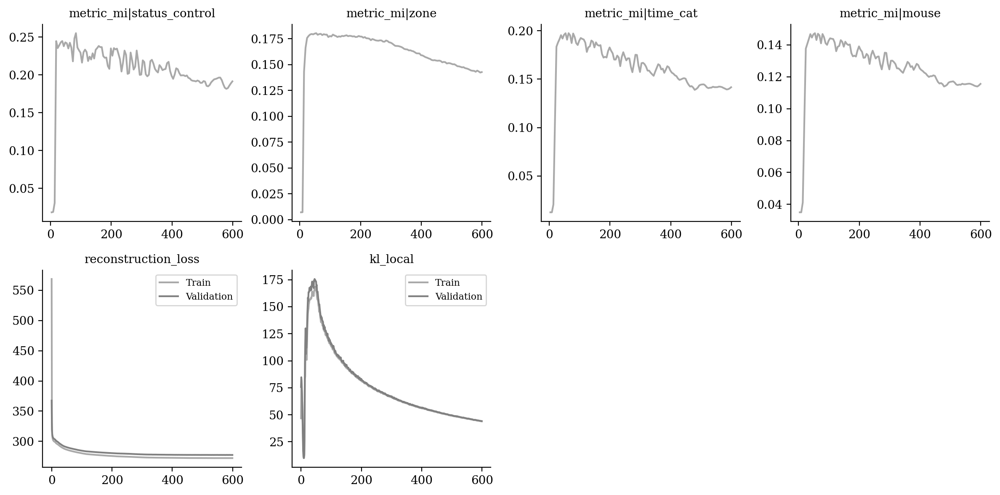

In [15]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [16]:
from tardis._disentanglementmanager import DisentanglementManager as DM

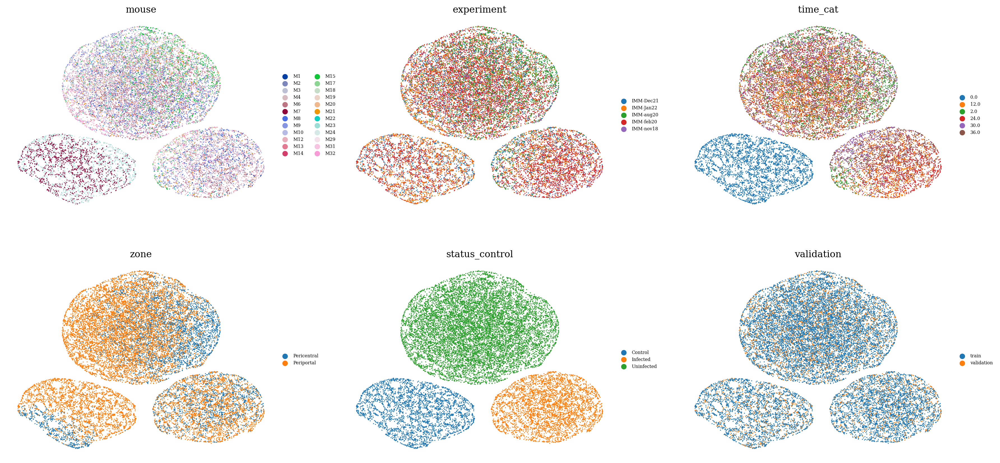

In [17]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

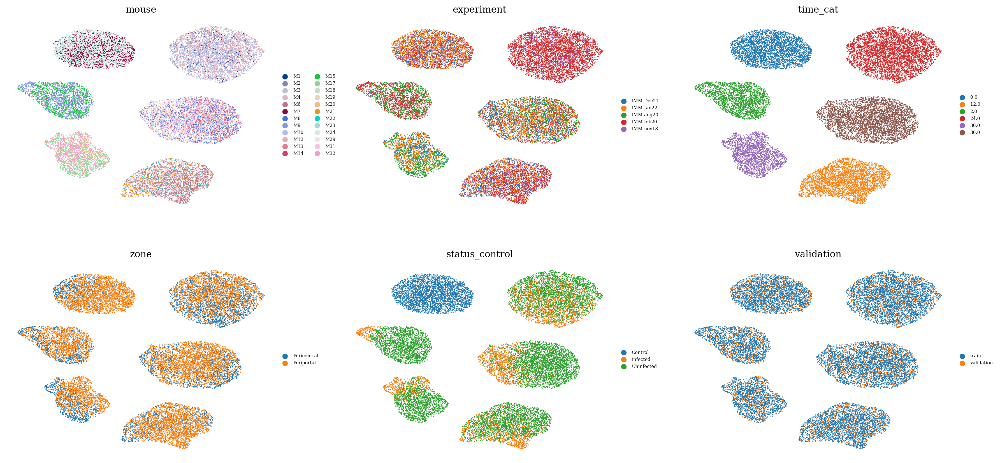

In [18]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

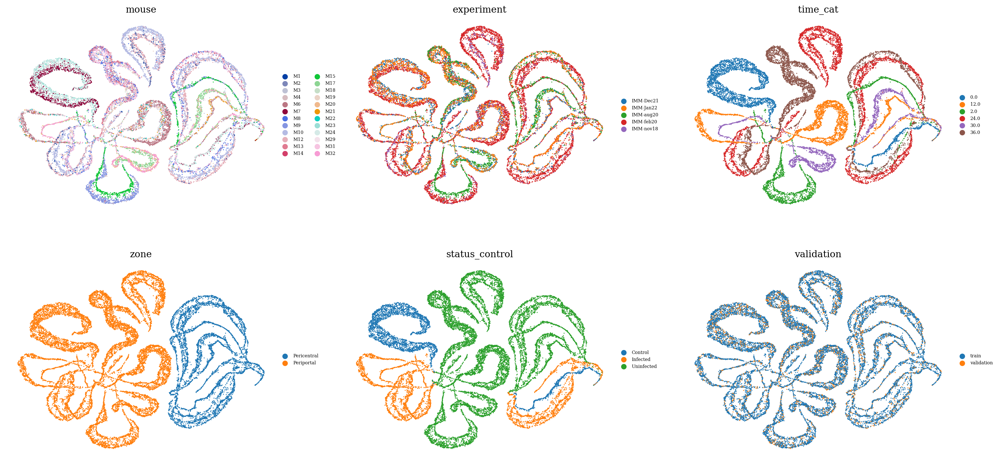

In [19]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

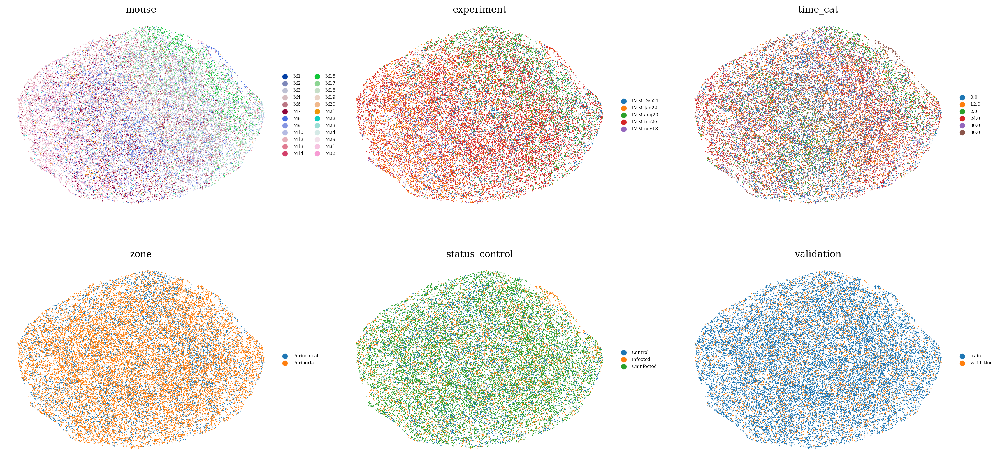

In [20]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

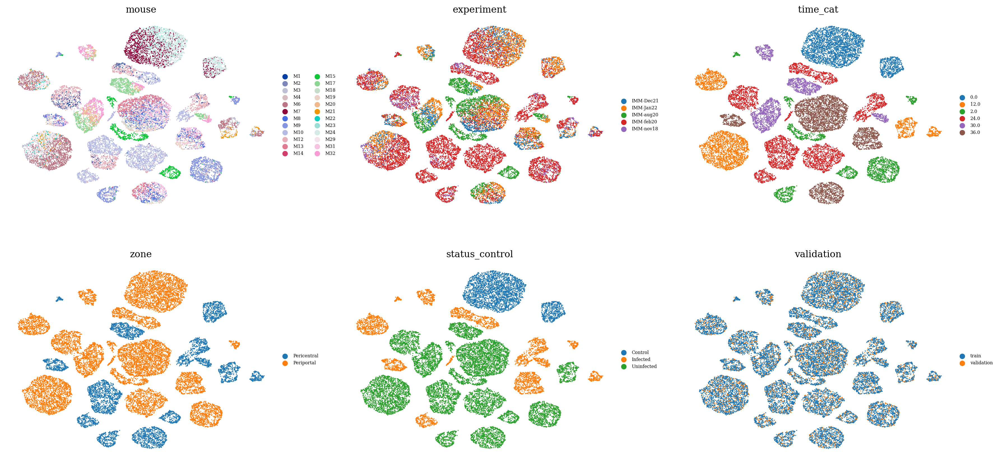

In [21]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [22]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data, factors=factors, variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.8835556940091441

In [23]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data[vae.validation_indices, :], factors=factors[vae.validation_indices, :], variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.8274700865194154

In [24]:
vae.get_MI_normalized_training("zone")

{('validation', 'reserved'): 0.9974122189092776,
 ('validation', 'unreserved'): 0.11856466057814834,
 ('train', 'reserved'): 0.9956228654270374,
 ('train', 'unreserved'): 0.06967451743438303}

In [25]:
vae.get_MI_normalized_training("status_control")

{('validation', 'reserved'): 0.9950242863268115,
 ('validation', 'unreserved'): 0.23479927872807344,
 ('train', 'reserved'): 0.9955817096901912,
 ('train', 'unreserved'): 0.17965696318872856}

In [26]:
vae.get_MI_normalized_training("time_cat")

{('validation', 'reserved'): 0.9586805985028399,
 ('validation', 'unreserved'): 0.1965928110291515,
 ('train', 'reserved'): 0.9558332609652747,
 ('train', 'unreserved'): 0.1197367774227994}